In [1]:
import pandas as pd
import scipy as sc
import numpy as np
from numpy import mean
from numpy import std
from math import ceil
from datetime import datetime
import calendar
import os
from scipy.stats import spearmanr
from io import StringIO

from itertools import product
from itertools import product

from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder

from sklearn.feature_selection import RFE
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.feature_selection import mutual_info_classif

from sklearn import datasets
from sklearn.datasets import make_classification
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier 
from sklearn import tree
from sklearn.tree import export_graphviz
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.svm import SVC

from sklearn import metrics
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import roc_curve
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold

from matplotlib import pyplot
from matplotlib import pyplot as plt
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
from IPython.display import Image  
import pydotplus

from imblearn.pipeline import Pipeline
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

from imblearn.over_sampling import RandomOverSampler
from imblearn.pipeline import Pipeline
from collections import Counter


%matplotlib inline
%config InlineBackend.figure_format = 'retina'
sns.set()

#from sklearn.externals.six import StringIO 

In [2]:
#in anaconda prompt: conda install python-graphviz
!pip install pydotplus
from sklearn.tree import export_graphviz
import graphviz
import pydotplus

def plot_tree(model):
    dot_data = export_graphviz(model,
                               feature_names=X_train.columns,  
                               class_names=["No Diabetes", "Diabetes"],
                               filled=True)
    pydot_graph = pydotplus.graph_from_dot_data(dot_data)
    pydot_graph.set_size('"20,20"')
    return graphviz.Source(pydot_graph.to_string())

You should consider upgrading via the 'C:\Users\marta\anaconda3\python.exe -m pip install --upgrade pip' command.


# Import Train and Test Data

In [3]:
#import data bases, train and test provided for the analysis
#set 'CITIZEN_ID' column as index because they are unique identifiers of each observation
newland_train = pd.read_excel('Train.xlsx', index_col='CITIZEN_ID')
newland_test = pd.read_excel('Test.xlsx', index_col='CITIZEN_ID')

# Exploration Train Data

In [4]:
#check for empty values and data type for each variable
newland_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22400 entries, 12486 to 34885
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   Name                    22400 non-null  object
 1   Birthday                22400 non-null  object
 2   Native Continent        22400 non-null  object
 3   Marital Status          22400 non-null  object
 4   Lives with              22400 non-null  object
 5   Base Area               22400 non-null  object
 6   Education Level         22400 non-null  object
 7   Years of Education      22400 non-null  int64 
 8   Employment Sector       22400 non-null  object
 9   Role                    22400 non-null  object
 10  Working Hours per week  22400 non-null  int64 
 11  Money Received          22400 non-null  int64 
 12  Ticket Price            22400 non-null  int64 
 13  Income                  22400 non-null  int64 
dtypes: int64(5), object(9)
memory usage: 2.6+ MB


In [5]:
#check firts observations to verify that the data base imported correctly
newland_train.head() 

,Name,Birthday,Native Continent,Marital Status,Lives with,Base Area,Education Level,Years of Education,Employment Sector,Role,Working Hours per week,Money Received,Ticket Price,Income
CITIZEN_ID,,,,,,,,,,,,,,
12486,Mr. Adam Glover,"July 1,2003",Europe,Married,Wife,Northbury,High School + PostGraduation,13,Private Sector - Services,Repair & constructions,40,0,2273,1
12487,Mr. Cameron McDonald,"January 25,2006",Europe,Married,Wife,Northbury,Professional School,12,Public Sector - Others,Repair & constructions,40,0,0,1
12488,Mr. Keith Davidson,"May 10,2009",Europe,Married,Wife,Northbury,Professional School,12,Private Sector - Services,Sales,46,0,2321,1
12489,Mr. Alexander Gill,"March 25,1985",Europe,Married,Wife,Northbury,High School - 2nd Cycle,11,Private Sector - Services,Security,37,5395,0,1
12490,Mr. Neil Piper,"May 29,2015",Europe,Single,Other Family,Northbury,PhD,21,Self-Employed (Individual),Professor,45,0,0,1


In [6]:
#check basic descriptive statistics for each variable, including categorical ones
newland_train.describe(include = 'all')

,Name,Birthday,Native Continent,Marital Status,Lives with,Base Area,Education Level,Years of Education,Employment Sector,Role,Working Hours per week,Money Received,Ticket Price,Income
count,22400,22400,22400,22400,22400,22400,22400,22400.000000,22400,22400,22400.000000,22400.000000,22400.000000,22400.000000
unique,16074,11257,5,7,6,40,16,NaN,9,15,NaN,NaN,NaN,NaN
top,Mr. Ryan Grant,"August 15,2025",Europe,Married,Wife,Northbury,Professional School,NaN,Private Sector - Services,Professor,NaN,NaN,NaN,NaN
freq,4,9,19111,10219,9012,20074,7232,NaN,15599,2849,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.173884,NaN,NaN,40.483795,1324.915357,109.145313,0.237098
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.512451,NaN,NaN,12.370921,9227.771813,500.208904,0.425313
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,NaN,NaN,1.000000,0.000000,0.000000,0.000000
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.000000,NaN,NaN,40.000000,0.000000,0.000000,0.000000
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.000000,NaN,NaN,40.000000,0.000000,0.000000,0.000000
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.000000,NaN,NaN,45.000000,0.000000,0.000000,0.000000


# Exploration Test Data

In [7]:
#check for empty values and data type for each variable
newland_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10100 entries, 34886 to 44985
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   Name                    10100 non-null  object
 1   Birthday                10100 non-null  object
 2   Native Continent        10100 non-null  object
 3   Marital Status          10100 non-null  object
 4   Lives with              10100 non-null  object
 5   Base Area               10100 non-null  object
 6   Education Level         10100 non-null  object
 7   Years of Education      10100 non-null  int64 
 8   Employment Sector       10100 non-null  object
 9   Role                    10100 non-null  object
 10  Working Hours per week  10100 non-null  int64 
 11  Money Received          10100 non-null  int64 
 12  Ticket Price            10100 non-null  int64 
dtypes: int64(4), object(9)
memory usage: 1.1+ MB


In [8]:
#check firts observations to verify that the data base imported correctly
newland_test.head()

,Name,Birthday,Native Continent,Marital Status,Lives with,Base Area,Education Level,Years of Education,Employment Sector,Role,Working Hours per week,Money Received,Ticket Price
CITIZEN_ID,,,,,,,,,,,,,
34886,Mr. Dan Kerr,"May 13,2012",Europe,Married,Wife,Northbury,Bachelors + PostGraduation,16,Private Sector - Services,Sales,40,0,0
34887,Miss Olivia Grant,"August 9,2014",Europe,Single,Other Family,Northbury,Bachelors + PostGraduation,16,Private Sector - Services,Professor,36,0,0
34888,Mr. Trevor Simpson,"May 23,2020",Europe,Divorced,Other Family,Northbury,Professional School + PostGraduation,13,Private Sector - Services,Management,50,12940,0
34889,Mr. David Clark,"April 15,2016",Europe,Married,Wife,Northbury,Professional School,12,Private Sector - Services,Professor,48,0,1827
34890,Mr. Gavin Lambert,"April 22,2011",Europe,Married,Wife,Watford,Bachelors,15,Public Sector - Others,Professor,45,0,0


In [9]:
#check basic descriptive statistics for each variable, including categorical ones
newland_test.describe(include = 'all')

,Name,Birthday,Native Continent,Marital Status,Lives with,Base Area,Education Level,Years of Education,Employment Sector,Role,Working Hours per week,Money Received,Ticket Price
count,10100,10100,10100,10100,10100,10100,10100,10100.000000,10100,10100,10100.000000,10100.000000,10100.000000
unique,8964,7222,5,7,6,38,16,NaN,8,15,NaN,NaN,NaN
top,Mr. Sam Springer,"June 6,2005",Europe,Married,Wife,Northbury,Professional School,NaN,Private Sector - Services,Repair & constructions,NaN,NaN,NaN
freq,3,6,8651,4731,4159,9055,3251,NaN,7052,1292,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.158020,NaN,NaN,40.319406,1331.184257,102.986238
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.490656,NaN,NaN,12.276067,8782.255770,484.303733
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,NaN,NaN,1.000000,0.000000,0.000000
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.000000,NaN,NaN,40.000000,0.000000,0.000000
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.000000,NaN,NaN,40.000000,0.000000,0.000000
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.000000,NaN,NaN,45.000000,0.000000,0.000000


# Feature Engineering

In [10]:
#Create variable 'Group' using 'Money received' and 'Ticket price' variables 
#to determine if the observations belong to group A, B or C depending on how they were selected for joining the mission

### Train ###
newland_train.loc[(newland_train['Money Received'] == 0) & (newland_train['Ticket Price'] == 0), 'Group'] = 'A'
newland_train.loc[(newland_train['Money Received'] > 0) & (newland_train['Ticket Price'] == 0), 'Group'] = 'B'
newland_train.loc[(newland_train['Money Received'] == 0) & (newland_train['Ticket Price'] > 0), 'Group'] = 'C'

### Test ###
newland_test.loc[(newland_test['Money Received'] == 0) & (newland_test['Ticket Price'] == 0), 'Group'] = 'A'
newland_test.loc[(newland_test['Money Received'] > 0) & (newland_test['Ticket Price'] == 0), 'Group'] = 'B'
newland_test.loc[(newland_test['Money Received'] == 0) & (newland_test['Ticket Price'] > 0), 'Group'] = 'C'

In [11]:
#Calculate the variable 'Age' extracting the birth year from 'Birthday' and using 2046 (year of the mission) as the actual year
#The extact age will not be calculated since we only have '2046' as today's date

### Train ###
newland_train["Birth_year"] = newland_train["Birthday"].str.split(',', expand=True)[1]
newland_train["Birth_year"] = newland_train["Birth_year"].astype(int)
newland_train["Age"] = 2046 - newland_train["Birth_year"]

### Test ####
newland_test["Birth_year"] = newland_test["Birthday"].str.split(',', expand=True)[1]
newland_test["Birth_year"] = newland_test["Birth_year"].astype(int)
newland_test["Age"] = 2046 - newland_test["Birth_year"]

In [12]:
#Create variable 'Gender' extracting the title of each citizen that was within their name variable

### Train ###
newland_train['Gender'] = np.where(newland_train['Name'].str.contains("Mr"), "Male", "Female")

### Test ###
newland_test['Gender'] = np.where(newland_test['Name'].str.contains("Mr"), "Male", "Female")

In [13]:
#Transform categorical variables into category dtype

### Train ###
newland_train['Gender'] = newland_train['Gender'].astype('category')
newland_train['Native Continent'] = newland_train['Native Continent'].astype('category')
newland_train['Marital Status'] = newland_train['Marital Status'].astype('category')
newland_train['Lives with'] = newland_train['Lives with'].astype('category')
newland_train['Base Area'] = newland_train['Base Area'].astype('category')
newland_train['Employment Sector'] = newland_train['Employment Sector'].astype('category')
newland_train['Role'] = newland_train['Role'].astype('category')
newland_train['Group'] = newland_train['Group'].astype('category')
newland_train['Income'] = newland_train['Income'].astype('category')

### Test ###
newland_test['Gender'] = newland_test['Gender'].astype('category')
newland_test['Native Continent'] = newland_test['Native Continent'].astype('category')
newland_test['Marital Status'] = newland_test['Marital Status'].astype('category')
newland_test['Lives with'] = newland_test['Lives with'].astype('category')
newland_test['Base Area'] = newland_test['Base Area'].astype('category')
newland_test['Employment Sector'] = newland_test['Employment Sector'].astype('category')
newland_test['Role'] = newland_test['Role'].astype('category')
newland_test['Group'] = newland_test['Group'].astype('category')

# Feature selection: Relevancy

In [14]:
#Removed the columns we used to create new variables to avoid repetition 

### Train ###
newland_train.drop(columns=['Birthday', 'Name', 'Birth_year'], inplace=True)

### Test ####
newland_test.drop(columns=['Birthday', 'Name', 'Birth_year'], inplace=True)

# Define Metric and Non-metric features

In [15]:
#Create DataFrames and lists to split metric and non metric features

metric_features = newland_train[['Years of Education', 'Working Hours per week', 'Age', 'Money Received','Ticket Price']]
non_metric_features = newland_train.drop(metric_features,axis=1)

metric_features_list = metric_features.columns.tolist()
non_metric_features_list = non_metric_features.columns.tolist()

In [16]:
#reorder columns so categorical variables are all together at the beginning and continuous ones at the end

### Train ###
newland_train = newland_train[non_metric_features_list + metric_features_list]

### Test ###
newland_test = newland_test[['Native Continent', 'Marital Status', 'Lives with', 'Base Area', 'Education Level', 'Employment Sector', 'Role', 'Group', 'Gender'] + metric_features_list]

# Data Visualization


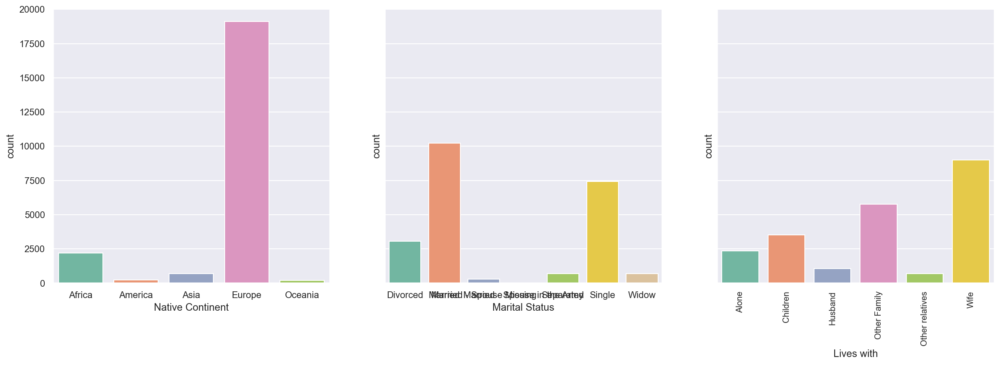

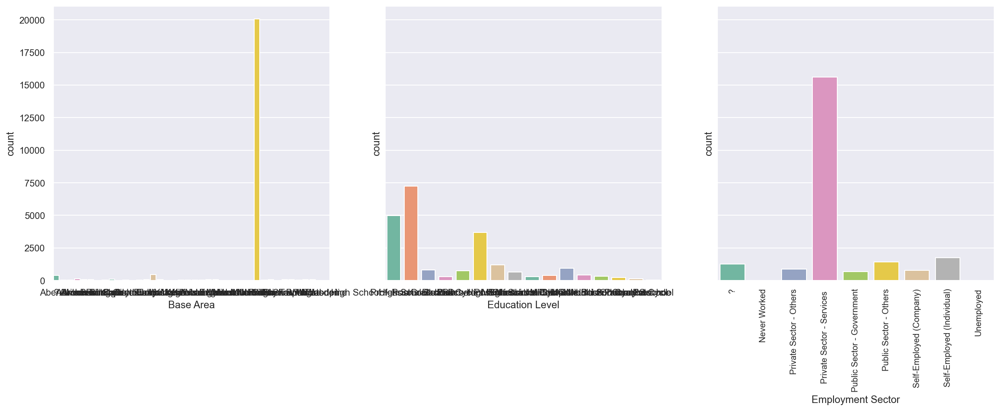

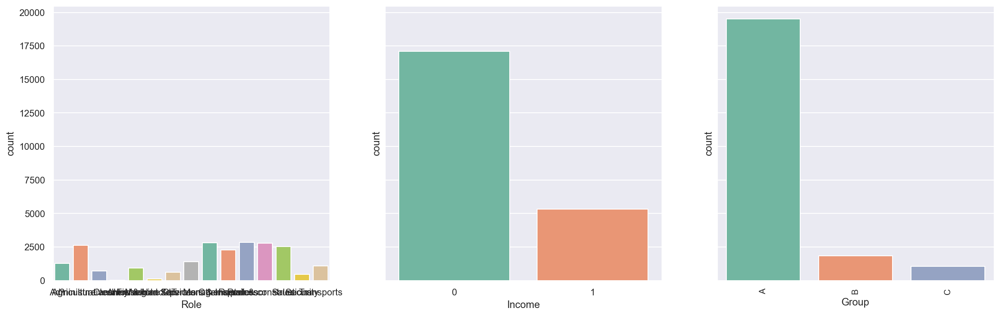

In [17]:
#Futher explore (with visualization) the current data set to determine if other features can be droped or modified 

#Create count plots for categorical features in a 3x3 grid

#define shape of grid
n_cols = 3
n_rows = 3

#use a for loop to create the subplots for each categorical variable 
for i in range(n_rows):
    fg,ax = plt.subplots(nrows=1,ncols=n_cols,sharey=True,figsize=(20, 6))
    
    for j in range(n_cols):
        sns.countplot(x=non_metric_features.columns.tolist()[i*n_cols+j], data=non_metric_features, ax=ax[j], palette="Set2")
        plt.xticks(fontsize=10, rotation=90)

In [18]:
#Define the function to build crosstabs to check the proportion of the targets in each categorical variable

def bar_charts_categorical(feature, target='Income', df=newland_train):
    
    cont_tab = pd.crosstab(df[feature], df[target], margins = True)
    categories = cont_tab.index[:-1]
    
    fig = plt.figure(figsize=(15, 6))
  
    obs_pct = np.array([np.divide(cont_tab.iloc[:-1, 0].values, cont_tab.iloc[:-1, 2].values), 
                        np.divide(cont_tab.iloc[:-1, 1].values, cont_tab.iloc[:-1, 2].values)])
      
    plt.subplot(122)
    p1 = plt.bar(categories, obs_pct[0], 0.55, color="gray")
    p2 = plt.bar(categories, obs_pct[1], 0.55, bottom=obs_pct[0], color="yellowgreen")
    plt.legend((p2[0], p1[0]), ('$y_i=1$', '$y_i=0$'))
    plt.title("Income differences per {}".format(feature))
    plt.xlabel(feature)
    plt.ylabel("$p$")
    plt.xticks(fontsize=10, rotation=90)

    plt.show()

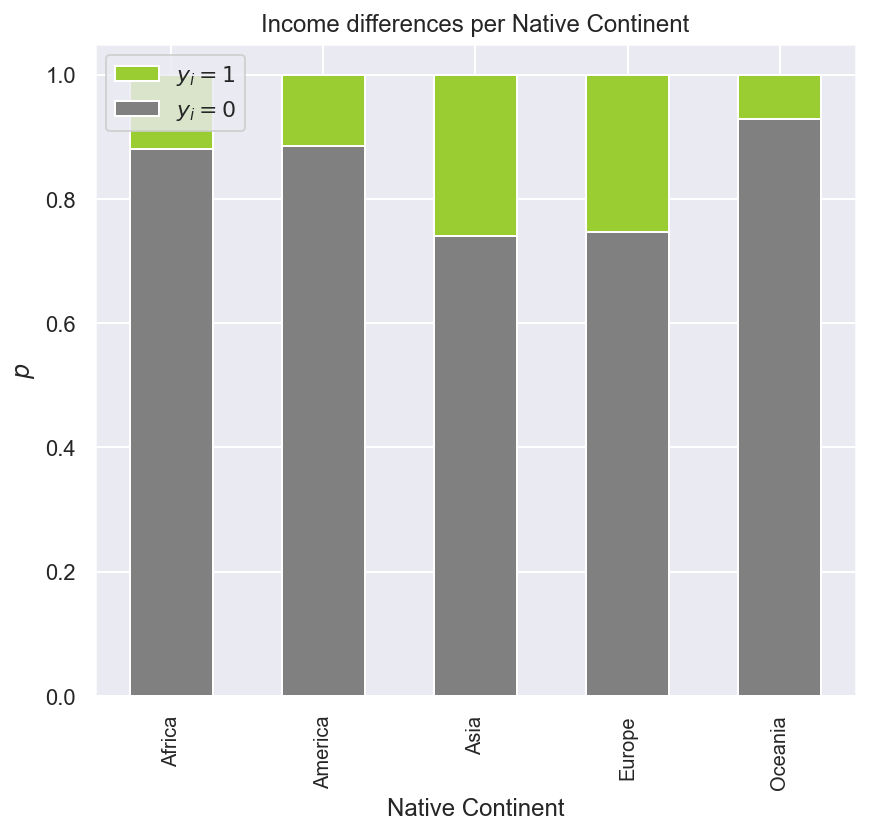

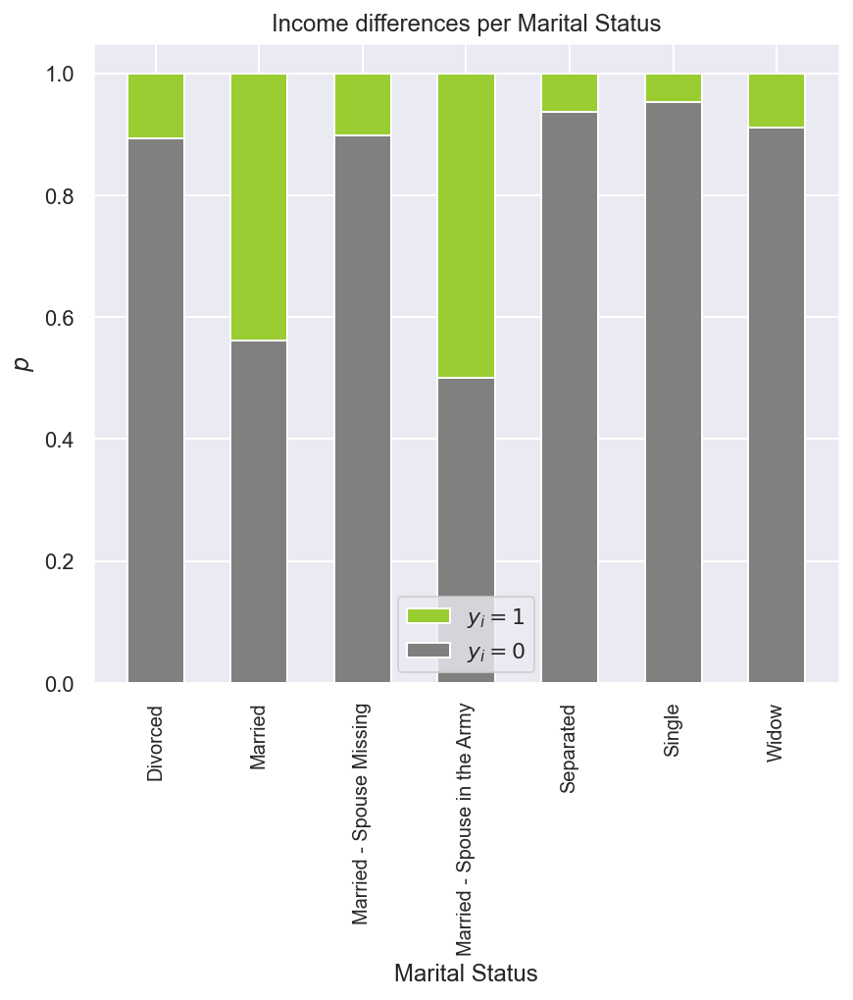

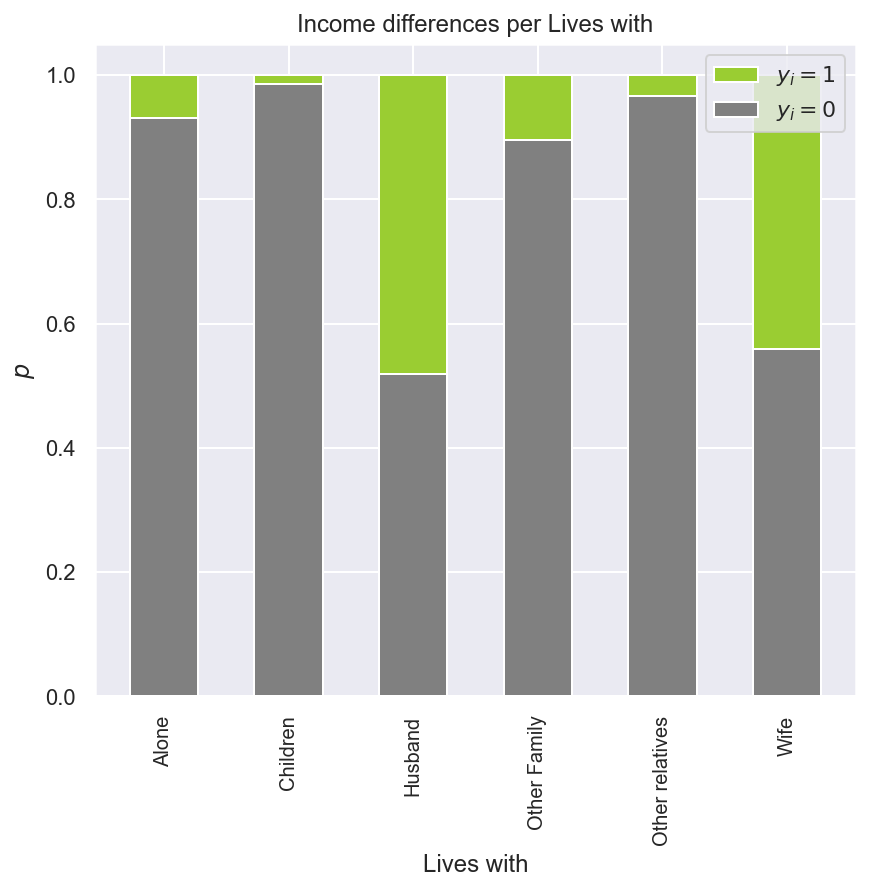

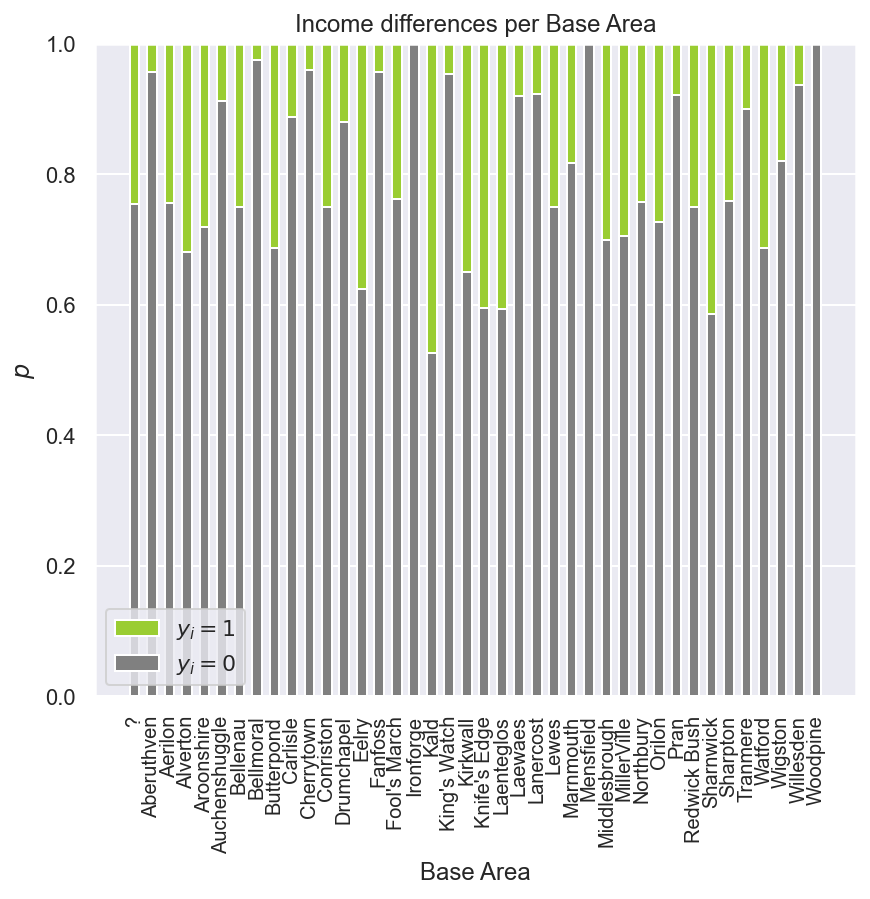

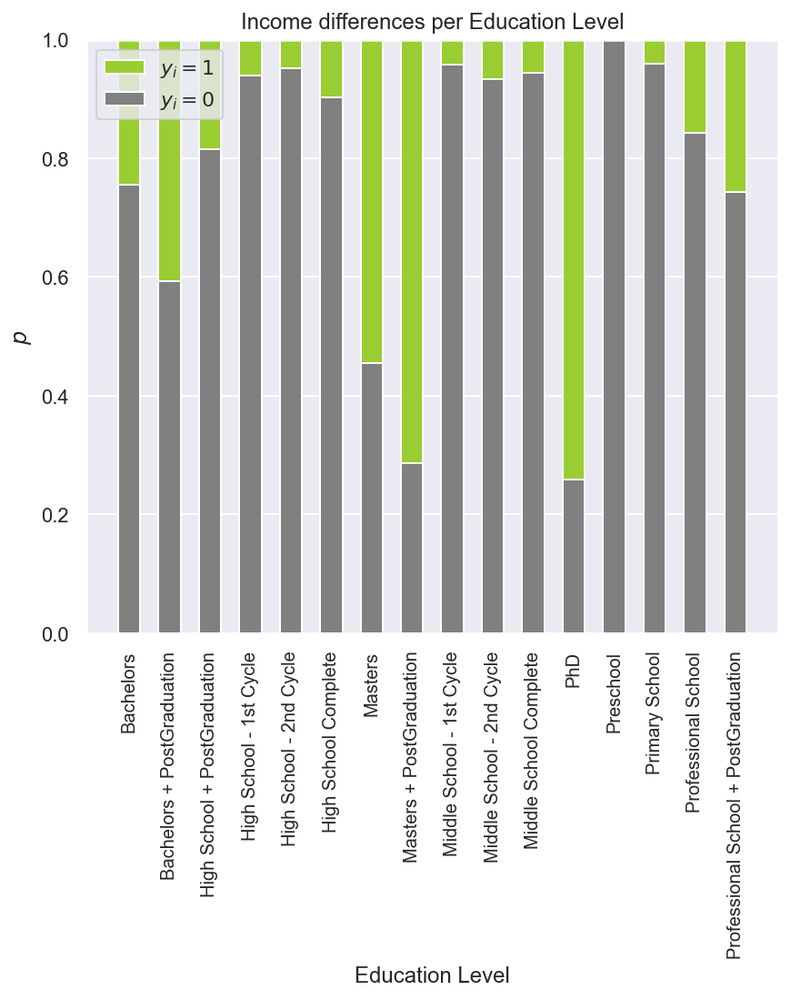

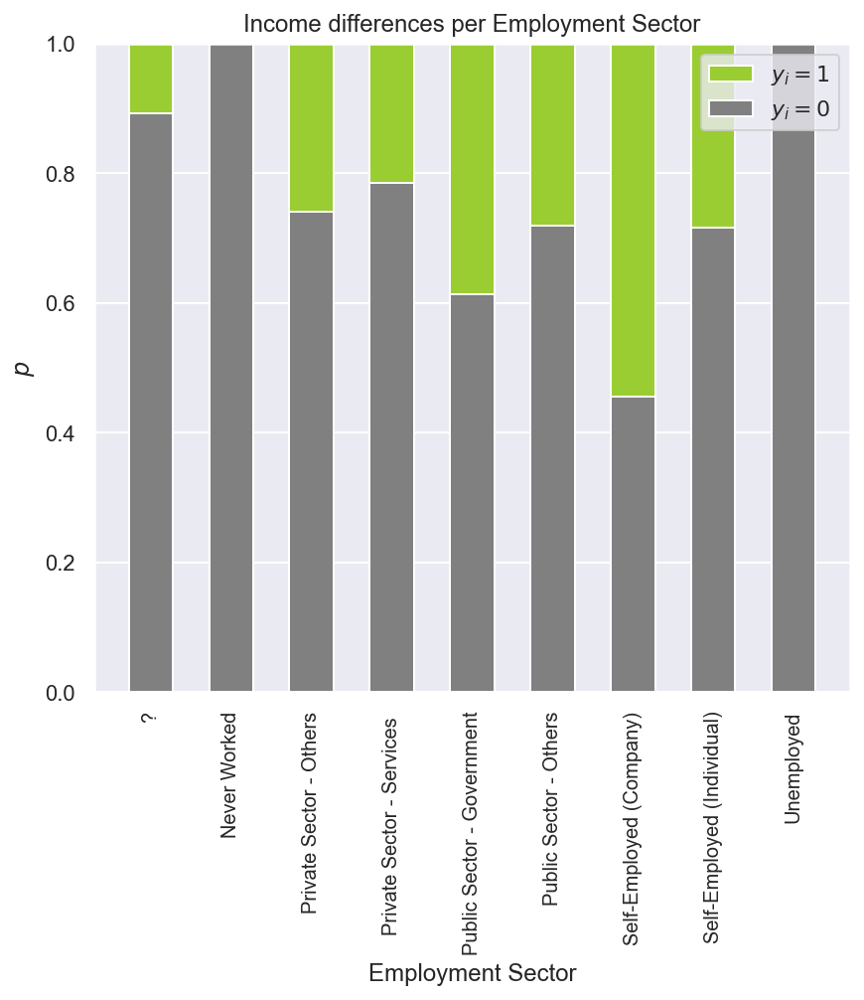

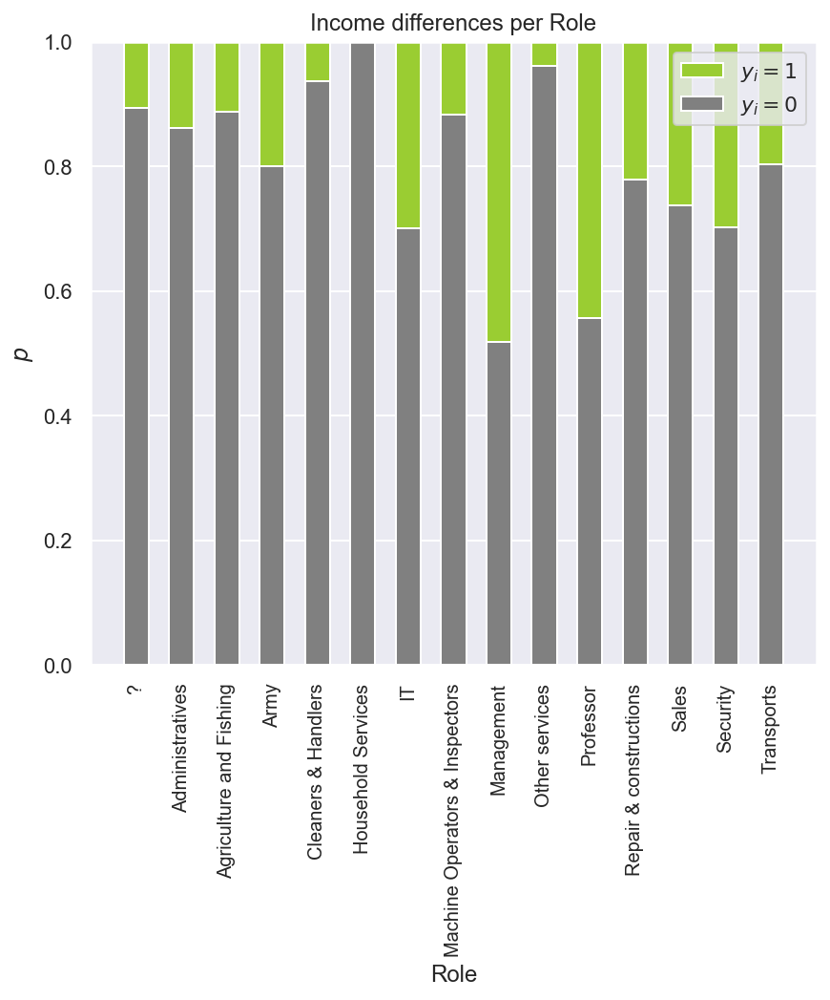

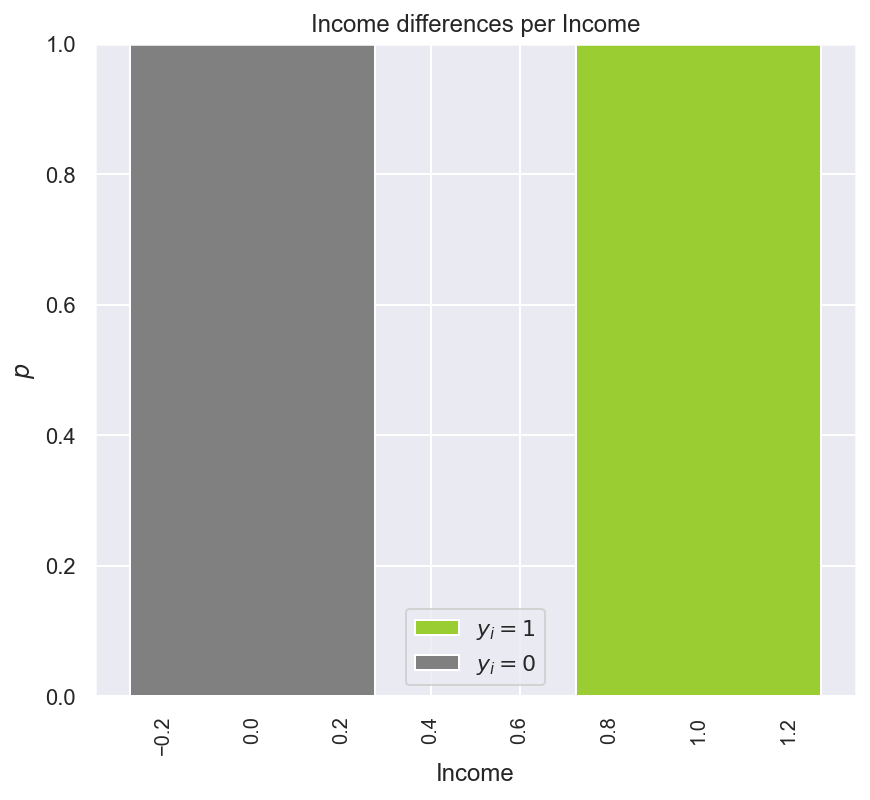

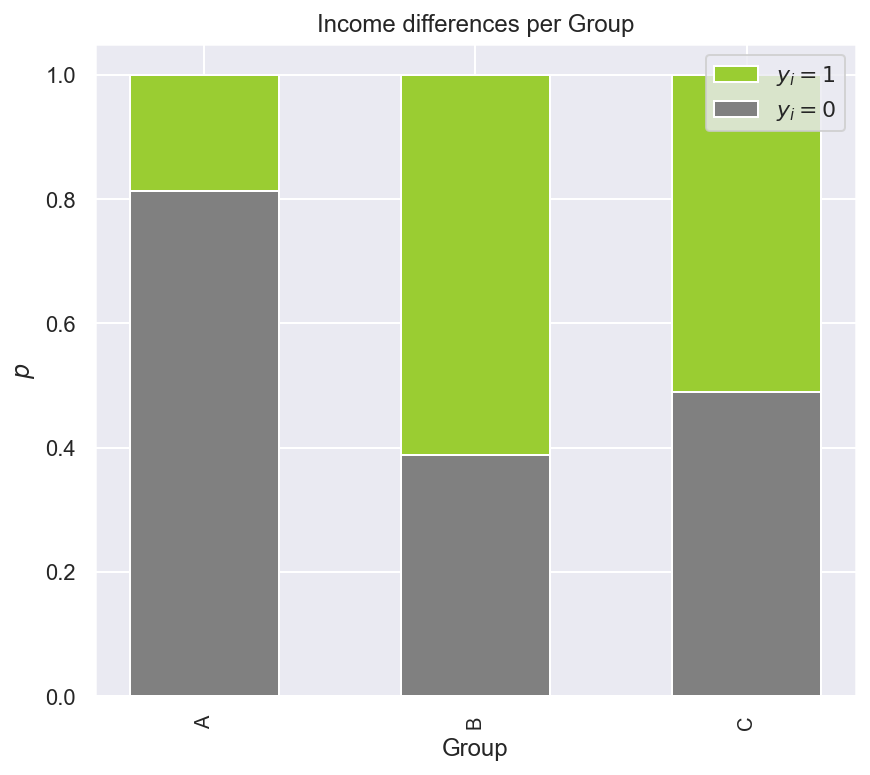

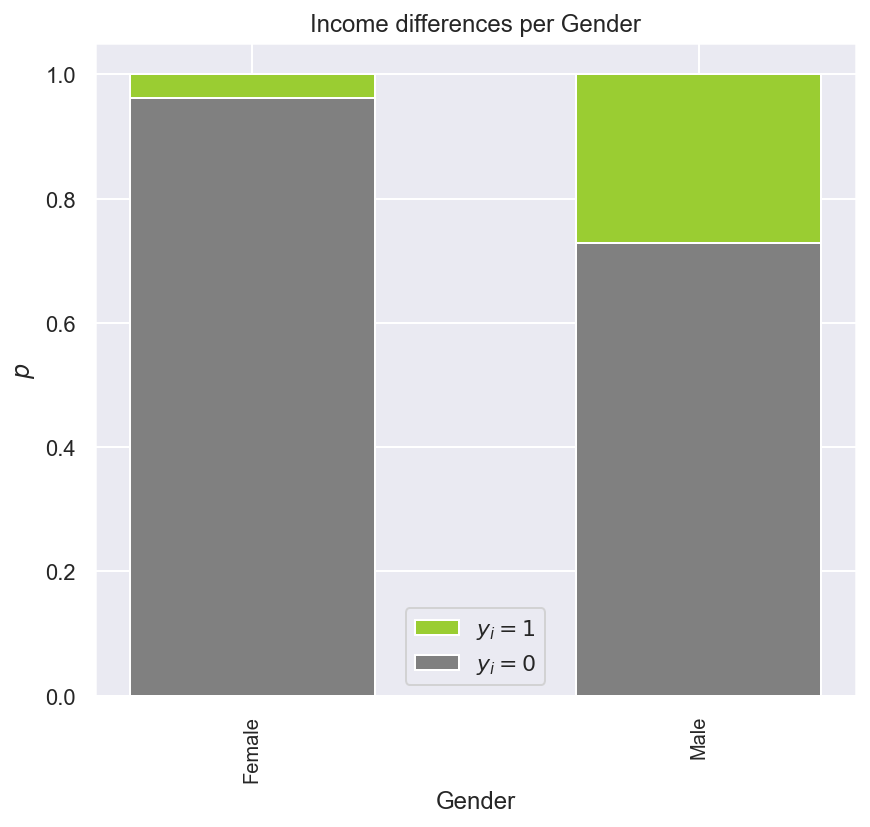

In [19]:
#Use a for loop to print a chart for each feature using the aforementioned formula

for feature in non_metric_features_list:
    bar_charts_categorical(feature)

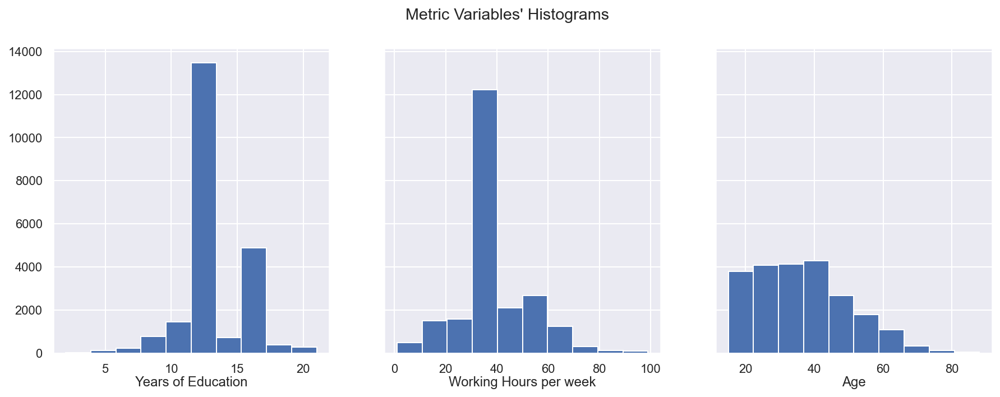

In [20]:
#Create a grid with the histograms of each numeric variables
sns.set()

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(1, 3, sharey=True, figsize=(15, 5))

# Iterate across axes objects and associate each histogram 
for ax, feat in zip(axes.flatten(), metric_features_list): 
    ax.hist(metric_features[feat])
    ax.set_title(feat, y=-0.13)
    
plt.suptitle("Metric Variables' Histograms")

plt.show()

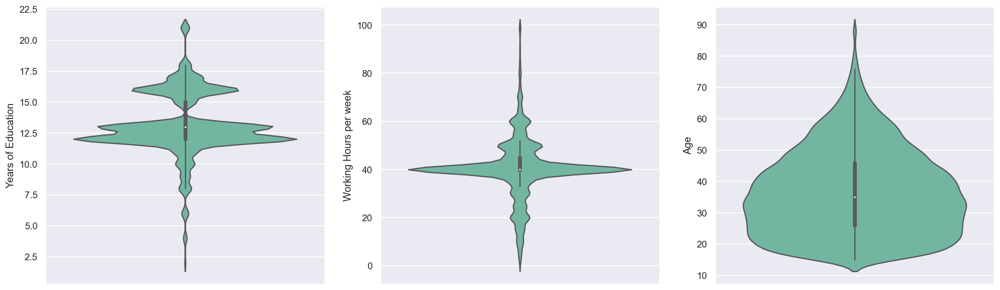

In [21]:
#We will visualize all the continuous variables using Violin Plots (a combination of box and density plots)

#get the names of all the continous columns 
cols = metric_features.columns

#Plot violin for all attributes in a 2x2 grid
n_cols = 3
n_rows = 1

for i in range(n_rows):
    fg,ax = plt.subplots(nrows=1,ncols=n_cols,figsize=(20, 6))
    for j in range(n_cols):
        sns.violinplot(y=cols[i*n_cols+j], data=newland_train, ax=ax[j], palette="Set2")

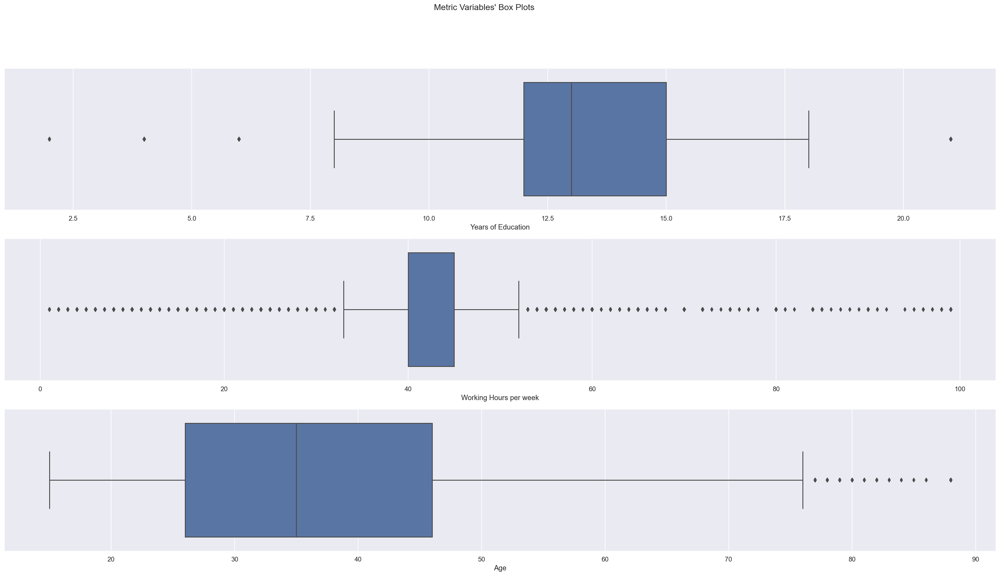

In [22]:
##Create a grid with the box plots of each numeric variable
sns.set()

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(3, 1, figsize=(30, 15))

# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(),metric_features_list): # Notice the zip() function and flatten() method
    sns.boxplot(x=metric_features[feat], ax=ax)
    
plt.suptitle("Metric Variables' Box Plots")

plt.show()

# Feature Engineering After Visualization

## Train Dataset

In [23]:
#Given the visualization we decided to regroup some values in 'Base Area', 'Employment Sector' and Marital Status' features

#Reclassify the observations of 'Base Area' into only two values: Northbury and Others 
#because 91% of the observations belong to Northbury

other_base_area = newland_train['Base Area'].unique().tolist()
other_base_area.remove('Northbury')
other = ['Other']*39
newland_train['Base Area'].replace(other_base_area, other, inplace = True)

In [24]:
#Check that the reclassification was performed correctly 
newland_train['Base Area'].value_counts()

Northbury    20074
Other         2326
Name: Base Area, dtype: int64

In [25]:
#Reclassify the observations in 'Employment Sector' according to their type of activity: 
#'Private Sector', 'Self-Employed', 'Public Sector', 'Unemployed'

newland_train['Employment Sector'].replace({"Private Sector - Services ":"Private Sector", 
                                            "Self-Employed (Individual)":"Self-Employed", 
                                            "Public Sector - Others":"Public Sector",
                                            "Private Sector - Others":"Private Sector", 
                                            "Self-Employed (Company)":"Self-Employed", 
                                            'Public Sector - Government':'Public Sector', 
                                            'Never Worked':'Unemployed'}, inplace = True)

In [26]:
#Check that the reclassification was performed correctly 
newland_train['Employment Sector'].value_counts()

Private Sector    16479
Self-Employed      2527
Public Sector      2111
?                  1264
Unemployed           19
Name: Employment Sector, dtype: int64

In [27]:
#Assign 'Married' to all observations that had 'Married -(subcategory)' in 'Marital Status' feature 

newland_train['Marital Status'].replace({'Married - Spouse Missing': 'Married', 
                                         'Married - Spouse in the Army':'Married'}, inplace = True)

In [28]:
#Check that the reclassification was performed correctly 
newland_train['Marital Status'].value_counts()

Married      10517
Single        7416
Divorced      3072
Separated      699
Widow          696
Name: Marital Status, dtype: int64

## Test Database

In [29]:
#Given the visualization we decided to regroup some values in 'Base Area', 'Employment Sector' and Marital Status' features

#Reclassify the observations of 'Base Area' into only two values: Northbury and Others 
#because 91% of the observations belong to Northbury

other_base_area = newland_test['Base Area'].unique().tolist()
other_base_area.remove('Northbury')
other = ['Other']*37
newland_test['Base Area'].replace(other_base_area, other, inplace = True)

In [30]:
#Check that the reclassification was performed correctly 
newland_test['Base Area'].value_counts()

Northbury    9055
Other        1045
Name: Base Area, dtype: int64

In [31]:
#Reclassify the observations in 'Employment Sector' according to their type of activity: 
#'Private Sector', 'Self-Employed', 'Public Sector', 'Unemployed'

newland_test['Employment Sector'].replace({"Private Sector - Services ":"Private Sector", 
                                            "Self-Employed (Individual)":"Self-Employed", 
                                            "Public Sector - Others":"Public Sector",
                                            "Private Sector - Others":"Private Sector", 
                                            "Self-Employed (Company)":"Self-Employed", 
                                            'Public Sector - Government':'Public Sector', 
                                            'Never Worked':'Unemployed'}, inplace = True)

In [32]:
#Check that the reclassification was performed correctly 
newland_test['Employment Sector'].value_counts()

Private Sector    7469
Self-Employed     1121
Public Sector      938
?                  570
Unemployed           2
Name: Employment Sector, dtype: int64

In [33]:
#Assign 'Married' to all observations that had 'Married -(subcategory)' in 'Marital Status' feature 

newland_test['Marital Status'].replace({'Married - Spouse Missing': 'Married', 
                                         'Married - Spouse in the Army':'Married'}, inplace = True)

In [34]:
#Check that the reclassification was performed correctly 
newland_test['Marital Status'].value_counts()

Married      4872
Single       3249
Divorced     1359
Separated     325
Widow         295
Name: Marital Status, dtype: int64

# Outlier Removal

## Train Database

### Outlier removal manually

In [35]:
#Given the results of the box plots, define limits to filter out the outliers for the numerical variables
#Taking into account that the standard working schedule (hours per week) is 50 hours, and part time is 30, we decided on a range
#from 15 to 70. This way, all casual workers and overtimers would also be considered.

filters1 = (
    (newland_train['Age']<=87)
    &
    (newland_train['Working Hours per week']<=70)
    &
    (newland_train['Working Hours per week']>=15)
    &
    (newland_train['Years of Education']<=20)
    &
    (newland_train['Years of Education']>=7)
)

newland_train_1 = newland_train[filters1]
print('Percentage of data kept after removing outliers:', np.round(newland_train_1.shape[0] / newland_train.shape[0], 4))

Percentage of data kept after removing outliers: 0.9247


### Outlier removal using IQR method

In [36]:
#Difine IQR and filter the information accordingly

q25 = newland_train.quantile(.25)
q75 = newland_train.quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 3 * iqr
lower_lim = q25 - 3 * iqr

filters2 = []
for metric in metric_features_list:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters2.append(newland_train[metric].between(llim, ulim, inclusive=True))

filters2 = pd.Series(np.all(filters2, 0), index=newland_train.index.tolist())   
newland_train_2 = newland_train[filters2]

print('Percentage of data kept after removing outliers:', np.round(newland_train_2.shape[0] / newland_train.shape[0], 4))

Percentage of data kept after removing outliers: 0.7492


### Combining outlier methods

In [37]:
newland_train_3 = newland_train[(filters1 | filters2)]
print('Percentage of data kept after removing outliers:', np.round(newland_train_3.shape[0] / newland_train.shape[0], 4))

Percentage of data kept after removing outliers: 0.9453


## Test Database

## Outlier removal manually

In [38]:
#Given the results of the box plots, define limits to filter out the outliers for the numerical variables
#Taking into account that the standard working schedule (hours per week) is 50 hours, and part time is 30, we decided on a range
#from 15 to 70. This way, all casual workers and overtimers would also be considered.

filters1 = (
    (newland_test['Age']<=87)
    &
    (newland_test['Working Hours per week']<=70)
    &
    (newland_test['Working Hours per week']>=15)
    &
    (newland_test['Years of Education']<=20)
    &
    (newland_test['Years of Education']>=7)
)

newland_test_1 = newland_test[filters1]
print('Percentage of data kept after removing outliers:', np.round(newland_test_1.shape[0] / newland_test.shape[0], 4))

Percentage of data kept after removing outliers: 0.9279


## Outlier removal using IQR method

In [39]:
#Difine IQR and filter the information accordingly

q25 = newland_test.quantile(.25)
q75 = newland_test.quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 3 * iqr
lower_lim = q25 - 3 * iqr

filters2 = []
for metric in metric_features:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters2.append(newland_test[metric].between(llim, ulim, inclusive=True))

filters2 = pd.Series(np.all(filters2, 0), index=newland_test.index.tolist())   
newland_test_2 = newland_test[filters2]

print('Percentage of data kept after removing outliers:', np.round(newland_test_2.shape[0] / newland_test.shape[0], 4))

Percentage of data kept after removing outliers: 0.7485


## Combining outlier methods

In [40]:
newland_test_3 = newland_test[(filters1 | filters2)]
print('Percentage of data kept after removing outliers:', np.round(newland_test_3.shape[0] / newland_test.shape[0], 4))

Percentage of data kept after removing outliers: 0.948


# Fill Missing Values

## Train Database

In [41]:
#Since only two variables had empty values, and they represented less than 6% of the observations, we decided to fill these
#missing values with their respective modes. 
#Before filling missing values we replaced the "?" with a NaN. 

newland_train["Role"].replace({"?":np.nan}, inplace=True)
newland_train["Employment Sector"].replace({"?":np.nan}, inplace=True)

In [42]:
#Check if the "?" were replaced by NaN properly
newland_train[["Role", "Employment Sector"]].isna().any()

Role                 True
Employment Sector    True
dtype: bool

In [43]:
# Find the mode for each variable and then fill the NaNs in each column.
modes = newland_train[["Role", "Employment Sector"]].mode().loc[0]
newland_train.fillna(modes, inplace=True)

In [44]:
#Check if the missing values were filled properly
newland_train[["Role", "Employment Sector"]].isna().any()

Role                 False
Employment Sector    False
dtype: bool

## Test Database

In [45]:
#Since only two variables had empty values, and they represented less than 6% of the observations, we decided to fill these
#missing values with their respective modes. 
#Before filling missing values we replaced the "?" with a NaN. 

newland_test["Role"].replace({"?":np.nan}, inplace=True)
newland_test["Employment Sector"].replace({"?":np.nan}, inplace=True)

In [46]:
#Check if the "?" were replaced by NaN properly
newland_test[["Role", "Employment Sector"]].isna().any()

Role                 True
Employment Sector    True
dtype: bool

In [47]:
# Find the mode for each variable and then fill the NaNs in each column.
modes = newland_test[["Role", "Employment Sector"]].mode().loc[0]
newland_test.fillna(modes, inplace=True)

In [48]:
#Check if the missing values were filled properly
newland_test[["Role", "Employment Sector"]].isna().any()

Role                 False
Employment Sector    False
dtype: bool

# Encoding non_metric/categorical features

## Ordinal Encoding

In [49]:
#Convert 'Education level' categorical varible into numerical discrete variable. Since the Ordinal encoding algorithm assigns
#random weights to the values, and we know that education has a specific order, we decided to encode it manually. 

EduLvlDict = {"Preschool":0,"Primary School":1,"Middle School - 1st Cycle":2,"Middle School - 2nd Cycle":3,
              "Middle School Complete":4,"High School - 1st Cycle":5,"High School - 2nd Cycle":6,"High School Complete":7,
              "High School + PostGraduation":8,"Professional School":9,"Professional School + PostGraduation":10,
              "Bachelors":11,"Bachelors + PostGraduation":12,"Masters":13,"Masters + PostGraduation":14,"PhD":15}

 
### Train ###
newland_train.replace({"Education Level": EduLvlDict}, inplace = True)

### Test ####
newland_test.replace({"Education Level": EduLvlDict}, inplace = True)

## One-Hot Encoding

In [50]:
#Remove Education level and Income from non_metric features because they are already encoded
non_metric_features_list.remove('Education Level')
non_metric_features_list.remove('Income')

In [51]:
### Train ###
newland_train_ohc = newland_train.copy()

In [52]:
#Using the One-Hot encoding algorithm we converted the other categorical variables to binaries. Since most of them had 
# more than two values, we defined the attribute drop as "if_binary".

ohc = OneHotEncoder(sparse=False, drop="if_binary")
ohc_feat = ohc.fit_transform(newland_train_ohc[non_metric_features_list])
ohc_feat_names = ohc.get_feature_names(non_metric_features_list)
ohc_newland_train = pd.DataFrame(ohc_feat, index = newland_train_ohc.index, columns = ohc_feat_names)  

In [53]:
ohc_newland_train 

,Native Continent_Africa,Native Continent_America,Native Continent_Asia,Native Continent_Europe,Native Continent_Oceania,Marital Status_Divorced,Marital Status_Married,Marital Status_Separated,Marital Status_Single,Marital Status_Widow,...,Role_Other services,Role_Professor,Role_Repair & constructions,Role_Sales,Role_Security,Role_Transports,Group_A,Group_B,Group_C,Gender_Male
CITIZEN_ID,,,,,,,,,,,,,,,,,,,,,
12486,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
12487,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
12488,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0
12489,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0
12490,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34881,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
34882,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
34883,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [54]:
### Test ###
newland_test_ohc = newland_test.copy()

In [55]:
ohc = OneHotEncoder(sparse=False, drop="if_binary")
ohc_feat = ohc.fit_transform(newland_test_ohc[non_metric_features_list])
ohc_feat_names = ohc.get_feature_names(non_metric_features_list)
ohc_newland_test = pd.DataFrame(ohc_feat, index = newland_test_ohc.index, columns = ohc_feat_names)  

In [56]:
ohc_newland_test

,Native Continent_Africa,Native Continent_America,Native Continent_Asia,Native Continent_Europe,Native Continent_Oceania,Marital Status_Divorced,Marital Status_Married,Marital Status_Separated,Marital Status_Single,Marital Status_Widow,...,Role_Other services,Role_Professor,Role_Repair & constructions,Role_Sales,Role_Security,Role_Transports,Group_A,Group_B,Group_C,Gender_Male
CITIZEN_ID,,,,,,,,,,,,,,,,,,,,,
34886,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
34887,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
34888,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
34889,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
34890,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44981,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
44982,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
44983,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


# Data Normalization

In [57]:
#Normalize continuous variables

newland_train_norm = newland_train.copy()
newland_test_norm = newland_test.copy()

#First, create a minimum and maximum processor object and fit the dataset

normalizer_YoE = preprocessing.MinMaxScaler().fit(newland_train_norm[['Years of Education']])
normalizer_WHpW = preprocessing.MinMaxScaler().fit(newland_train_norm[['Working Hours per week']])
normalizer_Age = preprocessing.MinMaxScaler().fit(newland_train_norm[['Age']])
normalizer_ticket = preprocessing.MinMaxScaler().fit(newland_train_norm[['Ticket Price']])
normalizer_money = preprocessing.MinMaxScaler().fit(newland_train_norm[['Money Received']])

In [58]:
#Second, transform the train dataset

newland_train_norm[['Years of Education']] = normalizer_YoE.transform(newland_train_norm[['Years of Education']])
newland_train_norm[['Working Hours per week']] = normalizer_WHpW.transform(newland_train_norm[['Working Hours per week']])
newland_train_norm[['Age']] = normalizer_Age.transform(newland_train_norm[['Age']])
newland_train_norm[['Ticket Price']] = normalizer_ticket.transform(newland_train_norm[['Ticket Price']])
newland_train_norm[['Money Received']] = normalizer_money.transform(newland_train_norm[['Money Received']])

In [59]:
# Concatenate the train dataset that was encoded with the numerical normalized variables. 
newland_train_ohc_norm = pd.concat([ohc_newland_train, newland_train_norm.drop(columns=non_metric_features_list)], axis=1)

In [60]:
#check that the concatenation was done properly.
newland_train_ohc_norm

,Native Continent_Africa,Native Continent_America,Native Continent_Asia,Native Continent_Europe,Native Continent_Oceania,Marital Status_Divorced,Marital Status_Married,Marital Status_Separated,Marital Status_Single,Marital Status_Widow,...,Group_B,Group_C,Gender_Male,Education Level,Income,Years of Education,Working Hours per week,Age,Money Received,Ticket Price
CITIZEN_ID,,,,,,,,,,,,,,,,,,,,,
12486,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,1.0,8,1,0.578947,0.397959,0.383562,0.000000,0.424225
12487,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,9,1,0.526316,0.397959,0.342466,0.000000,0.000000
12488,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,1.0,9,1,0.526316,0.459184,0.301370,0.000000,0.433184
12489,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,1.0,0.0,1.0,6,1,0.473684,0.367347,0.630137,0.043862,0.000000
12490,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,15,1,1.000000,0.448980,0.219178,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34881,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,9,0,0.526316,0.397959,0.109589,0.000000,0.000000
34882,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,9,0,0.526316,0.346939,0.082192,0.000000,0.000000
34883,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,13,0,0.789474,0.397959,0.123288,0.021740,0.000000


In [61]:
#Transform the test dataset
normalizer_YoE_test = preprocessing.MinMaxScaler().fit(newland_test_norm[['Years of Education']])
normalizer_WHpW_test = preprocessing.MinMaxScaler().fit(newland_test_norm[['Working Hours per week']])
normalizer_Age_test = preprocessing.MinMaxScaler().fit(newland_test_norm[['Age']])
normalizer_ticket_test = preprocessing.MinMaxScaler().fit(newland_test_norm[['Ticket Price']])
normalizer_money_test = preprocessing.MinMaxScaler().fit(newland_test_norm[['Money Received']])

In [62]:
newland_test_norm[['Years of Education']] = normalizer_YoE_test.transform(newland_test_norm[['Years of Education']])
newland_test_norm[['Working Hours per week']] = normalizer_WHpW_test.transform(newland_test_norm[['Working Hours per week']])
newland_test_norm[['Age']] = normalizer_Age_test.transform(newland_test_norm[['Age']])
newland_test_norm[['Ticket Price']] = normalizer_ticket_test.transform(newland_test_norm[['Ticket Price']])
newland_test_norm[['Money Received']] = normalizer_money_test.transform(newland_test_norm[['Money Received']])

In [63]:
# Concatenate the test dataset that was encoded with the numerical normalized variables.
newland_test_ohc_norm = pd.concat([ohc_newland_test, newland_test_norm.drop(columns=non_metric_features_list)], axis=1)

In [64]:
#check that the concatenation was done properly.
newland_test_ohc_norm

,Native Continent_Africa,Native Continent_America,Native Continent_Asia,Native Continent_Europe,Native Continent_Oceania,Marital Status_Divorced,Marital Status_Married,Marital Status_Separated,Marital Status_Single,Marital Status_Widow,...,Group_A,Group_B,Group_C,Gender_Male,Education Level,Years of Education,Working Hours per week,Age,Money Received,Ticket Price
CITIZEN_ID,,,,,,,,,,,,,,,,,,,,,
34886,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,1.0,0.0,0.0,1.0,12,0.736842,0.397959,0.260274,0.000000,0.000000
34887,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,12,0.736842,0.357143,0.232877,0.000000,0.000000
34888,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,1.0,10,0.578947,0.500000,0.150685,0.105204,0.000000
34889,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,1.0,9,0.526316,0.479592,0.205479,0.000000,0.340985
34890,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,1.0,0.0,0.0,1.0,11,0.684211,0.448980,0.273973,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44981,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,1.0,13,0.789474,0.602041,0.260274,0.000000,0.453901
44982,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,1.0,13,0.789474,0.500000,0.424658,1.000000,0.000000
44983,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,8,0.578947,0.142857,0.123288,0.000000,0.000000


In [65]:
X_test_test = newland_test_ohc_norm

In [66]:
#newland_test_ohc_norm.drop('Role_Army', axis=1, inplace=True)

In [67]:
#newland_train_ohc_norm.drop('Role_Army', axis=1, inplace=True)

# Split Train, Test and Validation Data

In [68]:
#Remove the target "Income" from the train dataset.
newland_target = newland_train_ohc_norm["Income"]
newland_data = newland_train_ohc_norm.drop(columns=["Income"])

#First split into TainValidation and Test (80-20)
X_train_val, X_test, y_train_val, y_test = train_test_split(newland_data, 
                                                   newland_target, 
                                                    test_size=0.2, 
                                                    random_state=15, 
                                                    shuffle=True, 
                                                    stratify=newland_target
                                                   )
#Split TainValidation into train and validation (60-20)
X_train, X_val, y_train, y_val = train_test_split(X_train_val,
                                                  y_train_val,
                                                 test_size = 0.25,
                                                  random_state = 15,
                                                  shuffle=True,
                                                  stratify=y_train_val
)

print('train:{}% | validation:{}% | test:{}%'.format((round(len(y_train)/len(newland_target),2)*100),
                                                    (round(len(y_val)/len(newland_target),2)*100),
                                                    (round(len(y_test)/len(newland_target),2)*100)
                                                    ))

train:60.0% | validation:20.0% | test:20.0%


# Treating Imbalanced Data Bases

In [69]:
X_train_balance = X_train.copy()

In [70]:
#define oversampling strategy
over = RandomOverSampler(sampling_strategy=0.5)

# fit and apply the transform
X_train_over, y_train_over = over.fit_resample(X_train_balance, y_train)

# summarize class distribution
print(Counter(y_train_over))

# define undersampling strategy
under = RandomUnderSampler(sampling_strategy=0.5)
# fit and apply the transform

X_train_under, y_train_under = under.fit_resample(X_train_balance, y_train)
# summarize class distribution
print(Counter(y_train_under))

Counter({0: 10253, 1: 5126})
Counter({0: 6374, 1: 3187})


In [71]:
over_total = pd.concat([X_train_over, y_train_over], axis=1)
under_total = pd.concat([X_train_under, y_train_under], axis=1)

In [72]:
over_total = over_total[over_total['Income'] == 1]
under_total = under_total[under_total['Income'] == 0]

In [73]:
X_train_balance = pd.concat([over_total, under_total])

In [74]:
y_train_balance = X_train_balance['Income']
X_train_balance.drop(['Income','Education Level'], inplace=True, axis=1)

In [75]:
y_train_balance.value_counts()

0    6374
1    5126
Name: Income, dtype: int64

# Feature Selection: Redundancy

## Numerical Features

### ANOVA

Years of Education : 2795.1337833076527
Age : 1287.606503137495
Money Received : 1154.931570351539
Working Hours per week : 1138.0017687044972
Ticket Price : 557.8665970836862


Text(0, 0.5, 'ANOVA Score')

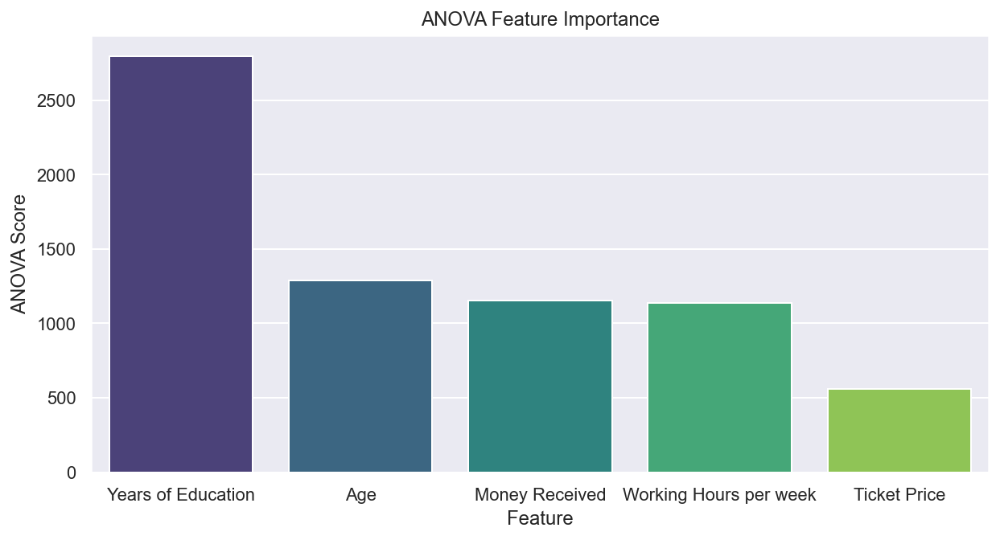

In [76]:
# ANOVA feature selection for numeric input and categorical output

# define and apply feature selection 
anova_fs = SelectKBest(score_func=f_classif, k=2)
anova_selected = anova_fs.fit_transform(metric_features, newland_target)

feature_list_anova = metric_features.columns.values

i=0
featureImportanceAnova = []
for item in anova_fs.scores_:
    featureImportanceAnova.append((item, feature_list_anova [i]))
    i=i+1

featureImportanceAnova = sorted(featureImportanceAnova, reverse=True)
for item in featureImportanceAnova:
    print("{} : {}".format(item[1],item[0]))

fig, ax = pyplot.subplots(figsize = (10,5))
sns.barplot(x = pd.DataFrame(featureImportanceAnova)[1].tolist(), y = pd.DataFrame(featureImportanceAnova)[0].tolist(), ax = ax, palette = 'viridis', 
                 order = anova_fs.scores_.sort())
plt.title('ANOVA Feature Importance')
plt.xlabel('Feature')
plt.ylabel('ANOVA Score')

### Mututal Information 

Money Received : 0.07923021760533278
Age : 0.06993202987137437
Years of Education : 0.0593749450032377
Working Hours per week : 0.04374560443998865
Ticket Price : 0.039124403811610975


Text(0, 0.5, 'Mutual Information Score')

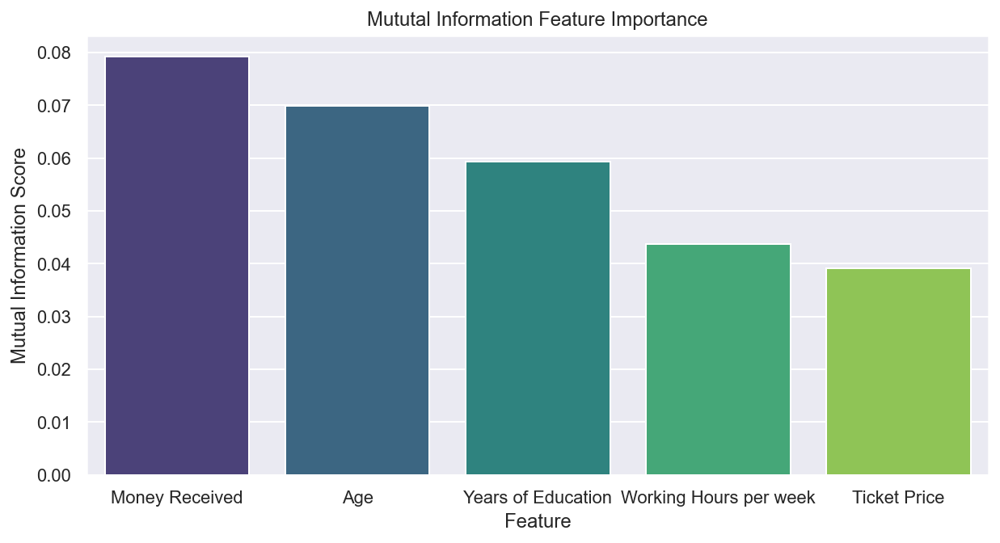

In [77]:
#Mutual information for selection of numerical variables and categorical output

# define and apply feature selection 
MI_fs = SelectKBest(score_func=mutual_info_classif, k='all')
MI_selected = MI_fs.fit_transform(metric_features,newland_target)

feature_list_MI = metric_features.columns.values

i=0
featureImportanceMI = []
for item in MI_fs.scores_:
    featureImportanceMI.append((item, feature_list_MI[i]))
    i=i+1

featureImportanceMI = sorted(featureImportanceMI, reverse=True)
for item in featureImportanceMI:
    print("{} : {}".format(item[1],item[0]))

fig, ax = pyplot.subplots(figsize = (10,5))
sns.barplot(x = pd.DataFrame(featureImportanceMI)[1].tolist(), y = pd.DataFrame(featureImportanceMI)[0].tolist(), ax = ax, palette = 'viridis', 
                 order = MI_fs.scores_.sort())
plt.title('Mututal Information Feature Importance')
plt.xlabel('Feature')
plt.ylabel('Mutual Information Score')

In [78]:
#Considering the information both from the ANOVA and Mutual Information method we will eliminate from the model the variable Working hours per Week (train and test dataset).

#newland_train_ohc_norm.drop("Working Hours per week", axis=1, inplace=True)
#newland_test_ohc_norm.drop("Working Hours per week", axis=1, inplace=True)

#print("Considering the information both from the ANOVA and Mutual Information method we will eliminate from the model the variable Working hours per Week (train and test dataset)")


### Correlation

In [79]:
# Correlation of numerical variables 
cor_pearson= newland_train_norm.corr()
cor_pearson

,Education Level,Years of Education,Working Hours per week,Age,Money Received,Ticket Price
Education Level,1.000000,0.940553,0.158781,0.054489,0.117616,0.080890
Years of Education,0.940553,1.000000,0.138516,0.035241,0.123015,0.084810
Working Hours per week,0.158781,0.138516,1.000000,0.064900,0.075471,0.052959
Age,0.054489,0.035241,0.064900,1.000000,0.072693,0.055774
Money Received,0.117616,0.123015,0.075471,0.072693,1.000000,-0.031330
Ticket Price,0.080890,0.084810,0.052959,0.055774,-0.031330,1.000000


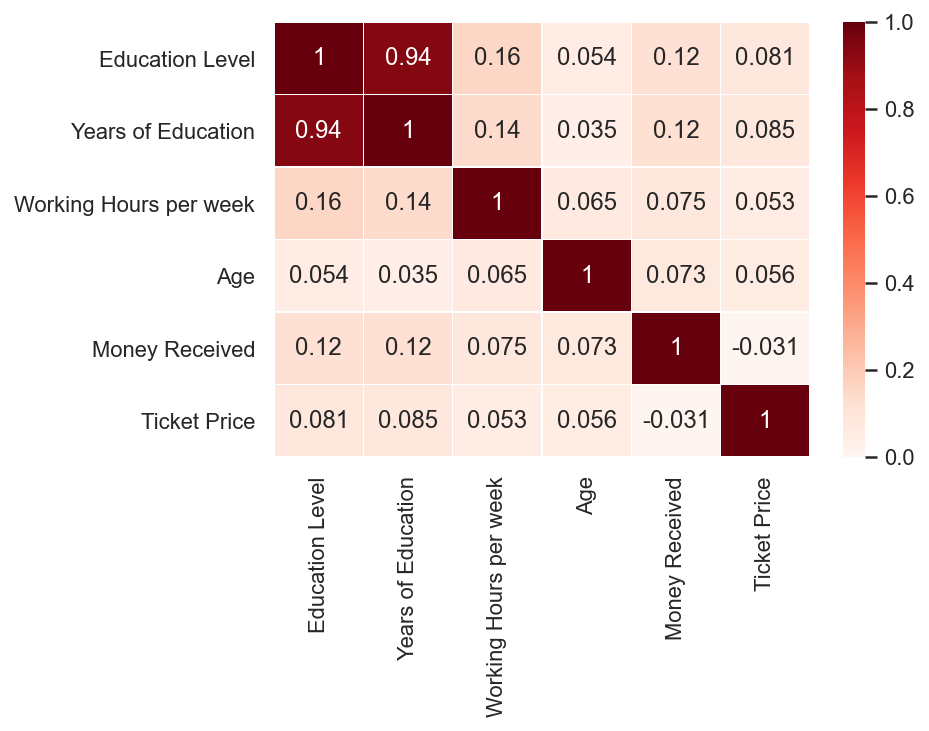

In [80]:
hp_corr = sns.heatmap(cor_pearson, cmap=plt.cm.Reds, annot=True,
                      xticklabels=True, yticklabels=True,
                      linewidths=.2, vmin=0, vmax=1) 

hp_corr.set_xticklabels(hp_corr.get_xticklabels(), rotation=90) 
hp_corr.set_yticklabels(hp_corr.get_yticklabels()) 

plt.show()

In [81]:
#To see which numerical variables are more correlated
corr = newland_train_norm.corr().abs()
high_corr_var = np.where(corr>=0.8)
high_corr_var = [(corr.columns[x],corr.columns[y]) for x,y in zip(*high_corr_var) if x!=y and x<y]
high_corr_var

[('Education Level', 'Years of Education')]

In [82]:
#to see the correlation between the numerical variables and the target variable
corr_target = newland_train_norm.corrwith(newland_train["Income"])
corr_target

Education Level           0.320452
Years of Education        0.333089
Working Hours per week    0.219890
Age                       0.233157
Money Received            0.221440
Ticket Price              0.155890
dtype: float64

In [83]:
#considering these results we should drop the variable education level
X_train.drop('Education Level', axis=1, inplace=True)
X_test.drop('Education Level', axis=1, inplace=True)
X_val.drop('Education Level', axis=1, inplace=True)
X_test_test.drop('Education Level', axis=1, inplace=True)

C:\Users\marta\anaconda3\lib\site-packages\pandas\core\frame.py:3990: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


## Categorical Features

### Chi_Squared Test

#### K=10

In [84]:
X_train_non_metric = X_train.drop(metric_features_list, axis=1)

#chi_squared for categorical  k=10
chisq_fs_10 = SelectKBest(score_func=chi2, k=10)
chisq_fs_10.fit(X_train_non_metric, y_train)

#X_train_fs = fs.transform(x_train_non_metric)

SelectKBest(score_func=<function chi2 at 0x0000019739F130D0>)

In [85]:
#this will show the dataframe with the best features we can define how many we want by changing the k in the above cell
index_10 = chisq_fs_10.get_support(indices=True)
chisq_10 = X_train_non_metric.iloc[:,index_10]

#### Chi-square Scores

Marital Status_Married , 1313.34%
Lives with_Wife , 1233.29%
Marital Status_Single , 902.88%
Role_Army ,  nan%
Group_B , 873.31%
Lives with_Children , 581.10%
Role_Management , 560.57%
Lives with_Other Family , 363.25%
Role_Other services , 292.42%
Group_C , 259.14%
Lives with_Husband , 241.58%
Lives with_Alone , 215.63%
Marital Status_Divorced , 177.44%
Group_A , 162.60%
Employment Sector_Self-Employed , 143.30%
Role_Professor , 130.93%
Native Continent_Africa , 102.75%
Role_Cleaners & Handlers , 97.39%
Lives with_Other relatives , 87.74%
Role_Administratives , 87.45%
Gender_Male , 76.20%
Role_Machine Operators & Inspectors , 66.90%
Marital Status_Separated , 65.02%
Employment Sector_Private Sector , 47.95%
Employment Sector_Public Sector , 46.94%
Marital Status_Widow , 44.43%
Role_Agriculture and Fishing , 37.33%
Native Continent_Oceania , 20.04%
Base Area_Other , 18.27%
Native Continent_Europe , 16.17%
Role_Household Services , 15.85%
Role_Security , 9.81%
Role_IT , 9.29%
Role_Sales

Text(0, 0.5, 'Chi-sd Score')

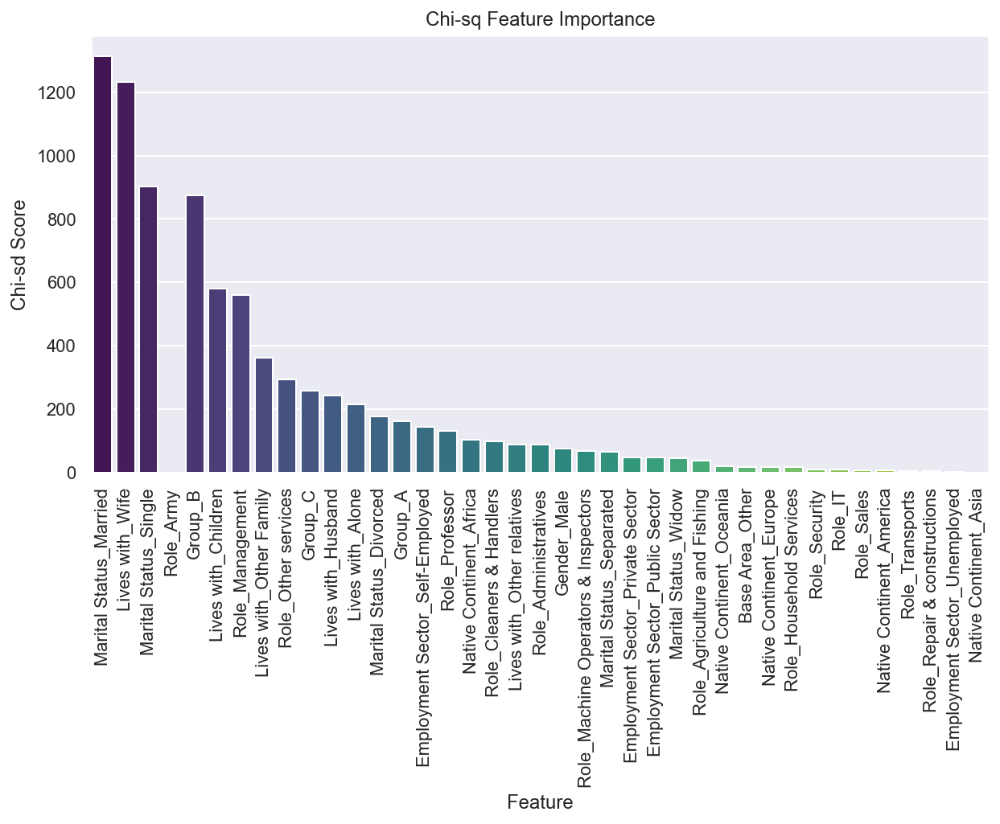

In [86]:
feature_list = X_train_non_metric.columns.values

i=0
featureImportance = []
for item in chisq_fs_10.scores_:
    featureImportance.append((item, feature_list[i]))
    i=i+1

featureImportance = sorted(featureImportance, reverse=True)
for item in featureImportance:
    print ("{0} , {1:4.2f}%".format(item[1],item[0]))

fig, ax = pyplot.subplots(figsize = (10,5))
sns.barplot(x = pd.DataFrame(featureImportance)[1].tolist(), y = pd.DataFrame(featureImportance)[0].tolist(), ax = ax, palette = 'viridis', 
                 order = chisq_fs_10.scores_.sort())
plt.xticks(fontsize=11, rotation=90)
plt.title('Chi-sq Feature Importance')
plt.xlabel('Feature')
plt.ylabel('Chi-sd Score')

In [87]:
#Create train data set with 10 categorical features selected thought chisq 
X_train_chi10 = X_train[chisq_10.columns.values.tolist() + metric_features_list]
X_train_chi10.drop(['Working Hours per week'], axis=1, inplace=True)

X_val_chi10 = X_val[chisq_10.columns.values.tolist() + metric_features_list]
X_val_chi10.drop(['Working Hours per week'], axis=1, inplace=True)

X_test_chi10 = X_test[chisq_10.columns.values.tolist() + metric_features_list]
X_test_chi10.drop(['Working Hours per week'], axis=1, inplace=True)

C:\Users\marta\anaconda3\lib\site-packages\pandas\core\frame.py:3990: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [88]:
#Create test data set with 10 categorical features selected thought chisq 
X_test_test_chi10 = X_test_test[chisq_10.columns.values.tolist() + metric_features_list]
X_test_test_chi10.drop(['Working Hours per week'], axis=1, inplace=True)

#### K=20

In [89]:
#chi_squared for categorical  k=20
chisq_fs_20 = SelectKBest(score_func=chi2, k=20)
chisq_fs_20.fit(X_train_non_metric, y_train)

#X_train_fs_20 = chisq_fs_20.transform(X_train_non_metric)

SelectKBest(k=20, score_func=<function chi2 at 0x0000019739F130D0>)

In [90]:
#this will show the dataframe with the 20 best features
index_20 = chisq_fs_20.get_support(indices=True)
chisq_20 = X_train_non_metric.iloc[:,index_20]

In [91]:
#Create train data set with 20 categorical features selected thought chisq 
X_train_chi20 = X_train[chisq_20.columns.values.tolist() + metric_features_list]
#X_train_chi20.drop(['Working Hours per week'], axis=1, inplace=True)

X_val_chi20 = X_val[chisq_20.columns.values.tolist() + metric_features_list]
#X_val_chi20.drop(['Working Hours per week'], axis=1, inplace=True)

X_test_chi20 = X_test[chisq_20.columns.values.tolist() + metric_features_list]
#X_test_chi20.drop(['Working Hours per week'], axis=1, inplace=True)

In [92]:
X_test_test_chi20 = X_test_test[chisq_20.columns.values.tolist() + metric_features_list]
#X_test_test_chi20.drop(['Working Hours per week'], axis=1, inplace=True)

# Model Selection #

In [94]:
def metric(y_train, pred_train): #y_val, pred_val, y_test, pred_test
    print('___________________________________________________________________________________________________________')
    print('                                                     TRAIN                                                 ')
    print('-----------------------------------------------------------------------------------------------------------')
    print(classification_report(y_train, pred_train))
    print(confusion_matrix(y_train, pred_train))

In [95]:
def metric_II(y_train, pred_train, y_val, pred_val, y_test, pred_test):
    print('___________________________________________________________________________________________________________')
    print('                                                     TRAIN                                                 ')
    print('-----------------------------------------------------------------------------------------------------------')
    print(classification_report(y_train, pred_train))
    print(confusion_matrix(y_train, pred_train))


    print('___________________________________________________________________________________________________________')
    print('                                                VALIDATION                                                 ')
    print('-----------------------------------------------------------------------------------------------------------')
    print(classification_report(y_val, pred_val))
    print(confusion_matrix(y_val, pred_val))
    
    
    print('___________________________________________________________________________________________________________')
    print('                                               TEST                                                        ')
    print('-----------------------------------------------------------------------------------------------------------')
    print(classification_report(y_test, pred_test))
    print(confusion_matrix(y_test, pred_test))

## Naive Bayes

### Naive Bayes | All Features

In [96]:
modelNB1 = GaussianNB()
modelNB1.fit(X_train, y_train)

GaussianNB()

In [97]:
#to obtain the probability estimates for the `X_test`
prob_modelNB1 = modelNB1.predict_proba(X_test)

In [98]:
labels_train_nb1 = modelNB1.predict(X_train)
labels_test_test_nb1 = modelNB1.predict(X_test_test)

In [99]:
metric(y_train, labels_train_nb1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.55      0.70     10253
           1       0.39      0.93      0.55      3187

    accuracy                           0.64     13440
   macro avg       0.68      0.74      0.63     13440
weighted avg       0.83      0.64      0.67     13440

[[5663 4590]
 [ 211 2976]]


In [100]:
score_modelNB1_val = modelNB1.score(X_val, y_val)

In [101]:
cv_modelNB1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNB1_val = cross_val_score(modelNB1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelNB1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNB1_val), std(n_scores_modelNB1_val)))

Accuracy: 0.583 (0.017)


In [102]:
score_modelNB1_test = modelNB1.score(X_test, y_test)

In [103]:
cv_modelNB1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNB1_test = cross_val_score(modelNB1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelNB1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNB1_test), std(n_scores_modelNB1_test)))

Accuracy: 0.627 (0.038)


### Naive Bayes | Without 'Working Hours per Week' and After chi_square k=10

In [104]:
modelNB2 = GaussianNB()
modelNB2.fit(X = X_train_chi10, y = y_train)

GaussianNB()

In [105]:
#to obtain the probability estimates for the `X_test`
prob_modelNB2 = modelNB2.predict_proba(X_test_chi10)

In [106]:
labels_train_nb2 = modelNB2.predict(X_train_chi10)
labels_test_test_nb2 = modelNB2.predict(X_test_test_chi10)

In [107]:
metric(y_train, labels_train_nb1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.55      0.70     10253
           1       0.39      0.93      0.55      3187

    accuracy                           0.64     13440
   macro avg       0.68      0.74      0.63     13440
weighted avg       0.83      0.64      0.67     13440

[[5663 4590]
 [ 211 2976]]


In [108]:
score_modelNB2_val = modelNB2.score(X = X_val_chi10, y = y_val)

In [109]:
cv_modelNB2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNB2_val = cross_val_score(modelNB2, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelNB2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNB2_val), std(n_scores_modelNB2_val)))

Accuracy: 0.803 (0.019)


In [110]:
score_modelNB2_test = modelNB2.score(X = X_test_chi10, y = y_test)

In [111]:
cv_modelNB2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNB2_test = cross_val_score(modelNB2, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelNB2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNB2_test), std(n_scores_modelNB2_test)))

Accuracy: 0.824 (0.017)


### Naive Bayes | Without 'Working Hours per Week' and After chi_square k=20

In [112]:
modelNB3 = GaussianNB()
modelNB3.fit(X = X_train_chi20, y = y_train)

GaussianNB()

In [113]:
#to obtain the probability estimates for the `X_test`
prob_modelNB3 = modelNB3.predict_proba(X_test_chi20)

In [114]:
labels_train_nb3 = modelNB3.predict(X_train_chi20)
labels_test_test_nb3 = modelNB3.predict(X_test_test_chi20)

In [115]:
metric(y_train, labels_train_nb3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.71      0.81     10253
           1       0.48      0.84      0.61      3187

    accuracy                           0.74     13440
   macro avg       0.71      0.78      0.71     13440
weighted avg       0.83      0.74      0.76     13440

[[7315 2938]
 [ 500 2687]]


In [116]:
score_modelNB3_val = modelNB3.score(X = X_val_chi20, y = y_val)

In [117]:
cv_modelNB3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNB3_val = cross_val_score(modelNB3, X_val_chi20, y_val, scoring='accuracy', 
                                   cv=cv_modelNB3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNB3_val), std(n_scores_modelNB3_val)))

Accuracy: 0.731 (0.023)


In [118]:
score_modelNB3_test = modelNB3.score(X = X_test_chi20, y = y_test)

In [119]:
cv_modelNB3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNB3_test = cross_val_score(modelNB3, X_test_chi20, y_test, scoring='accuracy', 
                                   cv=cv_modelNB3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNB3_test), std(n_scores_modelNB3_test)))

Accuracy: 0.747 (0.024)


### Naive Bayes | Tuning Parameters

In [120]:
np.logspace(0,-9, num=10)

params_NB = {'var_smoothing': np.logspace(0,-9, num=100)}

gs_NB = GridSearchCV(estimator=modelNB2, 
                     param_grid=params_NB, 
                     cv=10,
                     verbose=1, 
                     scoring='accuracy')
gs_NB.fit(X_train_chi10, y_train)

Fitting 10 folds for each of 100 candidates, totalling 1000 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 1000 out of 1000 | elapsed:    9.8s finished


GridSearchCV(cv=10, estimator=GaussianNB(),
             param_grid={'var_smoothing': array([1.00000000e+00, 8.11130831e-01, 6.57933225e-01, 5.33669923e-01,
       4.32876128e-01, 3.51119173e-01, 2.84803587e-01, 2.31012970e-01,
       1.87381742e-01, 1.51991108e-01, 1.23284674e-01, 1.00000000e-01,
       8.11130831e-02, 6.57933225e-02, 5.33669923e-02, 4.32876128e-02,
       3.51119173e-02, 2.84803587e-02, 2.3...
       1.23284674e-07, 1.00000000e-07, 8.11130831e-08, 6.57933225e-08,
       5.33669923e-08, 4.32876128e-08, 3.51119173e-08, 2.84803587e-08,
       2.31012970e-08, 1.87381742e-08, 1.51991108e-08, 1.23284674e-08,
       1.00000000e-08, 8.11130831e-09, 6.57933225e-09, 5.33669923e-09,
       4.32876128e-09, 3.51119173e-09, 2.84803587e-09, 2.31012970e-09,
       1.87381742e-09, 1.51991108e-09, 1.23284674e-09, 1.00000000e-09])},
             scoring='accuracy', verbose=1)

In [121]:
gs_NB.best_params_

{'var_smoothing': 5.3366992312063123e-05}

In [122]:
#Applying the best parameter
modelNB4 = GaussianNB(var_smoothing= 5.3366992312063123e-05)
modelNB4.fit(X = X_train_chi10, y = y_train)

GaussianNB(var_smoothing=5.3366992312063123e-05)

In [123]:
#to obtain the probability estimates for the `X_test`
prob_modelNB4 = modelNB4.predict_proba(X_test_chi10)

In [124]:
labels_train_nb4 = modelNB4.predict(X_train_chi10)
labels_test_test_nb4 = modelNB4.predict(X_test_test_chi10)

In [125]:
metric(y_train, labels_train_nb4)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.89      0.87      0.88     10253
           1       0.61      0.65      0.63      3187

    accuracy                           0.82     13440
   macro avg       0.75      0.76      0.75     13440
weighted avg       0.82      0.82      0.82     13440

[[8923 1330]
 [1117 2070]]


In [126]:
#to check the probability of each class (0,1) , so the probability of being 1 is only 24%
modelNB4.class_prior_

array([0.76287202, 0.23712798])

In [127]:
score_modelNB4_val=modelNB4.score(X = X_val_chi10, y = y_val)

In [128]:
cv_modelNB4_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNB4_val = cross_val_score(modelNB4, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelNB4_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNB4_val), std(n_scores_modelNB4_val)))

Accuracy: 0.803 (0.019)


In [129]:
score_modelNB4_test=modelNB4.score(X = X_test_chi10, y = y_test)

In [130]:
cv_modelNB4_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNB4_test = cross_val_score(modelNB4, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelNB4_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNB4_test), std(n_scores_modelNB4_test)))

Accuracy: 0.825 (0.016)


### Naive Bayes | Model Comparison

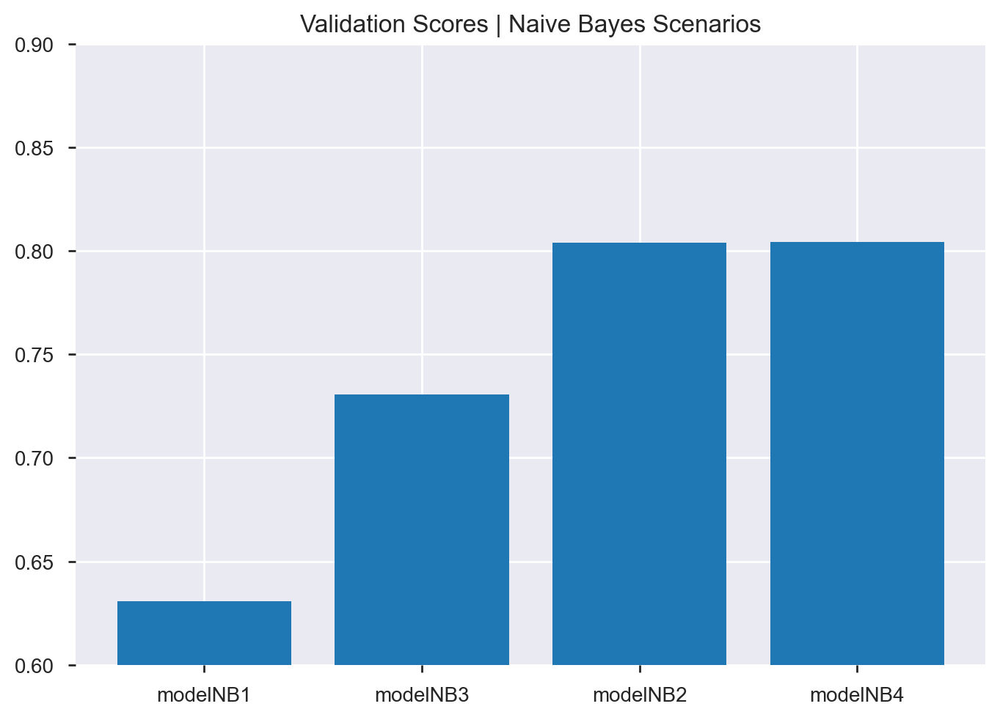

In [131]:
accuracies_NB_val = [score_modelNB1_val, score_modelNB2_val, score_modelNB3_val, score_modelNB4_val]
models_NB_val = ['modelNB1', 'modelNB2','modelNB3','modelNB4']
data_tuples = list(zip(models_NB_val,accuracies_NB_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Naive Bayes Scenarios')
plt.ylim(0.60,0.90)
plt.show()

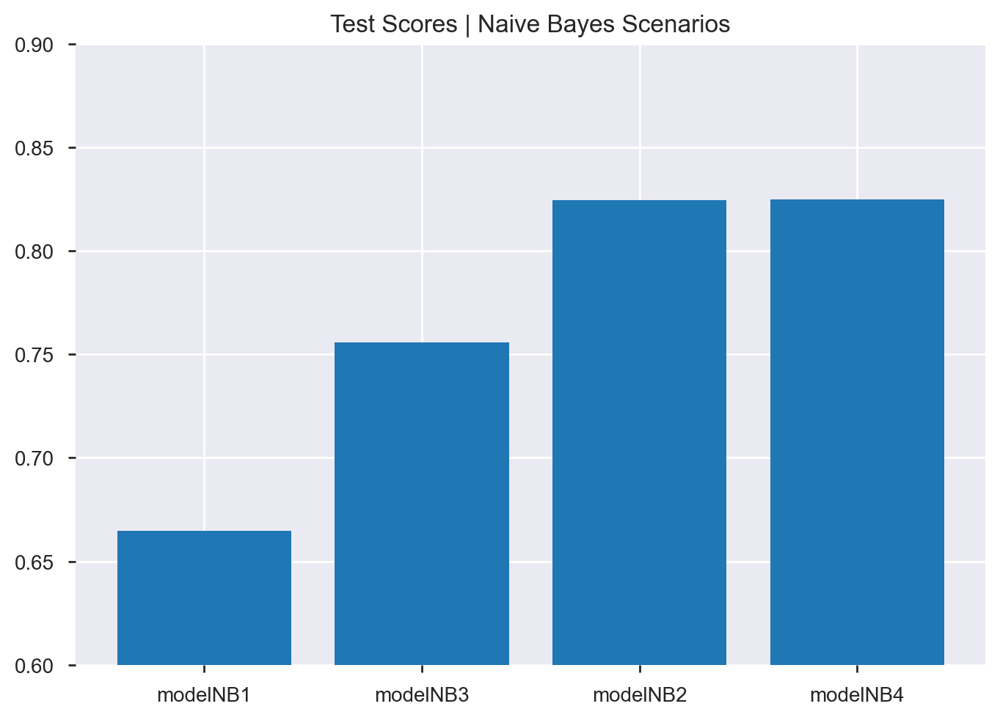

In [132]:
accuracies_NB_test = [score_modelNB1_test, score_modelNB2_test, score_modelNB3_test, score_modelNB4_test]
models_NB_test = ['modelNB1', 'modelNB2','modelNB3', 'modelNB4']
data_tuples = list(zip(models_NB_test,accuracies_NB_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.ylim(0.60,0.90)
plt.title('Test Scores | Naive Bayes Scenarios')
plt.show()

## Logistic Regression

### Logistic Regression | All Features

In [133]:
modelLR1 = LogisticRegression()
modelLR1.fit(X_train, y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [134]:
prob_modelLR1 = modelLR1.predict_proba(X_test)

In [135]:
labels_train_lr1 = modelLR1.predict(X_train)
labels_test_test_lr1 = modelLR1.predict(X_test_test)

In [136]:
metric(y_train, labels_train_lr1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.93      0.90     10253
           1       0.72      0.58      0.64      3187

    accuracy                           0.85     13440
   macro avg       0.80      0.75      0.77     13440
weighted avg       0.84      0.85      0.84     13440

[[9540  713]
 [1341 1846]]


In [137]:
score_modelLR1_val = modelLR1.score(X_val, y_val)

In [138]:
cv_modelLR1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLR1_val = cross_val_score(modelLR1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelLR1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLR1_val), std(n_scores_modelLR1_val)))

Accuracy: 0.833 (0.016)


In [139]:
score_modelLR1_test = modelLR1.score(X_test, y_test)

In [140]:
cv_modelLR1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLR1_test = cross_val_score(modelLR1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelLR1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLR1_test), std(n_scores_modelLR1_test)))

Accuracy: 0.847 (0.015)


### Logistic Regression | Without 'Working Hours per Week' and After chi_square k=10

In [141]:
modelLR2 = LogisticRegression()
modelLR2.fit(X_train_chi10, y_train)

LogisticRegression()

In [142]:
prob_modelLR2 = modelLR2.predict_proba(X_test_chi10)

In [143]:
labels_train_lr2 = modelLR2.predict(X_train_chi10)
labels_test_test_lr2 = modelLR2.predict(X_test_test_chi10)

In [144]:
metric(y_train, labels_train_lr2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.87      0.93      0.90     10253
           1       0.71      0.56      0.63      3187

    accuracy                           0.84     13440
   macro avg       0.79      0.74      0.76     13440
weighted avg       0.83      0.84      0.83     13440

[[9528  725]
 [1405 1782]]


In [145]:
score_modelLR2_val = modelLR2.score(X_val_chi10, y_val)

In [146]:
cv_modelLR2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLR2_val = cross_val_score(modelLR2, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelLR2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLR2_val), std(n_scores_modelLR2_val)))

Accuracy: 0.827 (0.017)


In [147]:
score_modelLR2_test = modelLR2.score(X_test_chi10, y_test)

In [148]:
cv_modelLR2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLR2_test = cross_val_score(modelLR2, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelLR2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLR2_test), std(n_scores_modelLR2_test)))

Accuracy: 0.842 (0.017)


### Logistic Regression | Without 'Working Hours per Week' and After chi_square k=20

In [149]:
modelLR3 = LogisticRegression()
modelLR3.fit(X_train_chi20, y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [150]:
prob_modelLR3 = modelLR3.predict_proba(X_test_chi20)

In [151]:
labels_train_lr3 = modelLR3.predict(X_train_chi20)
labels_test_test_lr3 = modelLR3.predict(X_test_test_chi20)

In [152]:
metric(y_train, labels_train_lr3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.87      0.93      0.90     10253
           1       0.71      0.55      0.62      3187

    accuracy                           0.84     13440
   macro avg       0.79      0.74      0.76     13440
weighted avg       0.83      0.84      0.83     13440

[[9538  715]
 [1419 1768]]


In [153]:
score_modelLR3_val = modelLR3.score(X_val_chi20, y_val)

In [154]:
cv_modelLR3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLR3_val = cross_val_score(modelLR3, X_val_chi20, y_val, scoring='accuracy', 
                                   cv=cv_modelLR3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLR3_val), std(n_scores_modelLR3_val)))

Accuracy: 0.830 (0.018)


In [155]:
score_modelLR3_test = modelLR3.score(X_test_chi20, y_test)

In [156]:
cv_modelLR3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLR3_test = cross_val_score(modelLR3, X_test_chi20, y_test, scoring='accuracy', 
                                   cv=cv_modelLR3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLR3_test), std(n_scores_modelLR3_test)))

Accuracy: 0.844 (0.014)


### Logistic Regression | Balanced Database

In [157]:
modelLR4 = LogisticRegression()
modelLR4.fit(X_train_balance, y_train_balance)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [158]:
prob_modelLR4 = modelLR4.predict_proba(X_test)

In [159]:
labels_train_lr4 = modelLR4.predict(X_train_balance)
labels_test_test_lr4 = modelLR4.predict(X_test)

In [160]:
metric(y_train_balance, labels_train_lr4)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.84      0.83      0.83      6374
           1       0.79      0.80      0.80      5126

    accuracy                           0.82     11500
   macro avg       0.82      0.82      0.82     11500
weighted avg       0.82      0.82      0.82     11500

[[5283 1091]
 [1008 4118]]


In [161]:
score_modelLR4_val = modelLR4.score(X_val, y_val)

In [162]:
cv_modelLR4_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLR4_val = cross_val_score(modelLR4, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelLR4_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLR4_val), std(n_scores_modelLR4_val)))

Accuracy: 0.833 (0.016)


In [163]:
score_modelLR4_test = modelLR4.score(X_test, y_test)

In [164]:
cv_modelLR4_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLR4_test = cross_val_score(modelLR4, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelLR4_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLR4_test), std(n_scores_modelLR4_test)))

Accuracy: 0.847 (0.015)


### Logistic Regression | Tuning Parameters

In [165]:
modelLR5 = LogisticRegression(C=10000)
modelLR5.fit(X_train, y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(C=10000)

In [166]:
prob_modelLR5 = modelLR5.predict_proba(X_test)

In [167]:
labels_train_lr5 = modelLR4.predict(X_train)
labels_test_test_lr5 = modelLR4.predict(X_test)

In [168]:
metric(y_train_balance, labels_train_lr4)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.84      0.83      0.83      6374
           1       0.79      0.80      0.80      5126

    accuracy                           0.82     11500
   macro avg       0.82      0.82      0.82     11500
weighted avg       0.82      0.82      0.82     11500

[[5283 1091]
 [1008 4118]]


In [169]:
score_modelLR5_val=modelLR5.score(X_val, y_val)

In [170]:
cv_modelLR5_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLR5_val = cross_val_score(modelLR5, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelLR5_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLR5_val), std(n_scores_modelLR5_val)))

Accuracy: 0.844 (0.016)


In [171]:
score_modelLR5_test=modelLR5.score(X_test, y_test)

In [172]:
cv_modelLR5_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLR5_test = cross_val_score(modelLR5, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelLR5_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLR5_test), std(n_scores_modelLR5_test)))

Accuracy: 0.852 (0.014)


### Logistic Regression | Model Comparison

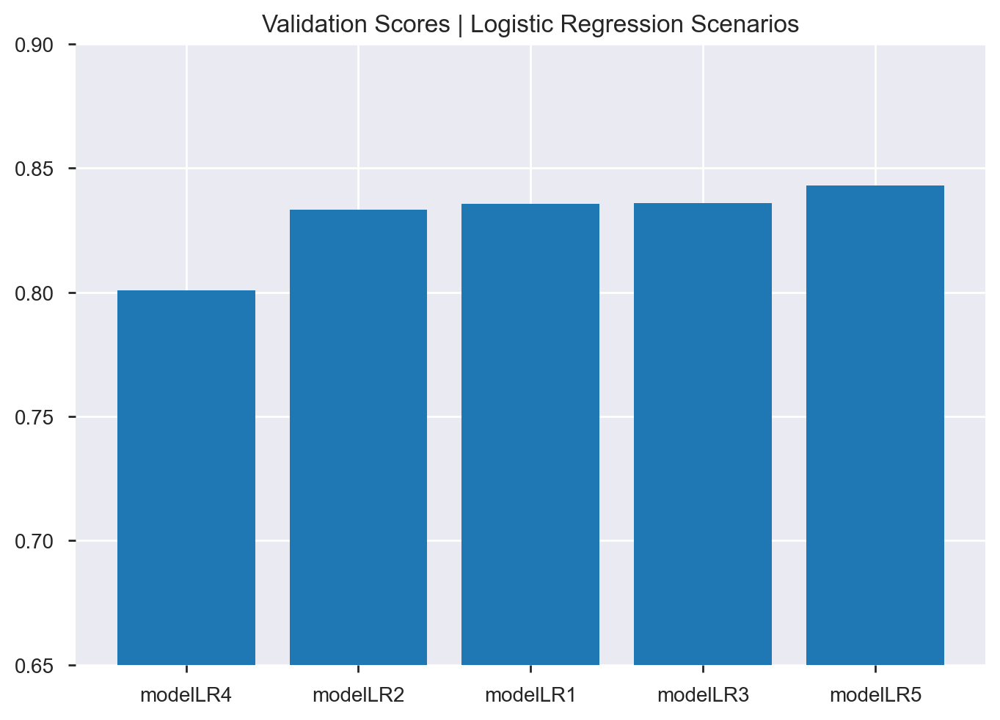

In [173]:
accuracies_LR_val = [score_modelLR1_val, score_modelLR2_val, score_modelLR3_val, score_modelLR4_val, score_modelLR5_val]
models_LR_val = ['modelLR1', 'modelLR2','modelLR3', 'modelLR4', 'modelLR5']
data_tuples = list(zip(models_LR_val,accuracies_LR_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Logistic Regression Scenarios')
plt.ylim(0.65,0.90)
plt.show()

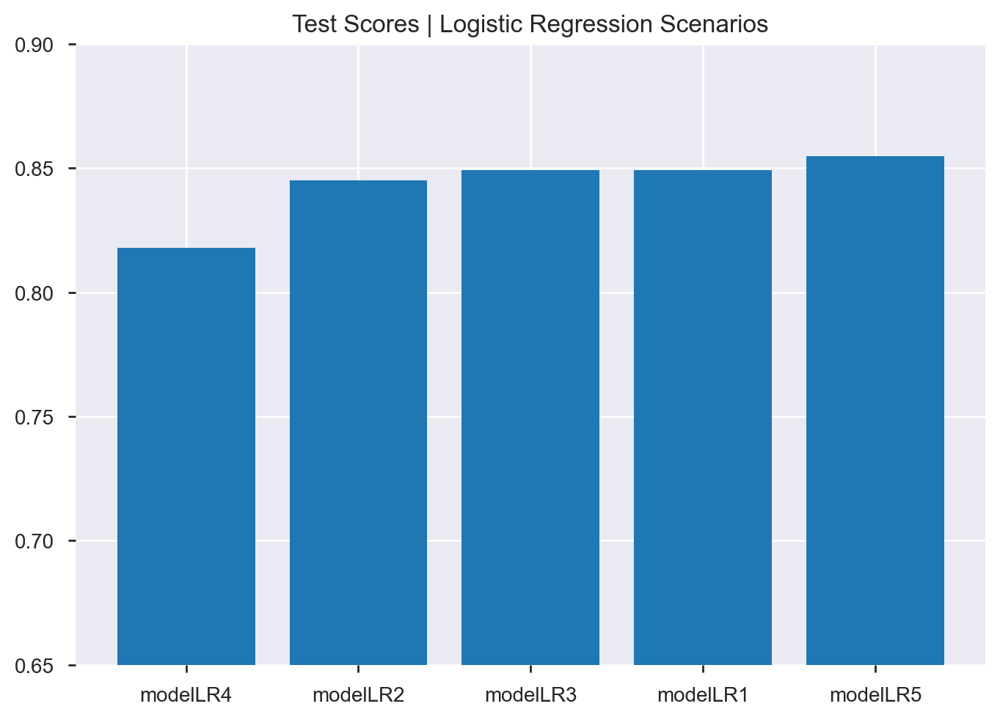

In [174]:
accuracies_LR_test = [score_modelLR1_test, score_modelLR2_test, score_modelLR3_test, score_modelLR4_test, score_modelLR5_test]
models_LR_test = ['modelLR1', 'modelLR2','modelLR3', 'modelLR4', 'modelLR5']
data_tuples = list(zip(models_LR_test,accuracies_LR_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Logistic Regression Scenarios')
plt.ylim(0.65,0.90)
plt.show()


## Linear Discriminant Analysis  

### Linear Discriminant Analysis | All Variables

In [175]:
modelLDA1 = LinearDiscriminantAnalysis()
modelLDA1.fit(X_train, y_train)

LinearDiscriminantAnalysis()

In [176]:
#to obtain the probability estimates for the `X_test`
prob_modelLDA1 = modelLDA1.predict_proba(X_test)

In [177]:
labels_train_lda1 = modelLDA1.predict(X_train)
labels_test_test_lda1 = modelLDA1.predict(X_test_test)

In [178]:
metric(y_train, labels_train_lda1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.93      0.90     10253
           1       0.71      0.58      0.64      3187

    accuracy                           0.84     13440
   macro avg       0.79      0.75      0.77     13440
weighted avg       0.84      0.84      0.84     13440

[[9491  762]
 [1327 1860]]


In [179]:
score_modelLDA1_val = modelLDA1.score(X_test, y_test) 

In [180]:
cv_modelLDA1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLDA1_val = cross_val_score(modelLDA1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelLDA1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLDA1_val), std(n_scores_modelLDA1_val)))

Accuracy: 0.833 (0.018)


In [181]:
score_modelLDA1_test = modelLDA1.score(X_test, y_test)

In [182]:
cv_modelLDA1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLDA1_test = cross_val_score(modelLDA1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelLDA1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLDA1_test), std(n_scores_modelLDA1_test)))

Accuracy: 0.843 (0.016)


### Linear Discriminant Analysis | Without 'Working Hours per Week' and After chi_square k=10

In [183]:
modelLDA2 = LinearDiscriminantAnalysis()
modelLDA2.fit(X = X_train_chi10, y = y_train)

LinearDiscriminantAnalysis()

In [184]:
#to obtain the probability estimates for the `X_test`
prob_modelLDA2 = modelLDA2.predict_proba(X_test_chi10)

In [185]:
labels_train_lda2 = modelLDA2.predict(X_train_chi10)
labels_test_test_lda2 = modelLDA2.predict(X_test_test_chi10)

In [186]:
metric(y_train, labels_train_lda2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.87      0.93      0.90     10253
           1       0.70      0.56      0.62      3187

    accuracy                           0.84     13440
   macro avg       0.79      0.74      0.76     13440
weighted avg       0.83      0.84      0.83     13440

[[9500  753]
 [1415 1772]]


In [187]:
score_modelLDA2_val = modelLDA2.score(X_val_chi10, y_val)

In [188]:
cv_modelLDA2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLDA2_val = cross_val_score(modelLDA2, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelLDA2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLDA2_val), std(n_scores_modelLDA2_val)))

Accuracy: 0.826 (0.016)


In [189]:
score_modelLDA2_test = modelLDA2.score(X_test_chi10, y_test)

In [190]:
cv_modelLDA2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLDA2_test = cross_val_score(modelLDA2, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelLDA2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLDA2_test), std(n_scores_modelLDA2_test)))

Accuracy: 0.844 (0.017)


### Linear Discriminant Analysis | Without 'Working Hours per Week' and After chi_square k=20

In [191]:
modelLDA3 = LinearDiscriminantAnalysis()
modelLDA3.fit(X = X_train_chi20, y = y_train)

LinearDiscriminantAnalysis()

In [192]:
#to obtain the probability estimates for the `X_test`
prob_modelLDA3 = modelLDA3.predict_proba(X_test_chi20)

In [193]:
labels_train_lda3 = modelLDA3.predict(X_train_chi20)
labels_test_test_lda3 = modelLDA3.predict(X_test_test_chi20)

In [194]:
metric(y_train, labels_train_lda3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.87      0.93      0.90     10253
           1       0.71      0.56      0.62      3187

    accuracy                           0.84     13440
   macro avg       0.79      0.74      0.76     13440
weighted avg       0.83      0.84      0.83     13440

[[9513  740]
 [1418 1769]]


In [195]:
score_modelLDA3_val = modelLDA3.score(X_val_chi20, y_val)

In [196]:
cv_modelLDA3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLDA3_val = cross_val_score(modelLDA3, X_val_chi20, y_val, scoring='accuracy', 
                                   cv=cv_modelLDA3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLDA3_val), std(n_scores_modelLDA3_val)))

Accuracy: 0.832 (0.017)


In [197]:
score_modelLDA3_test = modelLDA3.score(X_test_chi20, y_test)

In [198]:
cv_modelLDA3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelLDA3_test = cross_val_score(modelLDA3, X_test_chi20, y_test, scoring='accuracy', 
                                   cv=cv_modelLDA3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelLDA3_test), std(n_scores_modelLDA3_test)))

Accuracy: 0.843 (0.014)


### Linear Discriminant Analysis | Tuning Parameters

In [199]:
# Linear Discriminant Analysis - Parameter Tuning


## Search grid for optimal parameters
lda_param_grid = {"solver" : ["svd","eigen","lsqr"],
                 "tol" : [0.0001,0.0002,0.0003],
                 }


gsLDA = GridSearchCV(modelLDA1, param_grid = lda_param_grid, cv=10,
                     scoring="accuracy", n_jobs= 4, verbose = 1)

gsLDA.fit(X_train,y_train)

Fitting 10 folds for each of 9 candidates, totalling 90 fits


[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    3.5s
[Parallel(n_jobs=4)]: Done  90 out of  90 | elapsed:    5.2s finished


GridSearchCV(cv=10, estimator=LinearDiscriminantAnalysis(), n_jobs=4,
             param_grid={'solver': ['svd', 'eigen', 'lsqr'],
                         'tol': [0.0001, 0.0002, 0.0003]},
             scoring='accuracy', verbose=1)

In [200]:
gsLDA.best_estimator_


LinearDiscriminantAnalysis()

In [201]:
gsLDA.get_params() #nothing changed

{'cv': 10,
 'error_score': nan,
 'estimator__n_components': None,
 'estimator__priors': None,
 'estimator__shrinkage': None,
 'estimator__solver': 'svd',
 'estimator__store_covariance': False,
 'estimator__tol': 0.0001,
 'estimator': LinearDiscriminantAnalysis(),
 'iid': 'deprecated',
 'n_jobs': 4,
 'param_grid': {'solver': ['svd', 'eigen', 'lsqr'],
  'tol': [0.0001, 0.0002, 0.0003]},
 'pre_dispatch': '2*n_jobs',
 'refit': True,
 'return_train_score': False,
 'scoring': 'accuracy',
 'verbose': 1}

### Linear Discriminant Analysis |  Model Comparison

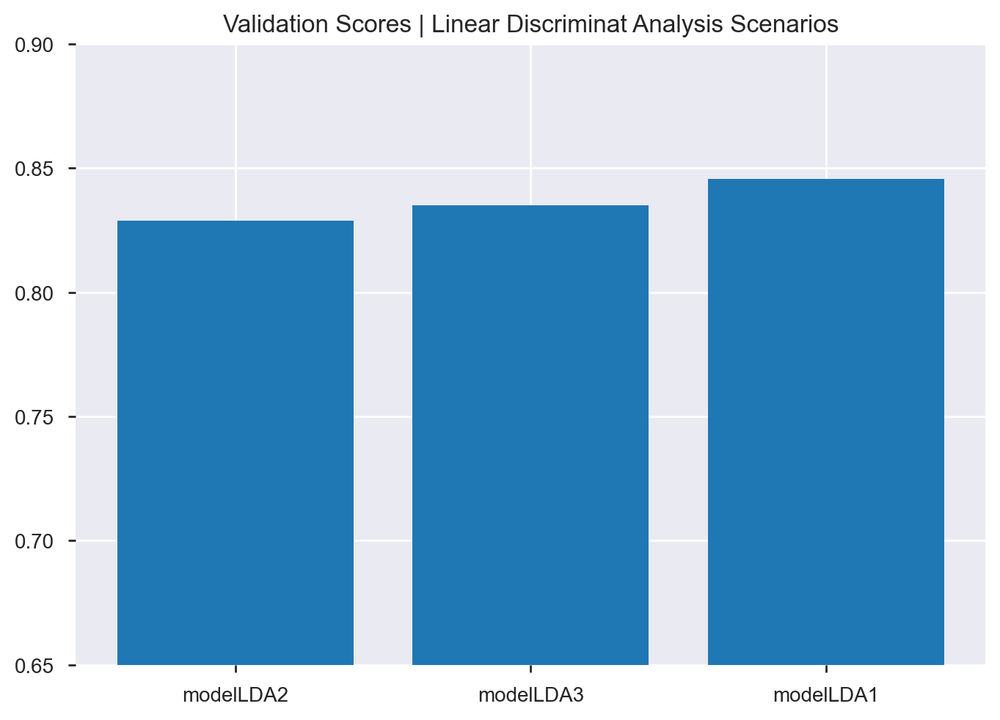

In [202]:
accuracies_LDA_val = [score_modelLDA1_val, score_modelLDA2_val, score_modelLDA3_val]
models_LDA_val = ['modelLDA1', 'modelLDA2','modelLDA3']
data_tuples = list(zip(models_LDA_val ,accuracies_LDA_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Linear Discriminat Analysis Scenarios')
plt.ylim(0.65,0.90)
plt.show()

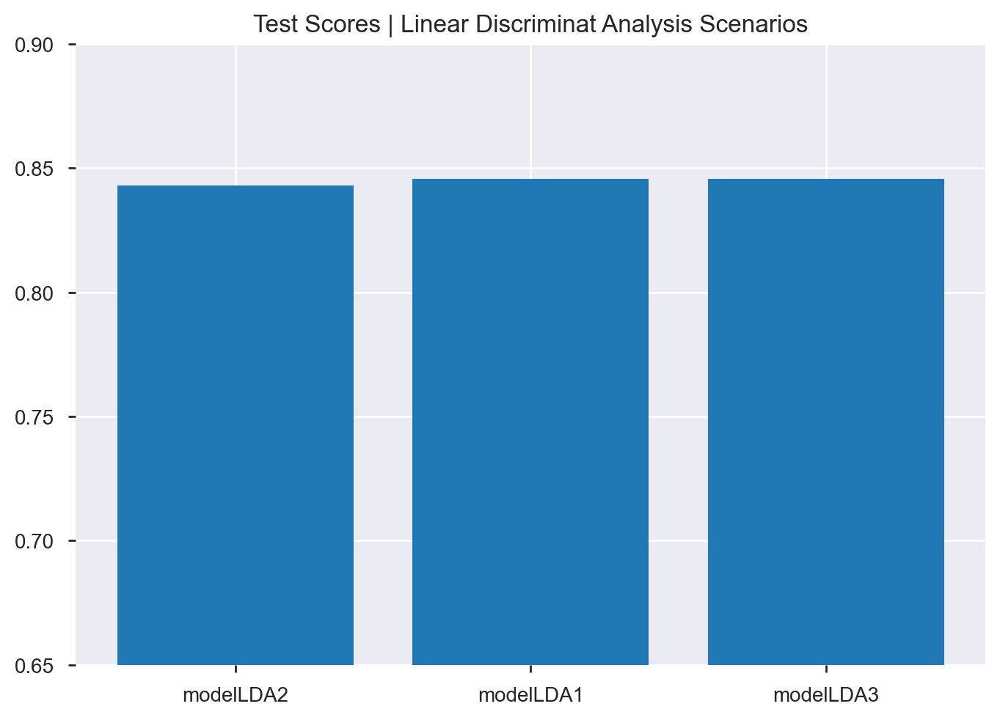

In [203]:
accuracies_LDA_test = [score_modelLDA1_test, score_modelLDA2_test, score_modelLDA3_test]
models_LDA_test = ['modelLDA1', 'modelLDA2','modelLDA3']
data_tuples = list(zip(models_LDA_test,accuracies_LDA_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Linear Discriminat Analysis Scenarios')
plt.ylim(0.65,0.90)
plt.show()

## KNN 

### KNN | All Variables 

In [204]:
modelKNN1 = KNeighborsClassifier()
modelKNN1.fit(X = X_train, y = y_train)

KNeighborsClassifier()

In [205]:
prob_modelKNN1 = modelKNN1.predict_proba(X_test)

In [206]:
labels_train_knn1 = modelKNN1.predict(X_train)
labels_test_test_knn1 = modelKNN1.predict(X_test_test)

In [207]:
metric(y_train, labels_train_knn1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.93      0.92     10253
           1       0.76      0.69      0.73      3187

    accuracy                           0.88     13440
   macro avg       0.84      0.81      0.82     13440
weighted avg       0.87      0.88      0.87     13440

[[9577  676]
 [ 990 2197]]


In [208]:
score_modelKNN1_val = modelKNN1.score(X_val, y_val)

In [209]:
cv_modelKNN1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelKNN1_val = cross_val_score(modelKNN1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelKNN1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelKNN1_val), std(n_scores_modelKNN1_val)))

Accuracy: 0.814 (0.018)


In [210]:
score_modelKNN1_test = modelKNN1.score(X_test, y_test)

In [211]:
cv_modelKNN1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelKNN1_test = cross_val_score(modelKNN1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelKNN1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelKNN1_test), std(n_scores_modelKNN1_test)))

Accuracy: 0.827 (0.014)


### KNN | Without 'Working Hours per Week' and After chi_square k=10

In [212]:
modelKNN2 = KNeighborsClassifier()
modelKNN2.fit(X = X_train_chi10, y = y_train)

KNeighborsClassifier()

In [213]:
prob_modelKNN2 = modelKNN2.predict_proba(X_test_chi10)

In [214]:
labels_train_knn2 = modelKNN2.predict(X_train_chi10)
labels_test_test_knn2 = modelKNN2.predict(X_test_test_chi10)

In [215]:
metric(y_train, labels_train_knn2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.89      0.93      0.91     10253
           1       0.74      0.63      0.68      3187

    accuracy                           0.86     13440
   macro avg       0.82      0.78      0.80     13440
weighted avg       0.86      0.86      0.86     13440

[[9541  712]
 [1165 2022]]


In [216]:
score_modelKNN2_val = modelKNN2.score(X_val_chi10, y_val)

In [217]:
cv_modelKNN2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelKNN2_val = cross_val_score(modelKNN2, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelKNN2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelKNN2_val), std(n_scores_modelKNN2_val)))

Accuracy: 0.818 (0.016)


In [218]:
score_modelKNN2_test = modelKNN2.score(X_test_chi10, y_test)

In [219]:
cv_modelKNN2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelKNN2_test = cross_val_score(modelKNN2, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelKNN2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelKNN2_test), std(n_scores_modelKNN2_test)))

Accuracy: 0.824 (0.016)


### KNN | Without 'Working Hours per Week' and After chi_square k=20

In [220]:
modelKNN3 = KNeighborsClassifier()
modelKNN3.fit(X = X_train_chi20, y = y_train)

KNeighborsClassifier()

In [221]:
prob_modelKNN3 = modelKNN3.predict_proba(X_test_chi20)

In [222]:
labels_train_knn3 = modelKNN3.predict(X_train_chi20)
labels_test_test_knn3 = modelKNN3.predict(X_test_test_chi20)

In [223]:
metric(y_train, labels_train_knn3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.93      0.92     10253
           1       0.76      0.69      0.72      3187

    accuracy                           0.88     13440
   macro avg       0.83      0.81      0.82     13440
weighted avg       0.87      0.88      0.87     13440

[[9565  688]
 [ 992 2195]]


In [224]:
score_modelKNN3_val = modelKNN3.score(X_val_chi20, y_val)

In [225]:
cv_modelKNN3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelKNN3_val = cross_val_score(modelKNN3, X_val_chi20, y_val, scoring='accuracy', 
                                   cv=cv_modelKNN3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelKNN3_val), std(n_scores_modelKNN3_val)))

Accuracy: 0.817 (0.020)


In [226]:
score_modelKNN3_test = modelKNN3.score(X_test_chi20, y_test)

In [227]:
cv_modelKNN3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelKNN3_test = cross_val_score(modelKNN3, X_test_chi20, y_test, scoring='accuracy', 
                                   cv=cv_modelKNN3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelKNN3_test), std(n_scores_modelKNN3_test)))

Accuracy: 0.818 (0.017)


### KNN | Tuning Parameters

In [262]:
params_KNN = {'n_neighbors': [5, 6, 7, 8,9,10,15]}


In [263]:
gs_KNN = GridSearchCV(estimator=modelKNN1, 
                      param_grid=params_KNN, 
                      cv=10,
                      verbose=1,  # verbose: the higher, the more messages
                      scoring='accuracy', 
                      return_train_score=True)

In [264]:
gs_KNN.fit(X_train,y_train)

Fitting 10 folds for each of 7 candidates, totalling 70 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  70 out of  70 | elapsed: 15.4min finished


GridSearchCV(cv=10, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': [5, 6, 7, 8, 9, 10, 15]},
             return_train_score=True, scoring='accuracy', verbose=1)

In [265]:
gs_KNN.best_params_

{'n_neighbors': 15}

In [268]:
##experiment with different algorithms

In [354]:
modelKNN1_tree = KNeighborsClassifier(algorithm='kd_tree')
modelKNN1_tree.fit(X = X_train, y = y_train)

labels_train_knn1_tree = modelKNN1_tree.predict(X_train)
labels_val_knn1_tree = modelKNN1_tree.predict(X_val)
labels_test_knn1_tree = modelKNN1_tree.predict(X_test)

prob_modelKNN1_tree = modelKNN1_tree.predict_proba(X_test)

metrics(y_train, labels_train_knn1_tree, y_val, labels_val_knn1_tree, y_test, labels_test_knn1_tree)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.93      0.92     10253
           1       0.76      0.69      0.72      3187

    accuracy                           0.87     13440
   macro avg       0.83      0.81      0.82     13440
weighted avg       0.87      0.87      0.87     13440

[[9553  700]
 [ 985 2202]]
___________________________________________________________________________________________________________
                                                VALIDATION                                                 
----------------------------------------------------------------------------------------------------------

In [362]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
scores = cross_val_score(modelKNN1_tree, X_val, y_val, scoring='f1_micro', cv=cv, n_jobs=-1)
score = mean(scores)
print('F1 Score: %.3f' % score)


F1 Score: 0.810


In [363]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
scores = cross_val_score(modelKNN1_tree, X_test, y_test, scoring='f1_micro', cv=cv, n_jobs=-1)
score = mean(scores)
print('F1 Score: %.3f' % score)

F1 Score: 0.822


In [355]:
modelKNN1_brute = KNeighborsClassifier(algorithm='brute')
modelKNN1_brute.fit(X = X_train, y = y_train)

labels_train_knn1_brute = modelKNN1_brute.predict(X_train)
labels_val_knn1_brute = modelKNN1_brute.predict(X_val)
labels_test_knn1_brute = modelKNN1_brute.predict(X_test)

prob_modelKNN1_brute = modelKNN1_brute.predict_proba(X_test)

metrics(y_train, labels_train_knn1_brute, y_val, labels_val_knn1_brute, y_test, labels_test_knn1_brute)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.93      0.92     10253
           1       0.76      0.69      0.72      3187

    accuracy                           0.87     13440
   macro avg       0.83      0.81      0.82     13440
weighted avg       0.87      0.87      0.87     13440

[[9542  711]
 [ 978 2209]]
___________________________________________________________________________________________________________
                                                VALIDATION                                                 
----------------------------------------------------------------------------------------------------------

In [360]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
scores = cross_val_score(modelKNN1_brute, X_val, y_val, scoring='f1_micro', cv=cv, n_jobs=-1)
score = mean(scores)
print('F1 Score: %.3f' % score)


F1 Score: 0.810


In [361]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
scores = cross_val_score(modelKNN1_brute, X_test, y_test, scoring='f1_micro', cv=cv, n_jobs=-1)
score = mean(scores)
print('F1 Score: %.3f' % score)

F1 Score: 0.822


In [ ]:
#The final model 

In [ ]:
modelKNN4 = KNeighborsClassifier(n_neighbors=15, leaf_size=40, p=1, algorithm='kd-tree')
modelKNN4.fit(X = X_train_chi10, y = y_train)

In [229]:
prob_modelKNN4 = modelKNN4.predict_proba(X_test_chi10)

In [230]:
labels_train_knn4 = modelKNN4.predict(X_train_chi10)
labels_test_test_knn4 = modelKNN4.predict(X_test_test_chi10)

In [231]:
metric(y_train, labels_train_knn4)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.93      0.91     10253
           1       0.73      0.60      0.66      3187

    accuracy                           0.85     13440
   macro avg       0.81      0.77      0.78     13440
weighted avg       0.85      0.85      0.85     13440

[[9551  702]
 [1265 1922]]


In [232]:
score_modelKNN4_val=modelKNN4.score(X_val_chi10, y_val)

In [233]:
cv_modelKNN4_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelKNN4_val = cross_val_score(modelKNN4, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelKNN4_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelKNN4_val), std(n_scores_modelKNN4_val)))

Accuracy: 0.829 (0.016)


In [234]:
score_modelKNN4_test=modelKNN4.score(X_test_chi10, y_test)

In [235]:
cv_modelKNN4_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelKNN4_test = cross_val_score(modelKNN4, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelKNN4_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelKNN4_test), std(n_scores_modelKNN4_test)))

Accuracy: 0.831 (0.016)


### KNN |  Model Comparison

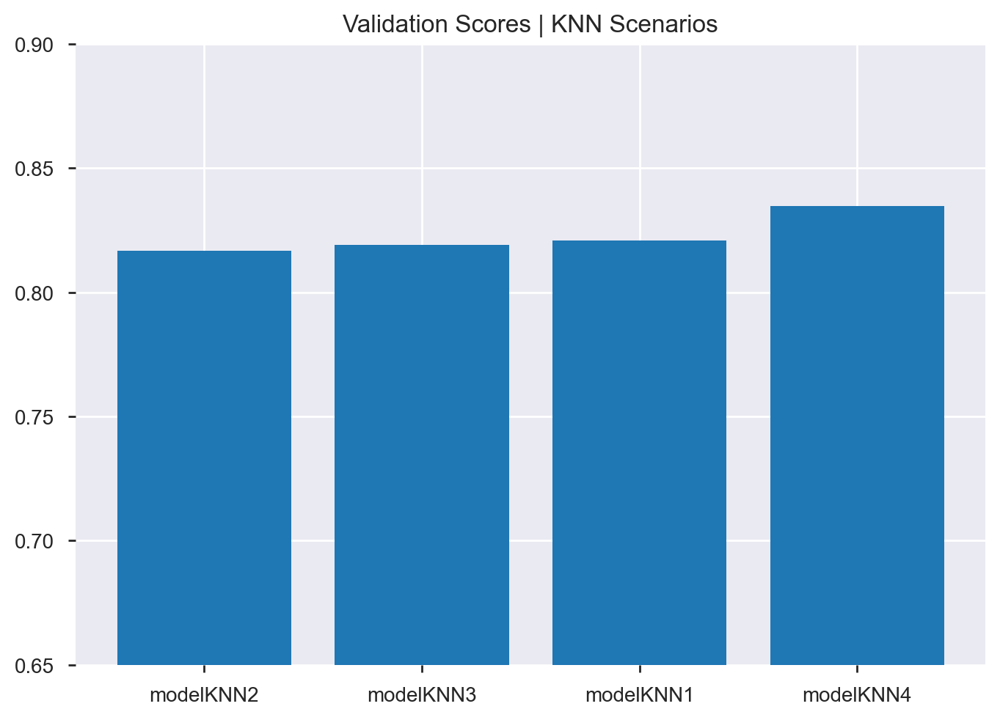

In [236]:
accuracies_KNN_val = [score_modelKNN1_val, score_modelKNN2_val, score_modelKNN3_val, score_modelKNN4_val]
models_KNN_val = ['modelKNN1', 'modelKNN2','modelKNN3','modelKNN4']
data_tuples = list(zip(models_KNN_val ,accuracies_KNN_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | KNN Scenarios')
plt.ylim(0.65,0.90)
plt.show()

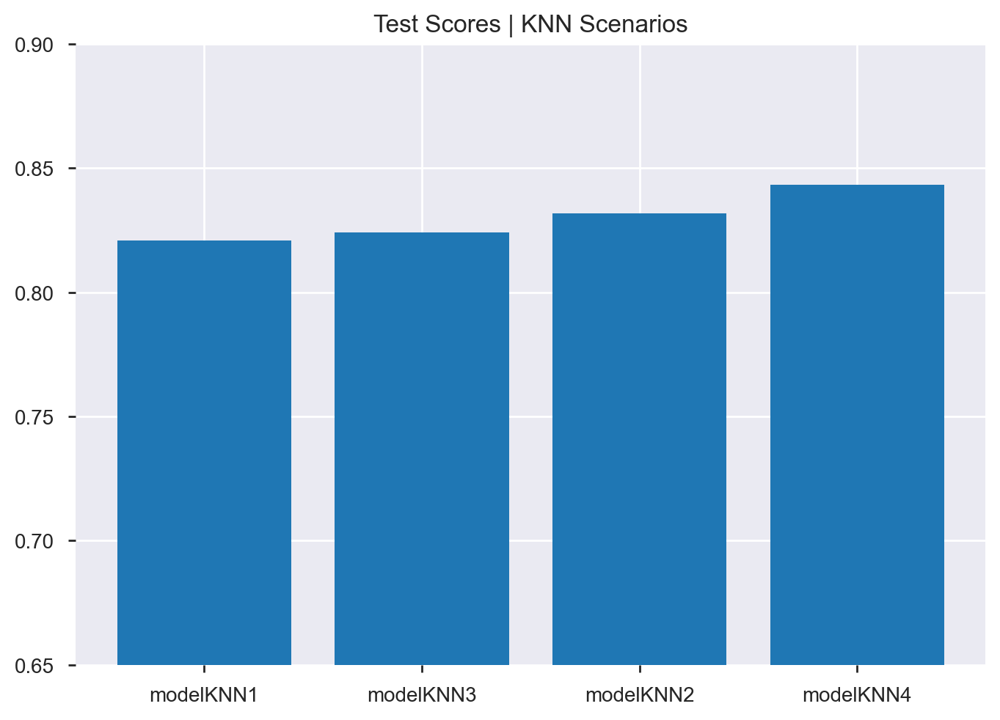

In [237]:
accuracies_KNN_test = [score_modelKNN1_test, score_modelKNN2_test, score_modelKNN3_test,score_modelKNN4_test]
models_KNN_test = ['modelKNN1', 'modelKNN2','modelKNN3', 'modelKNN4']
data_tuples = list(zip(models_KNN_test ,accuracies_KNN_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | KNN Scenarios')
plt.ylim(0.65,0.90)
plt.show()

## Neural Network 

### Neural Network | All Variables

In [689]:
modelNN1 = MLPClassifier(random_state=42)
modelNN1.fit(X_train, y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


MLPClassifier(random_state=42)

In [666]:
prob_modelNN1 = modelNN1.predict_proba(X_test)

In [667]:
labels_train_nn1 = modelNN1.predict(X_train)
labels_test_test_nn1 = modelNN1.predict(X_test_test)

In [668]:
metric(y_train, labels_train_nn1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.94      0.92     10253
           1       0.77      0.69      0.73      3187

    accuracy                           0.88     13440
   macro avg       0.84      0.81      0.83     13440
weighted avg       0.87      0.88      0.88     13440

[[9592  661]
 [ 980 2207]]


In [692]:
score_modelNN1_val = modelNN1.score(X_val, y_val)

In [693]:
cv_modelNN1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNN1_val = cross_val_score(modelNN1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelNN1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNN1_val), std(n_scores_modelNN1_val)))

Accuracy: 0.837 (0.016)


In [694]:
score_modelNN1_test = modelNN1.score(X_test, y_test)

In [695]:
cv_modelNN1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNN1_test = cross_val_score(modelNN1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelNN1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNN1_test), std(n_scores_modelNN1_test)))

Accuracy: 0.846 (0.014)


### Neural Network | Without 'Working Hours per Week' and After chi_square k=10

In [673]:
modelNN2 = MLPClassifier(random_state=42)
modelNN2.fit(X_train_chi10, y_train)

MLPClassifier()

In [674]:
prob_modelNN2 = modelNN2.predict_proba(X_test_chi10)

In [675]:
labels_train_nn2 = modelNN2.predict(X_train_chi10)
labels_test_test_nn2 = modelNN2.predict(X_test_test_chi10)

In [676]:
metric(y_train, labels_train_nn2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.87      0.95      0.91     10253
           1       0.76      0.56      0.65      3187

    accuracy                           0.85     13440
   macro avg       0.82      0.75      0.78     13440
weighted avg       0.85      0.85      0.85     13440

[[9706  547]
 [1407 1780]]


In [696]:
score_modelNN2_val = modelNN2.score(X_val_chi10, y_val)

In [678]:
cv_modelNN2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNN2_val = cross_val_score(modelNN2, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelNN2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNN2_val), std(n_scores_modelNN2_val)))

Accuracy: 0.843 (0.017)


In [679]:
score_modelNN2_test = modelNN2.score(X_test_chi10, y_test)

In [680]:
cv_modelNN2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNN2_test = cross_val_score(modelNN2, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelNN2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNN2_test), std(n_scores_modelNN2_test)))

Accuracy: 0.847 (0.014)


### Neural Networks | Tuning Parameters

In [795]:
modelNN3 = MLPClassifier(hidden_layer_sizes= (100,100,100), learning_rate='adaptive', learning_rate_init=0.001, random_state=42)
modelNN3.fit(X_train_chi10, y_train)

MLPClassifier(hidden_layer_sizes=(100, 100, 100), learning_rate='adaptive',
              random_state=42)

In [796]:
prob_modelNN3 = modelNN3.predict_proba(X_test_chi10)

In [797]:
labels_train_nn3 = modelNN3.predict(X_train_chi10)
labels_test_test_nn3 = modelNN3.predict(X_test_test_chi10)

In [798]:
metric(y_train, labels_train_nn3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.94      0.91     10253
           1       0.75      0.59      0.66      3187

    accuracy                           0.86     13440
   macro avg       0.81      0.76      0.78     13440
weighted avg       0.85      0.86      0.85     13440

[[9617  636]
 [1302 1885]]


In [799]:
score_modelNN3_val=modelNN3.score(X_val_chi10, y_val)

In [800]:
cv_modelNN3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNN3_val = cross_val_score(modelNN3, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelNN3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNN3_val), std(n_scores_modelNN3_val)))

Accuracy: 0.842 (0.016)


In [801]:
score_modelNN3_test=modelNN3.score(X_test_chi10, y_test)

In [802]:
cv_modelNN3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelNN3_test = cross_val_score(modelNN3, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelNN3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelNN3_test), std(n_scores_modelNN3_test)))

Accuracy: 0.846 (0.016)


### Neural Networks |  Model Comparison

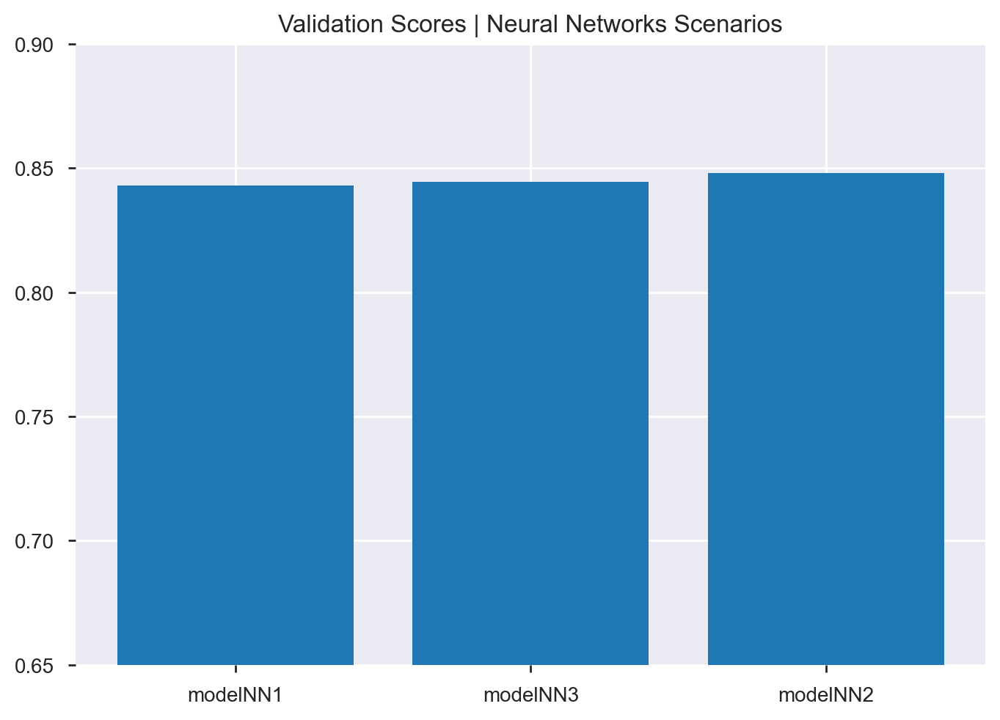

In [803]:
accuracies_NN_val = [score_modelNN1_val, score_modelNN2_val, score_modelNN3_val]
models_NN_val = ['modelNN1', 'modelNN2', 'modelNN3']
data_tuples = list(zip(models_NN_val ,accuracies_NN_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Neural Networks Scenarios')
plt.ylim(0.65,0.90)
plt.show()

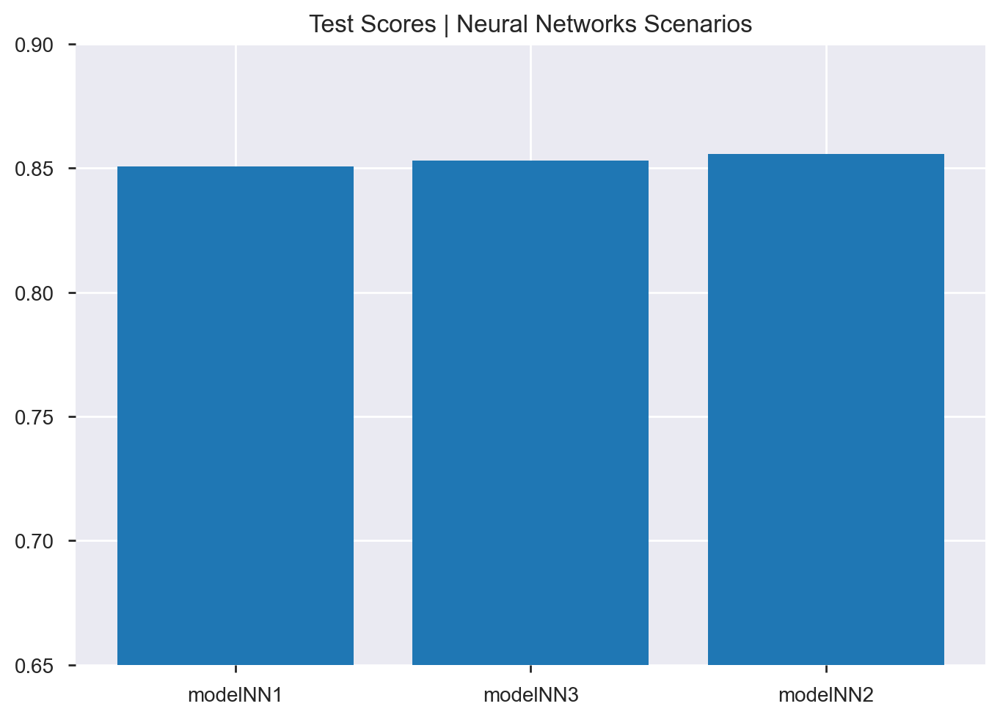

In [804]:
accuracies_NN_test = [score_modelNN1_test, score_modelNN2_test, score_modelNN3_test]
models_NN_test = ['modelNN1', 'modelNN2','modelNN3']
data_tuples = list(zip(models_NN_test ,accuracies_NN_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Neural Networks Scenarios')
plt.ylim(0.65,0.90)
plt.show()

## Decision Tree

### Decision Tree | All Variables

In [519]:
modelDT = DecisionTreeClassifier()
modelDT.fit(X_train, y_train)

DecisionTreeClassifier()

In [520]:
print('Performance: {:.4f}'.format(modelDT.score(X_train,y_train)))

Performance: 0.9820


In [521]:
dot_data = StringIO()
export_graphviz(modelDT, out_file=dot_data,filled=True, rounded=True,special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.470202 to fit



In [ ]:
prob_modelDT = modelDT.predict_proba(X_test)

In [ ]:
labels_train_dt = modelDT.predict(X_train)
labels_test_dt = modelDT.predict(X_test)
labels_test_test_dt = modelDT.predict(X_test_test)

In [ ]:
metric(y_train, labels_train_dt)

In [ ]:
score_modelDT_val = modelDT.score(X_val, y_val)

In [ ]:
cv_modelDT_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelDT_val = cross_val_score(modelDT, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelDT_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelDT_val), std(n_scores_modelDT_val)))

In [ ]:
score_modelDT_test = modelDT.score(X_test, y_test)

In [ ]:
cv_modelDT_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelDT_test = cross_val_score(modelDT, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelDT_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelDT_test), std(n_scores_modelDT_test)))

In [ ]:
def gini(p):
    return (p)*(1 - (p)) + (1 - p)*(1 - (1-p))

def entropy(p):
    return - p*np.log2(p) - (1 - p)*np.log2((1 - p))

def classification_error(p):
    return 1 - np.max([p, 1 - p])

accuracy = metrics.accuracy_score(y_test, labels_test_dt)


x = np.arange(0.0, 1.0, 0.01)
ent = [entropy(accuracy) if accuracy != 0 else None for accuracy in x]
scaled_ent = [e*0.5 if e else None for e in ent]
c_err = [classification_error(i) for i in x]

fig = plt.figure()
ax = plt.subplot(111)

for j, lab, ls, c, in zip(
        [ent, scaled_ent, gini(x), c_err],
        ['Entropy', 'Entropy (scaled)', 'Gini Impurity', 'Misclassification Error'],
        ['-', '-', '--', '-.'],
        ['lightgray', 'red', 'green', 'blue']):
    line = ax.plot(x, j, label=lab, linestyle=ls, lw=1, color=c)

ax.legend(loc='upper left', bbox_to_anchor=(0.01, 0.85),
            ncol=1, fancybox=True, shadow=False)

ax.axhline(y=0.5, linewidth=1, color='k', linestyle='--')
ax.axhline(y=1.0, linewidth=1, color='k', linestyle='--')

plt.ylim([0, 1.1])
plt.xlabel('p(j=1)')
plt.ylabel('Impurity Index')
plt.show()

In [276]:
print('Gini Index: {:.4f}'.format(gini(accuracy)))
print('Entropy Index: {:.4f}'.format(entropy(accuracy)))
print('Classification Error: {:.4f}'.format(classification_error(accuracy)))

Gini Index: 0.2474
Entropy Index: 0.5963
Classification Error: 0.1446


### Decision Tree | Without 'Working Hours per Week' and After chi_square k=10

In [615]:
modelDT2 = DecisionTreeClassifier()
modelDT2.fit(X_train_chi10, y_train)

DecisionTreeClassifier()

In [616]:
print('Performance: {:.4f}'.format(modelDT2.score(X_train_chi10,y_train)))

Performance: 0.8985


In [617]:
dot_data = StringIO()
export_graphviz(modelDT2, out_file=dot_data,filled=True, rounded=True,special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.528747 to fit



In [618]:
prob_modelDT2 = modelDT2.predict_proba(X_test_chi10)

In [619]:
# Predicting the labels for X_test
labels_train_dt2 = modelDT2.predict(X_train_chi10)
labels_test_dt2 = modelDT2.predict(X_test_chi10)
labels_test_test_dt2 = modelDT2.predict(X_test_test_chi10)

In [620]:
metric(y_train, labels_train_dt2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.90      0.97      0.94     10253
           1       0.87      0.67      0.76      3187

    accuracy                           0.90     13440
   macro avg       0.89      0.82      0.85     13440
weighted avg       0.90      0.90      0.89     13440

[[9944  309]
 [1055 2132]]


In [621]:
score_modelDT2_val = modelDT2.score(X_val_chi10, y_val)

In [622]:
cv_modelDT2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelDT2_val = cross_val_score(modelDT2, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelDT2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelDT2_val), std(n_scores_modelDT2_val)))

Accuracy: 0.820 (0.014)


In [623]:
score_modelDT2_test = modelDT2.score(X_test_chi10, y_test)

In [624]:
cv_modelDT2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelDT2_test = cross_val_score(modelDT2, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelDT2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelDT2_test), std(n_scores_modelDT2_test)))

Accuracy: 0.821 (0.016)


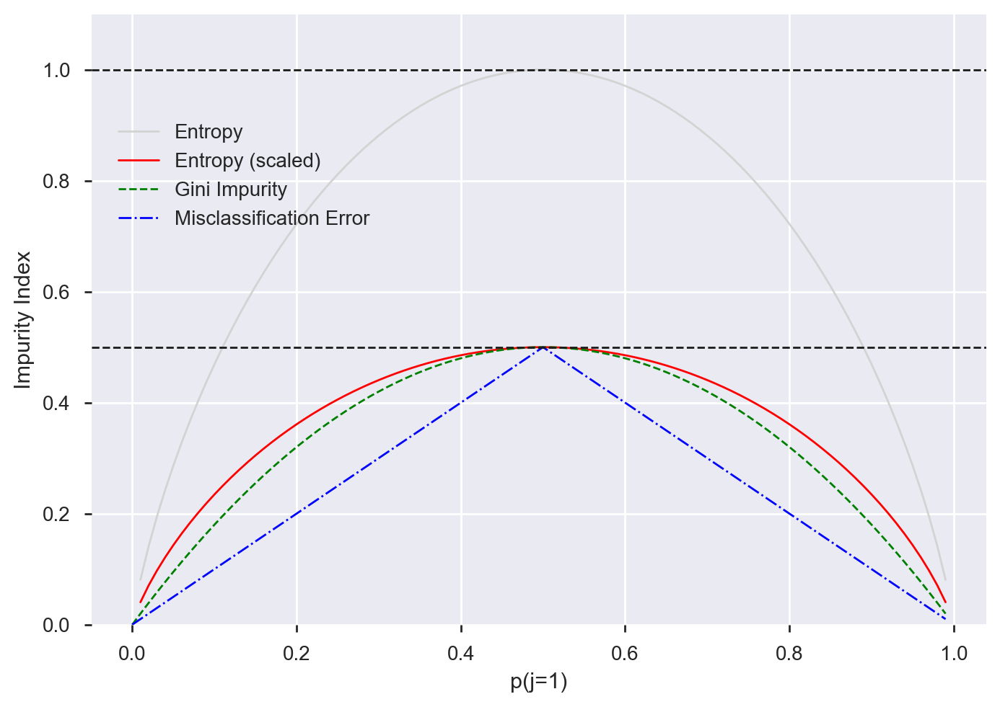

In [625]:
def gini(p):
    return (p)*(1 - (p)) + (1 - p)*(1 - (1-p))

def entropy(p):
    return - p*np.log2(p) - (1 - p)*np.log2((1 - p))

def classification_error(p):
    return 1 - np.max([p, 1 - p])

accuracy = metrics.accuracy_score(y_test, labels_test_dt2)


x = np.arange(0.0, 1.0, 0.01)
ent = [entropy(accuracy) if accuracy != 0 else None for accuracy in x]
scaled_ent = [e*0.5 if e else None for e in ent]
c_err = [classification_error(i) for i in x]

fig = plt.figure()
ax = plt.subplot(111)

for j, lab, ls, c, in zip(
        [ent, scaled_ent, gini(x), c_err],
        ['Entropy', 'Entropy (scaled)', 'Gini Impurity', 'Misclassification Error'],
        ['-', '-', '--', '-.'],
        ['lightgray', 'red', 'green', 'blue']):
    line = ax.plot(x, j, label=lab, linestyle=ls, lw=1, color=c)

ax.legend(loc='upper left', bbox_to_anchor=(0.01, 0.85),
            ncol=1, fancybox=True, shadow=False)

ax.axhline(y=0.5, linewidth=1, color='k', linestyle='--')
ax.axhline(y=1.0, linewidth=1, color='k', linestyle='--')

plt.ylim([0, 1.1])
plt.xlabel('p(j=1)')
plt.ylabel('Impurity Index')
plt.show()

In [626]:
print('Gini Index: {:.4f}'.format(gini(accuracy)))
print('Entropy Index: {:.4f}'.format(entropy(accuracy)))
print('Classification Error: {:.4f}'.format(classification_error(accuracy)))

Gini Index: 0.2679
Entropy Index: 0.6328
Classification Error: 0.1594


### Decision Tree | Tuning Parameters

In [632]:
tree_para = {'criterion':['gini','entropy'],'max_depth':[4,5,6,7,8,9,10,11,12,15,20,30,40,50,70,90,120,150], 'splitter':['random','best'], 'min_samples_split':[3,10,20]}
clf_tree = GridSearchCV(modelDT2, tree_para, cv=10)
clf_tree.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 5, 6, 7, 8, 9, 10, 11, 12, 15, 20, 30,
                                       40, 50, 70, 90, 120, 150],
                         'min_samples_split': [3, 10, 20],
                         'splitter': ['random', 'best']})

In [633]:
clf_tree.best_params_

{'criterion': 'entropy',
 'max_depth': 8,
 'min_samples_split': 20,
 'splitter': 'best'}

In [634]:
#trying with the best parameters
modelDT3 = DecisionTreeClassifier(criterion ='gini',max_depth= 9, min_samples_split=20,splitter='best')
modelDT3.fit(X_train_chi10, y_train)

DecisionTreeClassifier(max_depth=9, min_samples_split=20)

In [635]:
print('Performance: {:.4f}'.format(modelDT3.score(X_train_chi10,y_train)))

Performance: 0.8606


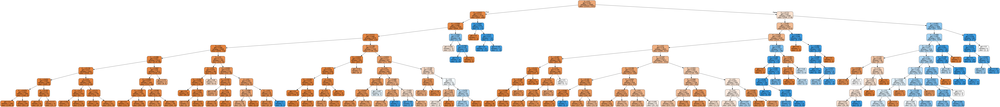

In [636]:
dot_data = StringIO()
export_graphviz(modelDT3, out_file=dot_data,filled=True, rounded=True,special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

In [637]:
prob_modelDT3 = modelDT3.predict_proba(X_test_chi10)

In [638]:
# Predicting the labels for X_test
labels_train_dt3 = modelDT3.predict(X_train_chi10)
labels_test_dt3 = modelDT3.predict(X_test_chi10)
labels_test_test_dt3 = modelDT3.predict(X_test_test_chi10)

In [639]:
metric(y_train, labels_train_dt3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.95      0.91     10253
           1       0.78      0.58      0.66      3187

    accuracy                           0.86     13440
   macro avg       0.83      0.76      0.79     13440
weighted avg       0.85      0.86      0.85     13440

[[9731  522]
 [1351 1836]]


In [640]:
score_modelDT3_val = modelDT3.score(X_val_chi10, y_val)

In [641]:
cv_modelDT3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelDT3_val = cross_val_score(modelDT3, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelDT3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelDT3_val), std(n_scores_modelDT3_val)))

Accuracy: 0.845 (0.016)


In [642]:
score_modelDT3_test = modelDT3.score(X_test_chi10, y_test)

In [643]:
cv_modelDT3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelDT3_test = cross_val_score(modelDT3, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelDT3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelDT3_test), std(n_scores_modelDT3_test)))

Accuracy: 0.848 (0.014)


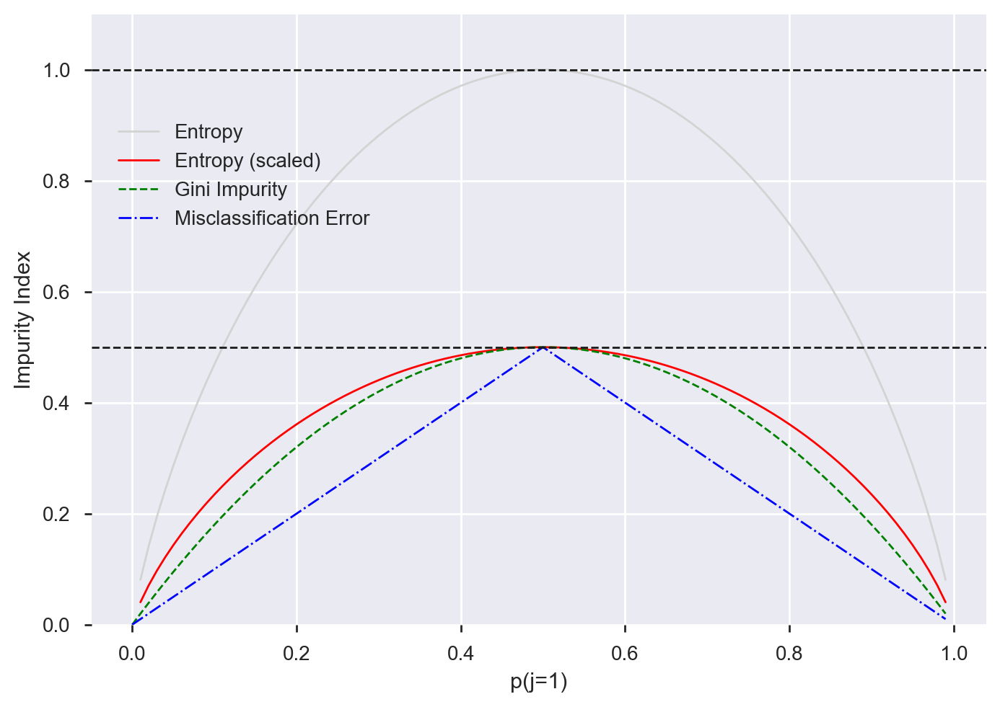

In [301]:
def gini(p):
    return (p)*(1 - (p)) + (1 - p)*(1 - (1-p))

def entropy(p):
    return - p*np.log2(p) - (1 - p)*np.log2((1 - p))

def classification_error(p):
    return 1 - np.max([p, 1 - p])

accuracy = metrics.accuracy_score(y_test, labels_test_dt3)


x = np.arange(0.0, 1.0, 0.01)
ent = [entropy(accuracy) if accuracy != 0 else None for accuracy in x]
scaled_ent = [e*0.5 if e else None for e in ent]
c_err = [classification_error(i) for i in x]

fig = plt.figure()
ax = plt.subplot(111)

for j, lab, ls, c, in zip(
        [ent, scaled_ent, gini(x), c_err],
        ['Entropy', 'Entropy (scaled)', 'Gini Impurity', 'Misclassification Error'],
        ['-', '-', '--', '-.'],
        ['lightgray', 'red', 'green', 'blue']):
    line = ax.plot(x, j, label=lab, linestyle=ls, lw=1, color=c)

ax.legend(loc='upper left', bbox_to_anchor=(0.01, 0.85),
            ncol=1, fancybox=True, shadow=False)

ax.axhline(y=0.5, linewidth=1, color='k', linestyle='--')
ax.axhline(y=1.0, linewidth=1, color='k', linestyle='--')

plt.ylim([0, 1.1])
plt.xlabel('p(j=1)')
plt.ylabel('Impurity Index')
plt.show()

In [302]:
print('Gini Index: {:.4f}'.format(gini(accuracy)))
print('Entropy Index: {:.4f}'.format(entropy(accuracy)))
print('Classification Error: {:.4f}'.format(classification_error(accuracy)))

Gini Index: 0.2465
Entropy Index: 0.5946
Classification Error: 0.1440


### Decision Tree | Model Comparison

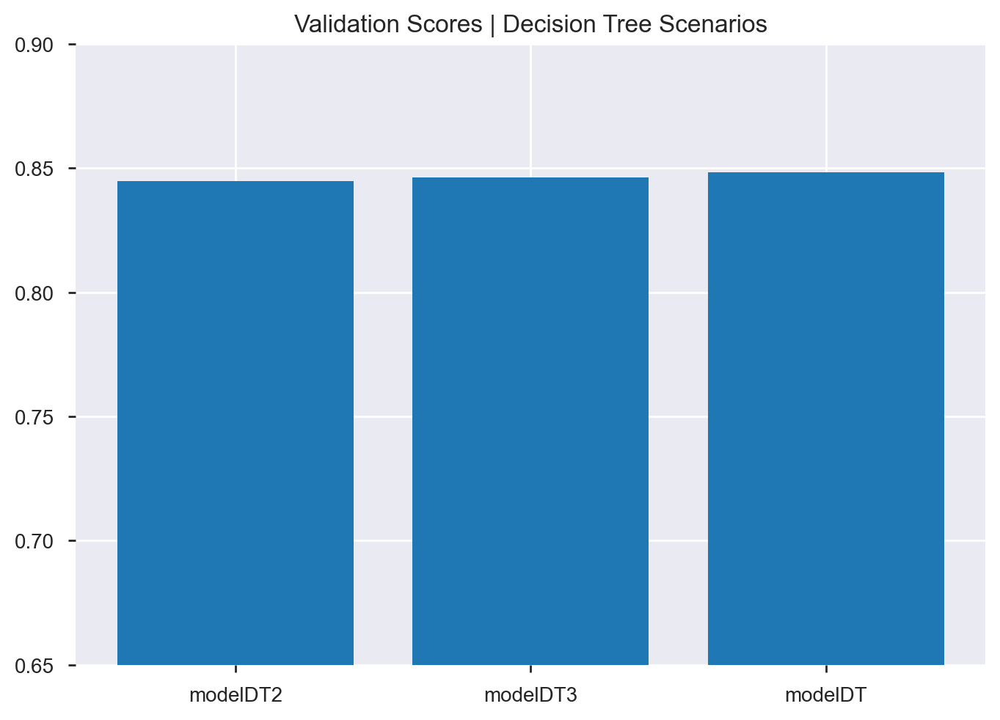

In [303]:
accuracies_DT_val = [score_modelDT_val, score_modelDT2_val,score_modelDT3_val]
models_DT_val = ['modelDT', 'modelDT2','modelDT3' ]
data_tuples = list(zip(models_DT_val ,accuracies_DT_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Decision Tree Scenarios')
plt.ylim(0.65,0.90)
plt.show()

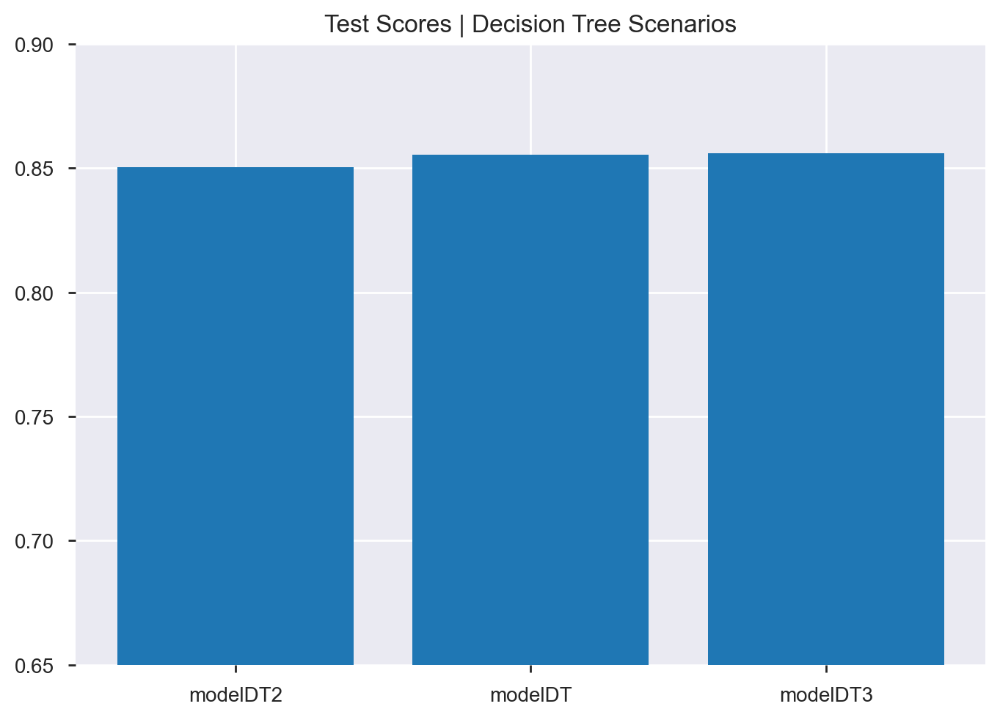

In [304]:
accuracies_DT_test = [score_modelDT_test, score_modelDT2_test, score_modelDT3_test]
models_DT_test = ['modelDT', 'modelDT2','modelDT3']
data_tuples = list(zip(models_DT_test ,accuracies_DT_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Decision Tree Scenarios')
plt.ylim(0.65,0.90)
plt.show()

## Random Forest

### Random Forest | All Variables

In [644]:
#Applying the RandomForest Classifier to the data set oversampled through SMOTE technique
modelRF = RandomForestClassifier(random_state=42, class_weight='balanced')
modelRF.fit(X_train,y_train)

RandomForestClassifier(class_weight='balanced', random_state=42)

In [645]:
prob_modelRF = modelRF.predict_proba(X_test)

In [646]:
# Predicting the labels for X_test, X_train, X_val
labels_train_rf = modelRF.predict(X_train)
labels_test_test_rf = modelRF.predict(X_test_test)

In [647]:
metric(y_train, labels_train_rf)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      0.98      0.99     10253
           1       0.94      0.98      0.96      3187

    accuracy                           0.98     13440
   macro avg       0.97      0.98      0.97     13440
weighted avg       0.98      0.98      0.98     13440

[[10053   200]
 [   55  3132]]


In [648]:
score_modelRF_val = modelRF.score(X_val, y_val)

In [649]:
cv_modelRF_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelRF_val = cross_val_score(modelRF, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelRF_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelRF_val), std(n_scores_modelRF_val)))

Accuracy: 0.838 (0.015)


In [650]:
score_modelRF_test = modelRF.score(X_test, y_test)

In [651]:
cv_modelRF_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelRF_test = cross_val_score(modelRF, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelRF_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelRF_test), std(n_scores_modelRF_test)))

Accuracy: 0.843 (0.014)


### Random Forest | Without 'Working Hours per Week' and After chi_square k=10

In [655]:
#Applying the RandomForest Classifier
modelRF2 = RandomForestClassifier(random_state=42, class_weight='balanced')
modelRF2.fit(X_train_chi10,y_train)

RandomForestClassifier(class_weight='balanced', random_state=42)

In [656]:
prob_modelRF2 = modelRF2.predict_proba(X_test_chi10)

In [657]:
# Predicting the labels for X_test, X_train, X_val
labels_train_rf2 = modelRF2.predict(X_train_chi10)
labels_test_test_rf2 = modelRF2.predict(X_test_test_chi10)

In [658]:
metric(y_train, labels_train_rf2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.97      0.86      0.91     10253
           1       0.66      0.91      0.77      3187

    accuracy                           0.87     13440
   macro avg       0.82      0.88      0.84     13440
weighted avg       0.90      0.87      0.87     13440

[[8774 1479]
 [ 288 2899]]


In [659]:
score_modelRF2_val = modelRF2.score(X_val_chi10, y_val)

In [660]:
cv_modelRF2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelRF2_val = cross_val_score(modelRF2, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelRF2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelRF2_val), std(n_scores_modelRF2_val)))

Accuracy: 0.809 (0.018)


In [661]:
score_modelRF2_test = modelRF2.score(X_test_chi10, y_test)

In [662]:
cv_modelRF2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelRF2_test = cross_val_score(modelRF2, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelRF2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelRF2_test), std(n_scores_modelRF2_test)))

Accuracy: 0.812 (0.014)


### Random Forest | Tuning Parameters

In [321]:
# Tuning the parameters to try to get better performance from the model.
# We will try to have the model with the highest precision through cross validation.
#ATTENTION: it takes 10 minutes to run

parameters = {'max_features':['sqrt', 'log2', 10,20],
              'max_depth':[5,10,20,50],
              'n_estimators':[10,100,200]}

clf_grid = GridSearchCV(modelRF, parameters, n_jobs=-1, cv=5, scoring='accuracy')
clf_grid.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=RandomForestClassifier(class_weight='balanced',
                                              random_state=1),
             n_jobs=-1,
             param_grid={'max_depth': [5, 10, 20, 50],
                         'max_features': ['sqrt', 'log2', 10, 20],
                         'n_estimators': [10, 100, 200]},
             scoring='accuracy')

In [322]:
# Checking the hyperparameters tuned to have the highest precision
clf_grid.best_params_

{'max_depth': 20, 'max_features': 10, 'n_estimators': 200}

In [323]:
#Applying the RandomForest Classifier to the data set oversampled through SMOTE technique
modelRF3 = RandomForestClassifier(n_estimators=200, max_depth=20, max_features=10)
modelRF3.fit(X_train,y_train)

RandomForestClassifier(max_depth=20, max_features=10, n_estimators=200)

In [324]:
prob_modelRF3 = modelRF3.predict_proba(X_test)

In [325]:
# Predicting the labels for X_test, X_train, X_val
labels_train_rf3 = modelRF3.predict(X_train)
labels_test_test_rf3 = modelRF3.predict(X_test_test)

In [326]:
metric(y_train, labels_train_rf3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.98      0.97     10253
           1       0.94      0.88      0.91      3187

    accuracy                           0.96     13440
   macro avg       0.95      0.93      0.94     13440
weighted avg       0.96      0.96      0.96     13440

[[10088   165]
 [  397  2790]]


In [327]:
score_modelRF3_val=modelRF3.score(X_val, y_val)

In [328]:
cv_modelRF3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelRF3_val = cross_val_score(modelRF3, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelRF3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelRF3_val), std(n_scores_modelRF3_val)))

Accuracy: 0.845 (0.017)


In [329]:
score_modelRF3_test=modelRF3.score(X_test, y_test)

In [330]:
cv_modelRF3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelRF3_test = cross_val_score(modelRF3, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelRF3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelRF3_test), std(n_scores_modelRF3_test)))

Accuracy: 0.849 (0.014)


### Random Forest | Model Comparison

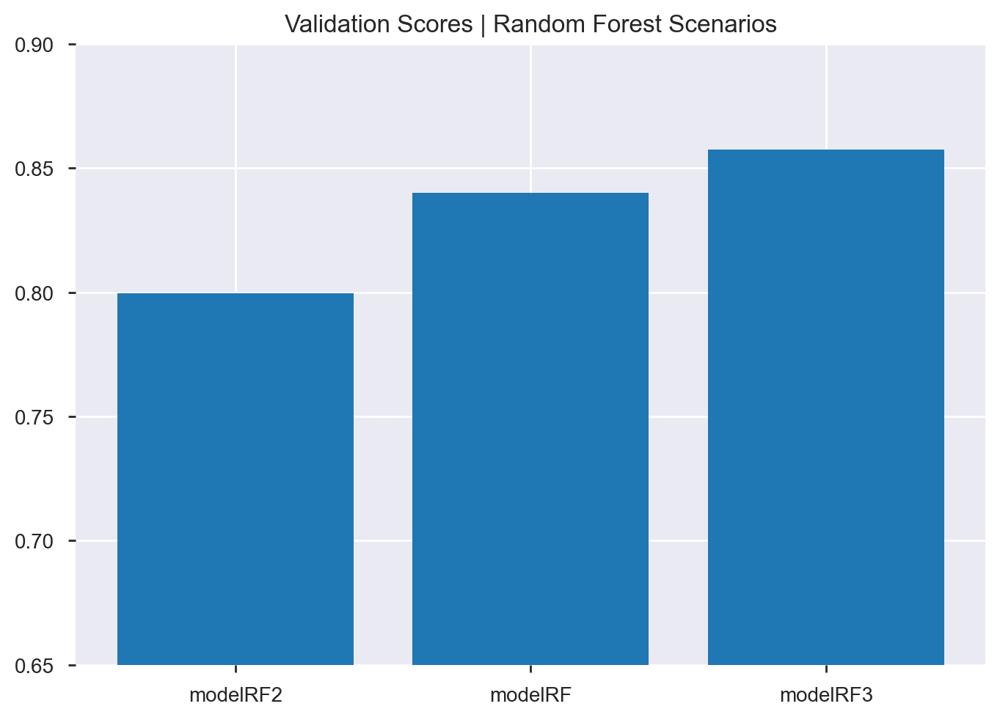

In [663]:
accuracies_RF_val = [score_modelRF_val, score_modelRF2_val, score_modelRF3_val]
models_RF_val = ['modelRF', 'modelRF2', 'modelRF3']
data_tuples = list(zip(models_RF_val ,accuracies_RF_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Random Forest Scenarios')
plt.ylim(0.65,0.90)
plt.show()

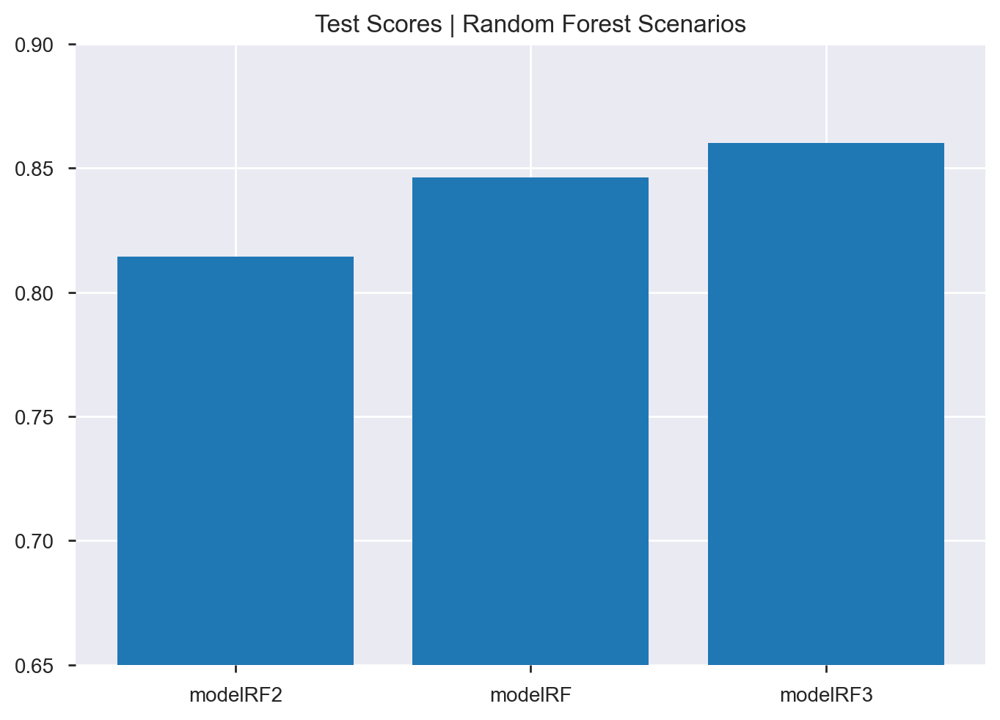

In [664]:
accuracies_RF_test = [score_modelRF_test, score_modelRF2_test,score_modelRF3_test]
models_RF_test = ['modelRF', 'modelRF2', 'modelRF3']
data_tuples = list(zip(models_RF_test ,accuracies_RF_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Random Forest Scenarios')
plt.ylim(0.65,0.90)
plt.show()

## Grandient Boosting

### Gradient Boosting | All Variables 

In [333]:
modelGB1 = GradientBoostingClassifier()
modelGB1.fit(X_train, y_train)

GradientBoostingClassifier()

In [334]:
prob_modelGB1 = modelGB1.predict_proba(X_test)

In [335]:
labels_train_gb1 = modelGB1.predict(X_train)
labels_test_test_gb1 = modelGB1.predict(X_test_test)

In [336]:
metric(y_train, labels_train_gb1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.89      0.95      0.92     10253
           1       0.80      0.61      0.69      3187

    accuracy                           0.87     13440
   macro avg       0.84      0.78      0.81     13440
weighted avg       0.87      0.87      0.87     13440

[[9755  498]
 [1227 1960]]


In [337]:
score_modelGB1_val = modelGB1.score(X_val, y_val)

In [338]:
cv_modelGB1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelGB1_val = cross_val_score(modelGB1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelGB1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelGB1_val), std(n_scores_modelGB1_val)))

Accuracy: 0.855 (0.015)


In [339]:
score_modelGB1_test = modelGB1.score(X_test, y_test)

In [340]:
cv_modelGB1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelGB1_test = cross_val_score(modelGB1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelGB1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelGB1_test), std(n_scores_modelGB1_test)))

Accuracy: 0.862 (0.015)


### Gradient Boosting | Without 'Working Hours per Week' and After chi_square k=10

In [341]:
modelGB2 = GradientBoostingClassifier()
modelGB2.fit(X_train_chi10, y_train)

GradientBoostingClassifier()

In [342]:
prob_modelGB2 = modelGB2.predict_proba(X_test_chi10)

In [343]:
labels_train_gb2 = modelGB2.predict(X_train_chi10)
labels_test_test_gb2 = modelGB2.predict(X_test_test_chi10)

In [344]:
metric(y_train, labels_train_gb2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.95      0.92     10253
           1       0.80      0.59      0.68      3187

    accuracy                           0.87     13440
   macro avg       0.84      0.77      0.80     13440
weighted avg       0.86      0.87      0.86     13440

[[9782  471]
 [1320 1867]]


In [345]:
score_modelGB2_val = modelGB2.score(X_val_chi10, y_val)

In [346]:
cv_modelGB2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelGB2_val = cross_val_score(modelGB2, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelGB2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelGB2_val), std(n_scores_modelGB2_val)))

Accuracy: 0.854 (0.014)


In [347]:
score_modelGB2_test = modelGB2.score(X_test_chi10, y_test)

In [348]:
cv_modelGB2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelGB2_test = cross_val_score(modelGB2, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelGB2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelGB2_test), std(n_scores_modelGB2_test)))

Accuracy: 0.861 (0.016)


### Gradient Boosting | Tuning Parameters

In [349]:
modelGB3 = GradientBoostingClassifier(learning_rate=0.23, n_estimators=120)
modelGB3.fit(X_train, y_train)

GradientBoostingClassifier(learning_rate=0.23, n_estimators=120)

In [350]:
prob_modelGB3 = modelGB3.predict_proba(X_test)

In [351]:
labels_train_gb3 = modelGB3.predict(X_train)
labels_test_gb3 = modelGB3.predict(X_test)
labels_test_test_gb3 = modelGB3.predict(X_test_test)

In [352]:
metric(y_train, labels_train_gb3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.90      0.95      0.92     10253
           1       0.80      0.66      0.73      3187

    accuracy                           0.88     13440
   macro avg       0.85      0.81      0.83     13440
weighted avg       0.88      0.88      0.88     13440

[[9738  515]
 [1076 2111]]


In [353]:
score_modelGB3_val=modelGB3.score(X_val, y_val)

In [354]:
cv_modelGB3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelGB3_val = cross_val_score(modelGB3, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelGB3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelGB3_val), std(n_scores_modelGB3_val)))

Accuracy: 0.857 (0.016)


In [355]:
score_modelGB3_test=modelGB3.score(X_test, y_test)

In [356]:

cv_modelGB3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelGB3_test = cross_val_score(modelGB3, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelGB3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelGB3_test), std(n_scores_modelGB3_test)))

Accuracy: 0.863 (0.015)


In [357]:
from sklearn.metrics import classification_report

print("Recall:",metrics.recall_score(y_test, labels_test_gb3))
print("Accuracy:",metrics.accuracy_score(y_test, labels_test_gb3))
print("ROC_AUC:",metrics.roc_auc_score(y_test, labels_test_gb3))
print("F1 score:",metrics.f1_score(y_test, labels_test_gb3))

Recall: 0.6318267419962336
Accuracy: 0.8732142857142857
ROC_AUC: 0.7900210362994626
F1 score: 0.7026178010471205


### Gradient Boosting Decision Tree | Tuning Parameters

In [367]:
parameters = {'min_samples_split' : range(10,500,20),'max_depth': range(1,20,2)}
clf_GBDT = DecisionTreeClassifier()
clfGBDT = GridSearchCV(clf_GBDT,parameters)
clfGBDT.fit(X_train, y_train)

GridSearchCV(estimator=DecisionTreeClassifier(),
             param_grid={'max_depth': range(1, 20, 2),
                         'min_samples_split': range(10, 500, 20)})

In [368]:
# Checking the hyperparameters tuned to have the highest precision
clfGBDT.best_params_

{'max_depth': 17, 'min_samples_split': 110}

In [369]:
modelGBDT1 = GradientBoostingClassifier(max_depth = 17, min_samples_split = 110)
modelGBDT1.fit(X_train, y_train)

GradientBoostingClassifier(max_depth=17, min_samples_split=110)

In [370]:
labels_train_gbdt1 = modelGBDT1.predict(X_train)
labels_test_test_gbdt1 = modelGBDT1.predict(X_test_test)

In [371]:
prob_modelGBDT1 = modelGBDT1.predict_proba(X_test)

In [372]:
metric(y_train, labels_train_gbdt1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.97      0.96     10253
           1       0.91      0.85      0.88      3187

    accuracy                           0.94     13440
   macro avg       0.93      0.91      0.92     13440
weighted avg       0.94      0.94      0.94     13440

[[9989  264]
 [ 491 2696]]


In [373]:
score_modelGBDT1_val=modelGBDT1.score(X_val, y_val)

In [374]:
cv_modelGBDT1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelGBDT1_val = cross_val_score(modelGBDT1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelGBDT1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelGBDT1_val), std(n_scores_modelGBDT1_val)))

Accuracy: 0.840 (0.018)


In [375]:
score_modelGBDT1_test=modelGBDT1.score(X_test, y_test)

In [376]:
cv_modelGBDT1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelGBDT1_test = cross_val_score(modelGBDT1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelGBDT1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelGBDT1_test), std(n_scores_modelGBDT1_test)))

Accuracy: 0.853 (0.017)


### Gradient Boosting Decision Tree | Manual Tuning 

In [805]:
modelGBDT = GradientBoostingClassifier(n_estimators=75, learning_rate=0.2, max_depth=11, max_features=42, min_samples_split =0.5, random_state=40)
modelGBDT.fit(X_train, y_train)

GradientBoostingClassifier(learning_rate=0.2, max_depth=11, max_features=42,
                           min_samples_split=0.5, n_estimators=75,
                           random_state=40)

In [806]:
labels_train_gbdt = modelGBDT.predict(X_train)
labels_test_gbdt = modelGBDT.predict(X_test)
labels_test_test_gbdt = modelGBDT.predict(X_test_test)

In [807]:
prob_modelGBDT = modelGBDT.predict_proba(X_test)

In [808]:
metric(y_train, labels_train_gbdt)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.90      0.94      0.92     10253
           1       0.78      0.66      0.72      3187

    accuracy                           0.88     13440
   macro avg       0.84      0.80      0.82     13440
weighted avg       0.87      0.88      0.87     13440

[[9651  602]
 [1071 2116]]


In [809]:
score_modelGBDT_val=modelGBDT.score(X_val, y_val)

In [827]:
cv_modelGBDT_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelGBDT_val = cross_val_score(modelGBDT, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelGBDT_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelGBDT_val), std(n_scores_modelGBDT_val)))

Accuracy: 0.859 (0.014)


In [828]:
score_modelGBDT_test=modelGBDT.score(X_test, y_test)

In [829]:
cv_modelGBDT_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelGBDT_test = cross_val_score(modelGBDT, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelGBDT_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelGBDT_test), std(n_scores_modelGBDT_test)))

Accuracy: 0.869 (0.014)


In [830]:
from sklearn.metrics import classification_report

print("Recall:",metrics.recall_score(y_test, labels_test_gbdt))
print("Accuracy:",metrics.accuracy_score(y_test, labels_test_gbdt))
print("ROC_AUC:",metrics.roc_auc_score(y_test, labels_test_gbdt))
print("F1 score:",metrics.f1_score(y_test, labels_test_gbdt))

Recall: 0.6516007532956686
Accuracy: 0.8729910714285715
ROC_AUC: 0.7966897856589519
F1 score: 0.7086533538146441


### Gradient Boosting |  Model Comparison

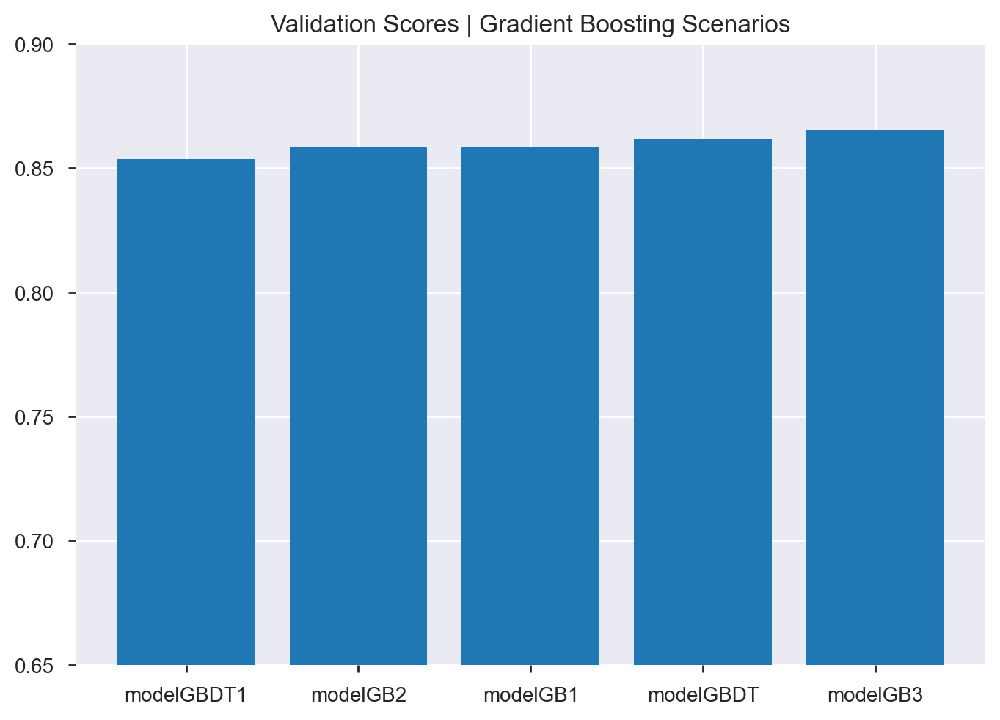

In [831]:
accuracies_GB_val = [score_modelGB1_val, score_modelGB2_val, score_modelGB3_val, score_modelGBDT_val, score_modelGBDT1_val]
models_GB_val = ['modelGB1', 'modelGB2', 'modelGB3', 'modelGBDT', 'modelGBDT1']
data_tuples = list(zip(models_GB_val ,accuracies_GB_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Gradient Boosting Scenarios')
plt.ylim(0.65,0.90)
plt.show()

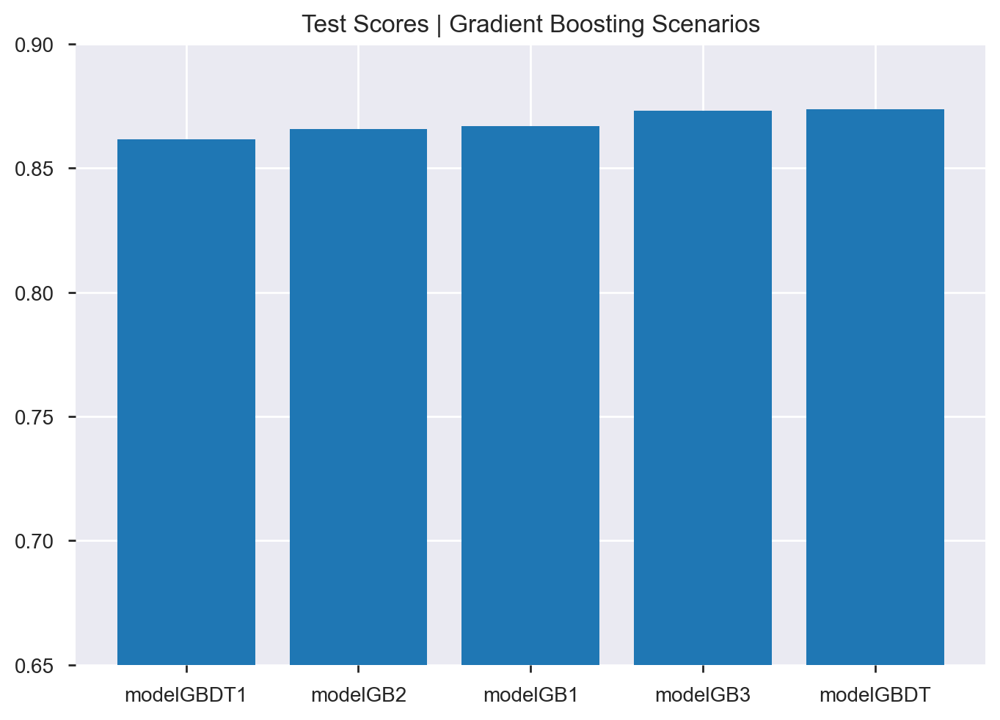

In [690]:
accuracies_GB_test = [score_modelGB1_test, score_modelGB2_test, score_modelGB3_test, score_modelGBDT_test, score_modelGBDT1_test]
models_GB_test = ['modelGB1', 'modelGB2', 'modelGB3', 'modelGBDT', 'modelGBDT1']
data_tuples = list(zip(models_GB_test,accuracies_GB_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Gradient Boosting Scenarios')
plt.ylim(0.65,0.90)
plt.show()

## AdaBoost

### AdaBoost | All Variables

In [379]:
modelAB1 = AdaBoostClassifier()
modelAB1.fit(X_train, y_train)

AdaBoostClassifier()

In [380]:
prob_modelAB1 = modelAB1.predict_proba(X_test)

In [381]:
labels_train_ab1 = modelAB1.predict(X_train)
labels_test_test_ab1 = modelAB1.predict(X_test_test)

In [382]:
metric(y_train, labels_train_ab1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.94      0.91     10253
           1       0.75      0.60      0.67      3187

    accuracy                           0.86     13440
   macro avg       0.82      0.77      0.79     13440
weighted avg       0.85      0.86      0.85     13440

[[9620  633]
 [1261 1926]]


In [383]:
score_modelAB1_val = modelAB1.score(X_val, y_val)

In [384]:
cv_modelAB1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelAB1_val = cross_val_score(modelAB1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelAB1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelAB1_val), std(n_scores_modelAB1_val)))

Accuracy: 0.850 (0.013)


In [385]:
score_modelAB1_test = modelAB1.score(X_test, y_test)

In [386]:
cv_modelAB1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelAB1_test = cross_val_score(modelAB1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelAB1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelAB1_test), std(n_scores_modelAB1_test)))

Accuracy: 0.859 (0.014)


### AdaBoost | Without 'Working Hours per Week' and After chi_square k=10

In [387]:
modelAB2 = AdaBoostClassifier()
modelAB2.fit(X_train_chi10, y_train)

AdaBoostClassifier()

In [388]:
prob_modelAB2 = modelAB2.predict_proba(X_test_chi10)

In [389]:
labels_train_ab2 = modelAB2.predict(X_train_chi10)
labels_test_test_ab2 = modelAB2.predict(X_test_test_chi10)

In [390]:
metric(y_train, labels_train_ab2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.94      0.91     10253
           1       0.76      0.58      0.66      3187

    accuracy                           0.86     13440
   macro avg       0.82      0.76      0.78     13440
weighted avg       0.85      0.86      0.85     13440

[[9685  568]
 [1353 1834]]


In [391]:
score_modelAB2_val = modelAB2.score(X_val_chi10, y_val)

In [392]:
cv_modelAB2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelAB2_val = cross_val_score(modelAB2, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelAB2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelAB2_val), std(n_scores_modelAB2_val)))

Accuracy: 0.852 (0.015)


In [393]:
score_modelAB2_test = modelAB2.score(X_test_chi10, y_test)

In [394]:
cv_modelAB2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelAB2_test = cross_val_score(modelAB2, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelAB2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelAB2_test), std(n_scores_modelAB2_test)))

Accuracy: 0.858 (0.015)


### AdaBoost | Tuning Parameters

In [395]:
modelAB3 = AdaBoostClassifier(n_estimators=350, learning_rate=0.8)
modelAB3.fit(X_train, y_train)

AdaBoostClassifier(learning_rate=0.8, n_estimators=350)

In [396]:
prob_modelAB3 = modelAB3.predict_proba(X_test)

In [397]:
labels_train_ab3 = modelAB3.predict(X_train)
labels_test_test_ab3 = modelAB3.predict(X_test_test)

In [398]:
metric(y_train, labels_train_ab3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.89      0.94      0.92     10253
           1       0.77      0.63      0.69      3187

    accuracy                           0.87     13440
   macro avg       0.83      0.79      0.81     13440
weighted avg       0.86      0.87      0.86     13440

[[9665  588]
 [1180 2007]]


In [399]:
score_modelAB3_val=modelAB3.score(X_val, y_val)

In [400]:
cv_modelAB3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelAB3_val = cross_val_score(modelAB3, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelAB3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelAB3_val), std(n_scores_modelAB3_val)))

Accuracy: 0.857 (0.012)


In [401]:
score_modelAB3_test=modelAB3.score(X_test, y_test)

In [402]:
cv_modelAB3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelAB3_test = cross_val_score(modelAB3, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelAB3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelAB3_test), std(n_scores_modelAB3_test)))

Accuracy: 0.864 (0.015)


### AdaBoost |  Model Comparison

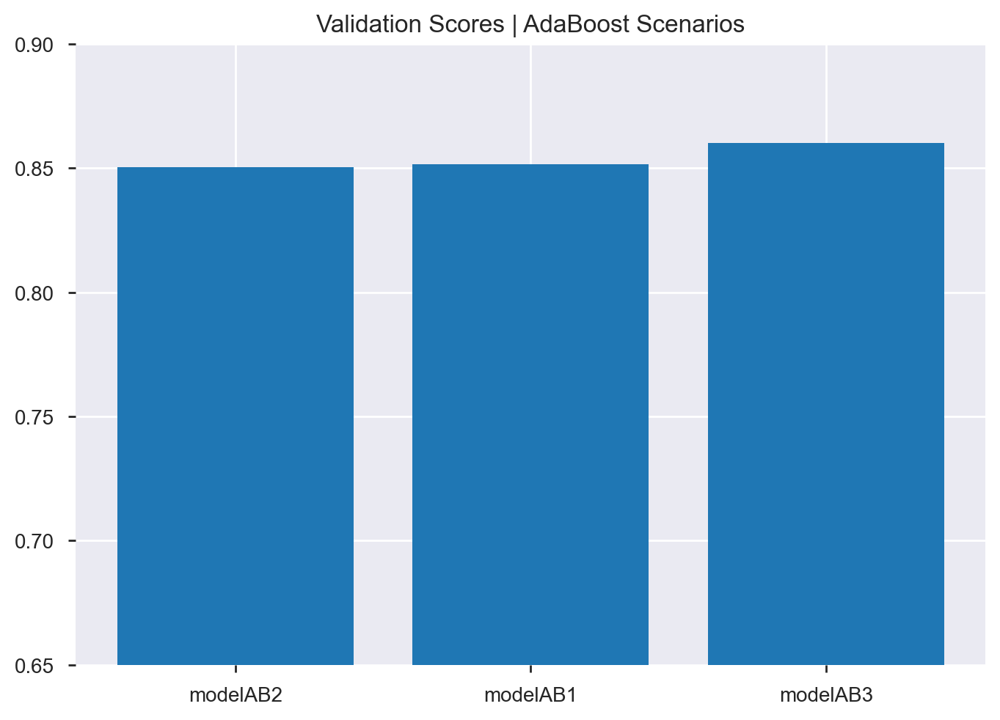

In [403]:
accuracies_AB_val = [score_modelAB1_val, score_modelAB2_val, score_modelAB3_val]
models_AB_val = ['modelAB1', 'modelAB2','modelAB3']
data_tuples = list(zip(models_AB_val ,accuracies_AB_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | AdaBoost Scenarios')
plt.ylim(0.65,0.90)
plt.show()

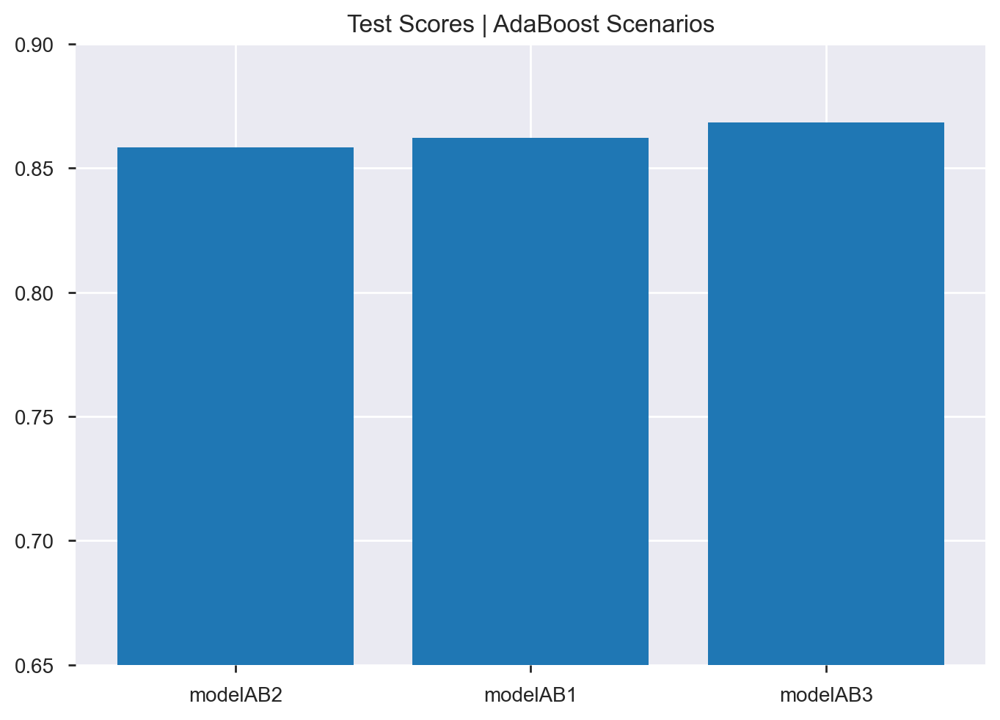

In [404]:
accuracies_AB_test = [score_modelAB1_test, score_modelAB2_test, score_modelAB3_test]
models_AB_test = ['modelAB1', 'modelAB2', 'modelAB3']
data_tuples = list(zip(models_AB_test ,accuracies_AB_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | AdaBoost Scenarios')
plt.ylim(0.65,0.90)
plt.show()

## Support Vector Machine

### Support Vector Machine | All Variables 

In [405]:
modelSVM1 = SVC(probability=True)
modelSVM1.fit(X_train, y_train)

SVC(probability=True)

In [406]:
prob_modelSVM1 = modelSVM1.predict_proba(X_test)

In [407]:
labels_train_svm1 = modelSVM1.predict(X_train)
labels_test_test_svm1 = modelSVM1.predict(X_test_test)

In [408]:
metric(y_train, labels_train_svm1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.93      0.90     10253
           1       0.72      0.59      0.65      3187

    accuracy                           0.85     13440
   macro avg       0.80      0.76      0.78     13440
weighted avg       0.84      0.85      0.84     13440

[[9514  739]
 [1293 1894]]


In [409]:
score_modelSVM1_val = modelSVM1.score(X_val, y_val)

In [410]:
cv_modelSVM1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelSVM1_val = cross_val_score(modelSVM1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelSVM1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelSVM1_val), std(n_scores_modelSVM1_val)))

Accuracy: 0.827 (0.014)


In [411]:
score_modelSVM1_test = modelSVM1.score(X_test, y_test)

In [412]:
cv_modelSVM1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelSVM1_test = cross_val_score(modelSVM1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelSVM1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelSVM1_test), std(n_scores_modelSVM1_test)))

Accuracy: 0.831 (0.013)


### Support Vector Machine | Without 'Working Hours per Week' and After chi_square k=10

In [413]:
modelSVM2 = SVC(probability=True)
modelSVM2.fit(X_train_chi10, y_train)

SVC(probability=True)

In [414]:
prob_modelSVM2 = modelSVM2.predict_proba(X_test_chi10)

In [415]:
labels_train_svm2 = modelSVM2.predict(X_train_chi10)
labels_test_test_svm2 = modelSVM2.predict(X_test_test_chi10)

In [416]:
metric(y_train, labels_train_svm2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.87      0.92      0.90     10253
           1       0.70      0.57      0.63      3187

    accuracy                           0.84     13440
   macro avg       0.79      0.75      0.76     13440
weighted avg       0.83      0.84      0.83     13440

[[9483  770]
 [1385 1802]]


In [417]:
score_modelSVM2_val = modelSVM2.score(X_val_chi10, y_val)

In [418]:
cv_modelSVM2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelSVM2_val = cross_val_score(modelSVM2, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelSVM2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelSVM2_val), std(n_scores_modelSVM2_val)))

Accuracy: 0.819 (0.016)


In [419]:
score_modelSVM2_test = modelSVM2.score(X_test_chi10, y_test)

In [420]:
cv_modelSVM2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelSVM2_test = cross_val_score(modelSVM2, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelSVM2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelSVM2_test), std(n_scores_modelSVM2_test)))

Accuracy: 0.836 (0.015)


### Support Vector Machine | Tuning Parameters

In [421]:
modelSVM3 = SVC(kernel='linear',probability=True)
modelSVM3.fit(X_train_chi10, y_train)

SVC(kernel='linear', probability=True)

In [422]:
prob_modelSVM3 = modelSVM3.predict_proba(X_test_chi10)

In [423]:
labels_train_svm3 = modelSVM3.predict(X_train_chi10)
labels_test_test_svm3 = modelSVM3.predict(X_test_test_chi10)

In [424]:
metric(y_train, labels_train_svm3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.87      0.93      0.90     10253
           1       0.72      0.55      0.62      3187

    accuracy                           0.84     13440
   macro avg       0.79      0.74      0.76     13440
weighted avg       0.83      0.84      0.83     13440

[[9558  695]
 [1441 1746]]


In [425]:
score_modelSVM3_val=modelSVM3.score(X_val_chi10, y_val)

In [426]:
cv_modelSVM3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelSVM3_val = cross_val_score(modelSVM3, X_val_chi10, y_val, scoring='accuracy', 
                                   cv=cv_modelSVM3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelSVM3_val), std(n_scores_modelSVM3_val)))

Accuracy: 0.829 (0.015)


In [427]:
score_modelSVM3_test=modelSVM3.score(X_test_chi10, y_test)

In [428]:
cv_modelSVM3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelSVM3_test = cross_val_score(modelSVM3, X_test_chi10, y_test, scoring='accuracy', 
                                   cv=cv_modelSVM3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelSVM3_test), std(n_scores_modelSVM3_test)))

Accuracy: 0.841 (0.014)


### Support Vector Machine |  Model Comparison

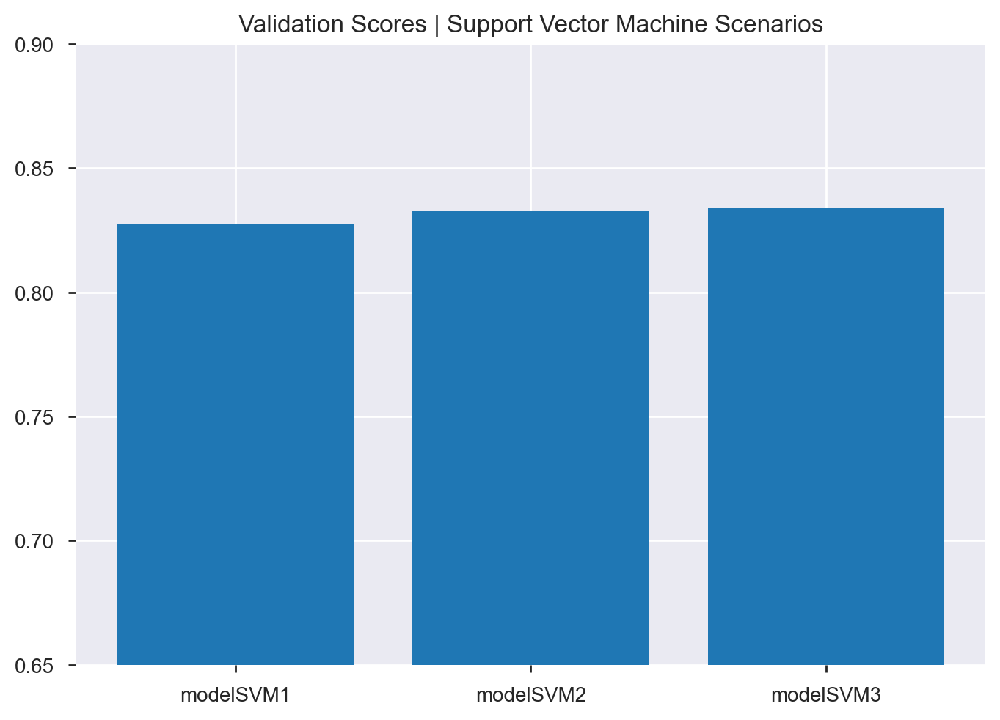

In [429]:
accuracies_SVM_val = [score_modelSVM1_val, score_modelSVM2_val, score_modelSVM3_val]
models_SVM_val = ['modelSVM1', 'modelSVM2','modelSVM3']
data_tuples = list(zip(models_SVM_val ,accuracies_SVM_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Support Vector Machine Scenarios')
plt.ylim(0.65,0.90)
plt.show()

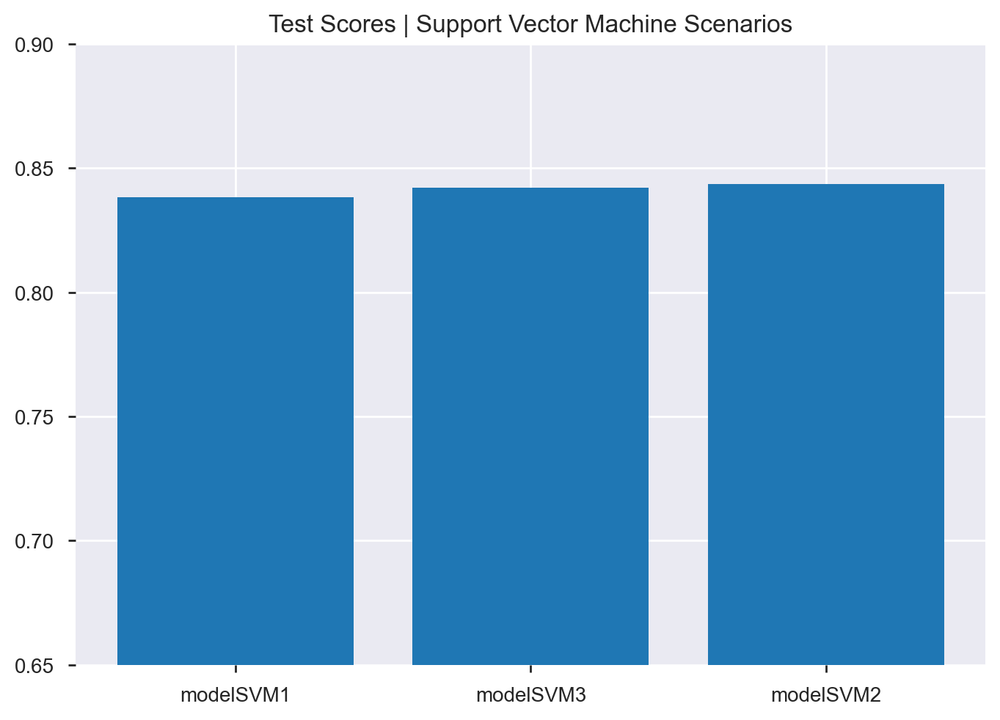

In [430]:
accuracies_SVM_test = [score_modelSVM1_test, score_modelSVM2_test, score_modelSVM3_test]
models_SVM_test = ['modelSVM1', 'modelSVM2', 'modelSVM3']
data_tuples = list(zip(models_SVM_test ,accuracies_SVM_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Support Vector Machine Scenarios')
plt.ylim(0.65,0.90)
plt.show()

# Best Model Comparison

## ROC Curve 

In [701]:
fpr_NB4, tpr_NB4, thresholds_NB4 = roc_curve(y_test, prob_modelNB4[:, 1])
fpr_LR5, tpr_LR5, thresholds_LR5 = roc_curve(y_test, prob_modelLR5[:, 1])
fpr_LDA1, tpr_LDA1, thresholds_LDA1 = roc_curve(y_test, prob_modelLDA1[:, 1])
fpr_KNN4, tpr_KNN4, thresholds_KNN4 = roc_curve(y_test, prob_modelKNN4[:, 1])
fpr_NN3, tpr_NN3, thresholds_NN3 = roc_curve(y_test, prob_modelNN3[:, 1])
fpr_DT2, tpr_DT2, thresholds_DT3 = roc_curve(y_test, prob_modelDT3[:, 1])
fpr_RF3, tpr_RF3, thresholds_RF3 = roc_curve(y_test, prob_modelRF3[:, 1])
fpr_GB3, tpr_GB3, thresholds_GB3 = roc_curve(y_test, prob_modelGB3[:, 1])
fpr_GBDT, tpr_GBDT, thresholds_GBDT = roc_curve(y_test, prob_modelGBDT[:, 1])
fpr_AB3, tpr_AB3, thresholds_AB3 = roc_curve(y_test, prob_modelAB3[:, 1])
fpr_SVM3, tpr_SVM3, thresholds_SVM3 = roc_curve(y_test, prob_modelSVM3[:, 1])

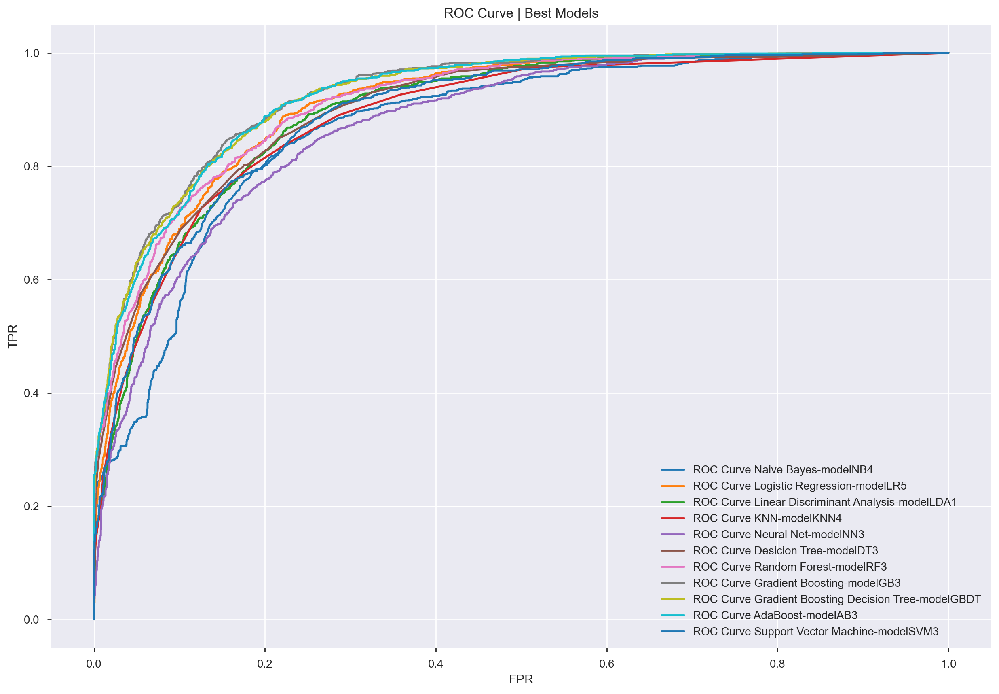

In [702]:
plt.figure(figsize=(15, 10))
plt.plot(fpr_NB4, tpr_NB4,label="ROC Curve Naive Bayes-modelNB4")
plt.plot(fpr_LR5, tpr_LR5,label="ROC Curve Logistic Regression-modelLR5")
plt.plot(fpr_LDA1, tpr_LDA1,label="ROC Curve Linear Discriminant Analysis-modelLDA1")
plt.plot(fpr_KNN4, tpr_KNN4,label="ROC Curve KNN-modelKNN4")
plt.plot(fpr_NN3, tpr_NN3,label="ROC Curve Neural Net-modelNN3")
plt.plot(fpr_DT3, tpr_DT3,label="ROC Curve Desicion Tree-modelDT3")
plt.plot(fpr_RF3, tpr_RF3,label="ROC Curve Random Forest-modelRF3")
plt.plot(fpr_GB3, tpr_GB3,label="ROC Curve Gradient Boosting-modelGB3")
plt.plot(fpr_GBDT, tpr_GBDT,label="ROC Curve Gradient Boosting Decision Tree-modelGBDT")
plt.plot(fpr_AB3, tpr_AB3,label="ROC Curve AdaBoost-modelAB3")
plt.plot(fpr_SVM3, tpr_SVM3,label="ROC Curve Support Vector Machine-modelSVM3")
plt.title('ROC Curve | Best Models')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.legend()
plt.show()

#plt.savefig('ROC.pdf')

## Accuracy

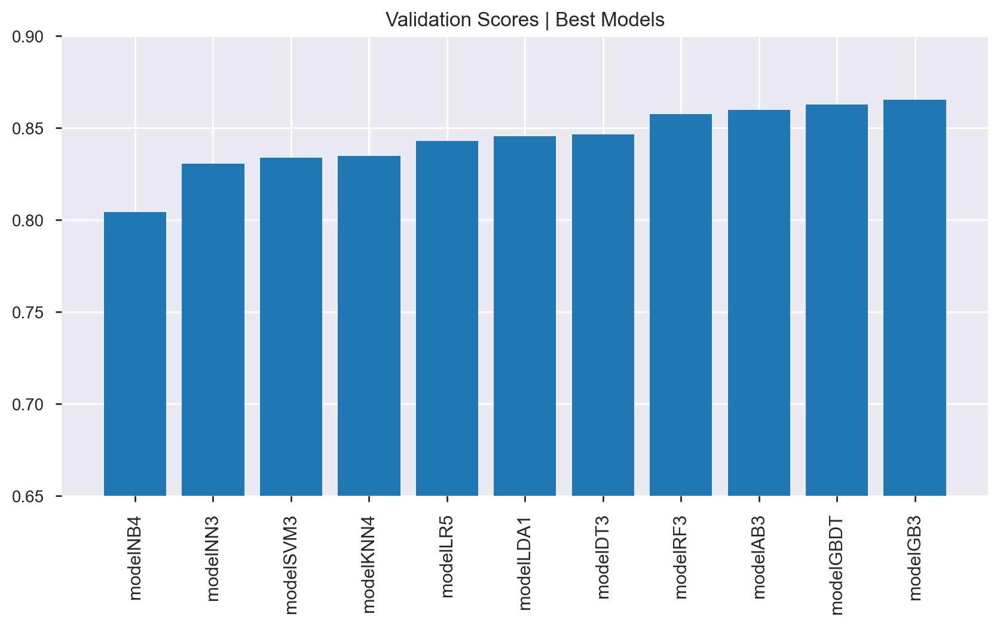

In [705]:
accuracies_val = [score_modelNB4_val, score_modelLR5_val, score_modelLDA1_val,
                 score_modelKNN4_val, score_modelNN3_val, score_modelDT3_val,
                 score_modelRF3_val, score_modelGB3_val,score_modelGBDT_val, score_modelAB3_val, score_modelSVM3_val]
models_val = ['modelNB4', 'modelLR5', 'modelLDA1',
              'modelKNN4', 'modelNN3', 'modelDT3',
              'modelRF3', 'modelGB3','modelGBDT', 'modelAB3', 'modelSVM3']
data_tuples = list(zip(models_val ,accuracies_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.figure(figsize=(10, 5))
plt.bar(data[0], data[1])
plt.title('Validation Scores | Best Models')
plt.ylim(0.65,0.90)
plt.xticks(fontsize=11, rotation=90)
plt.show()

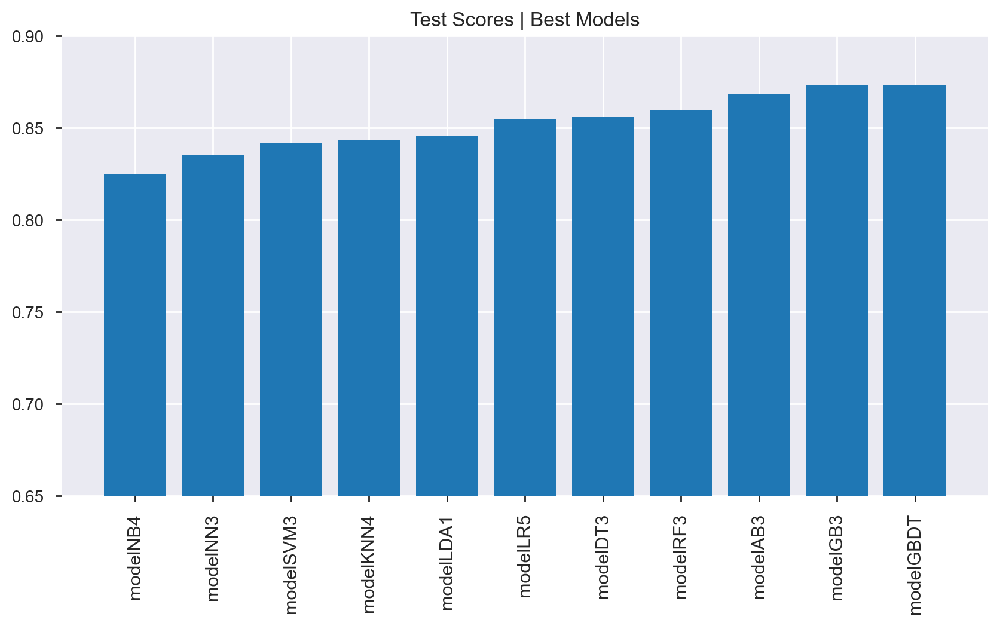

In [704]:
accuracies_test = [score_modelNB4_test, score_modelLR5_test, score_modelLDA1_test,
                 score_modelKNN4_test, score_modelNN3_test, score_modelDT3_test, score_modelGBDT_test,
                 score_modelRF3_test, score_modelGB3_test, score_modelAB3_test, score_modelSVM3_test]
models_test = ['modelNB4', 'modelLR5', 'modelLDA1',
              'modelKNN4', 'modelNN3', 'modelDT3','modelGBDT',
              'modelRF3', 'modelGB3', 'modelAB3', 'modelSVM3']
data_tuples = list(zip(models_test ,accuracies_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.figure(figsize=(10, 5))
plt.bar(data[0], data[1])
plt.title('Test Scores | Best Models')
plt.ylim(0.65,0.90)
plt.xticks(fontsize=11, rotation=90)
plt.show()

## Bagging

### Bagging KNN | All Variables 

In [435]:
bagging_KNN = BaggingClassifier(base_estimator = modelKNN4, random_state = 5)
bagging_KNN.fit(X = X_train, y = y_train)

BaggingClassifier(base_estimator=KNeighborsClassifier(leaf_size=40,
                                                      n_neighbors=15, p=1),
                  random_state=5)

In [436]:
labels_train_bagging_knn = bagging_KNN.predict(X_train)
labels_test_test_bagging_knn = bagging_KNN.predict(X_test_test)

In [437]:
prob_bagging_KNN = bagging_KNN.predict_proba(X_test)

In [438]:
metric(y_train, labels_train_bagging_knn)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.89      0.93      0.91     10253
           1       0.73      0.62      0.67      3187

    accuracy                           0.86     13440
   macro avg       0.81      0.77      0.79     13440
weighted avg       0.85      0.86      0.85     13440

[[9531  722]
 [1211 1976]]


In [439]:
score_bagging_knn_val = bagging_KNN.score(X_val, y_val)

In [440]:
cv_bagging_knn_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_bagging_knn_val = cross_val_score(bagging_KNN, X_val, y_val, scoring='accuracy', 
                                   cv=cv_bagging_knn_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_bagging_knn_val), std(n_scores_bagging_knn_val)))

Accuracy: 0.827 (0.015)


In [441]:
score_bagging_knn_test = bagging_KNN.score(X_test, y_test)

In [442]:
cv_bagging_knn_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_bagging_knn_test = cross_val_score(bagging_KNN, X_test, y_test, scoring='accuracy', 
                                   cv=cv_bagging_knn_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_bagging_knn_test), std(n_scores_bagging_knn_test)))

Accuracy: 0.835 (0.013)


### Bagging Logistic Regression | All Variables 

In [443]:
bagging_LR = BaggingClassifier(base_estimator = modelLR5 , random_state = 5)
bagging_LR.fit(X = X_train, y = y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_

BaggingClassifier(base_estimator=LogisticRegression(C=10000), random_state=5)

In [444]:
prob_bagging_LR = bagging_LR.predict_proba(X_test)

In [445]:
labels_train_bagging_lr = bagging_LR.predict(X_train)
labels_test_bagging_lr = bagging_LR.predict(X_test_test)

In [446]:
metric(y_train, labels_train_bagging_lr)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.94      0.91     10253
           1       0.74      0.59      0.66      3187

    accuracy                           0.85     13440
   macro avg       0.81      0.76      0.78     13440
weighted avg       0.85      0.85      0.85     13440

[[9597  656]
 [1306 1881]]


In [447]:
score_bagging_lr_val = bagging_LR.score(X_val, y_val)

In [448]:
cv_bagging_LR_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_bagging_LR_val = cross_val_score(bagging_LR, X_val, y_val, scoring='accuracy', 
                                   cv=cv_bagging_LR_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_bagging_LR_val), std(n_scores_bagging_LR_val)))

Accuracy: 0.844 (0.015)


In [449]:
score_bagging_lr_test = bagging_LR.score(X_test, y_test)

In [450]:
cv_bagging_LR_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_bagging_LR_test = cross_val_score(bagging_LR, X_test, y_test, scoring='accuracy', 
                                   cv=cv_bagging_LR_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_bagging_LR_test), std(n_scores_bagging_LR_test)))

Accuracy: 0.852 (0.015)


### Bagging Naive Bayes | All Variables 

In [451]:
bagging_NB = BaggingClassifier(base_estimator = modelNB4 , random_state = 5)
bagging_NB.fit(X = X_train, y = y_train)

BaggingClassifier(base_estimator=GaussianNB(var_smoothing=5.3366992312063123e-05),
                  random_state=5)

In [452]:
prob_bagging_NB = bagging_NB.predict_proba(X_test)

In [453]:
labels_train_bagging_nb = bagging_NB.predict(X_train)
labels_test_bagging_nb = bagging_NB.predict(X_test_test)

In [454]:
metric(y_train, labels_train_bagging_nb)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.71      0.81     10253
           1       0.48      0.88      0.62      3187

    accuracy                           0.75     13440
   macro avg       0.72      0.79      0.72     13440
weighted avg       0.84      0.75      0.77     13440

[[7251 3002]
 [ 389 2798]]


In [455]:
score_bagging_nb_val = bagging_NB.score(X_val, y_val)

In [456]:
cv_bagging_nb_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_bagging_nb_val = cross_val_score(bagging_NB, X_val, y_val, scoring='accuracy', 
                                   cv=cv_bagging_nb_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_bagging_nb_val), std(n_scores_bagging_nb_val)))

Accuracy: 0.703 (0.023)


In [457]:
score_bagging_nb_test  = bagging_NB.score(X_test, y_test)

In [458]:
cv_bagging_nb_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_bagging_nb_test = cross_val_score(bagging_NB , X_test, y_test, scoring='accuracy', 
                                   cv=cv_bagging_nb_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_bagging_nb_test), std(n_scores_bagging_nb_test)))

Accuracy: 0.716 (0.023)


### Bagging Decision Tree | All Variables 

In [459]:
bagging_DT = BaggingClassifier(base_estimator = modelDT3 , random_state = 5)
bagging_DT.fit(X = X_train, y = y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=4),
                  random_state=5)

In [460]:
prob_bagging_DT = bagging_DT.predict_proba(X_test)

In [461]:
labels_train_bagging_dt = bagging_DT.predict(X_train)
labels_test_bagging_dt = bagging_DT.predict(X_test_test)

In [462]:
metric(y_train, labels_train_bagging_dt)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.87      0.95      0.91     10253
           1       0.76      0.55      0.64      3187

    accuracy                           0.85     13440
   macro avg       0.82      0.75      0.77     13440
weighted avg       0.84      0.85      0.84     13440

[[9695  558]
 [1429 1758]]


In [463]:
score_bagging_dt_val = bagging_DT.score(X_val, y_val)

In [464]:
cv_bagging_dt_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_bagging_dt_val = cross_val_score(bagging_DT, X_val, y_val, scoring='accuracy', 
                                   cv=cv_bagging_dt_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_bagging_dt_val), std(n_scores_bagging_dt_val)))

Accuracy: 0.841 (0.017)


In [465]:
score_bagging_dt_test  = bagging_DT.score(X_test, y_test)

In [466]:
cv_bagging_dt_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_bagging_dt_test = cross_val_score(bagging_DT, X_test, y_test, scoring='accuracy', 
                                   cv=cv_bagging_nb_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_bagging_dt_test), std(n_scores_bagging_dt_test)))

Accuracy: 0.843 (0.013)


### Bagging |  Model Comparison

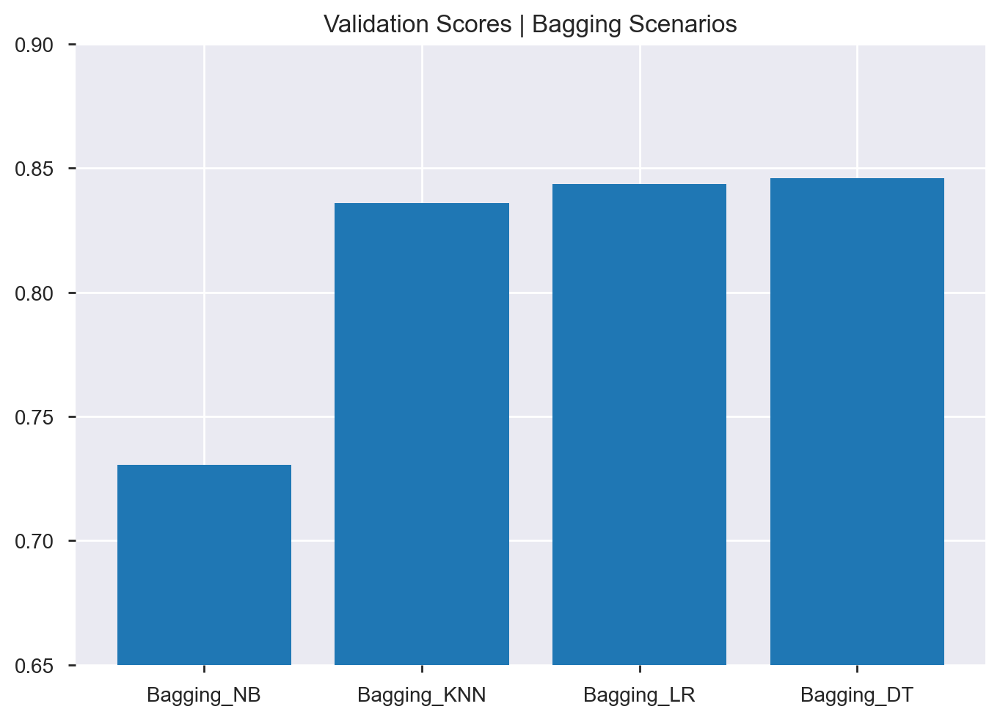

In [467]:
accuracies_BAG_val = [score_bagging_knn_val, score_bagging_lr_val, score_bagging_nb_val, score_bagging_dt_val]
models_BAG_val = ['Bagging_KNN', 'Bagging_LR', 'Bagging_NB', 'Bagging_DT']
data_tuples = list(zip(models_BAG_val ,accuracies_BAG_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Bagging Scenarios')
plt.ylim(0.65,0.90)
plt.show()

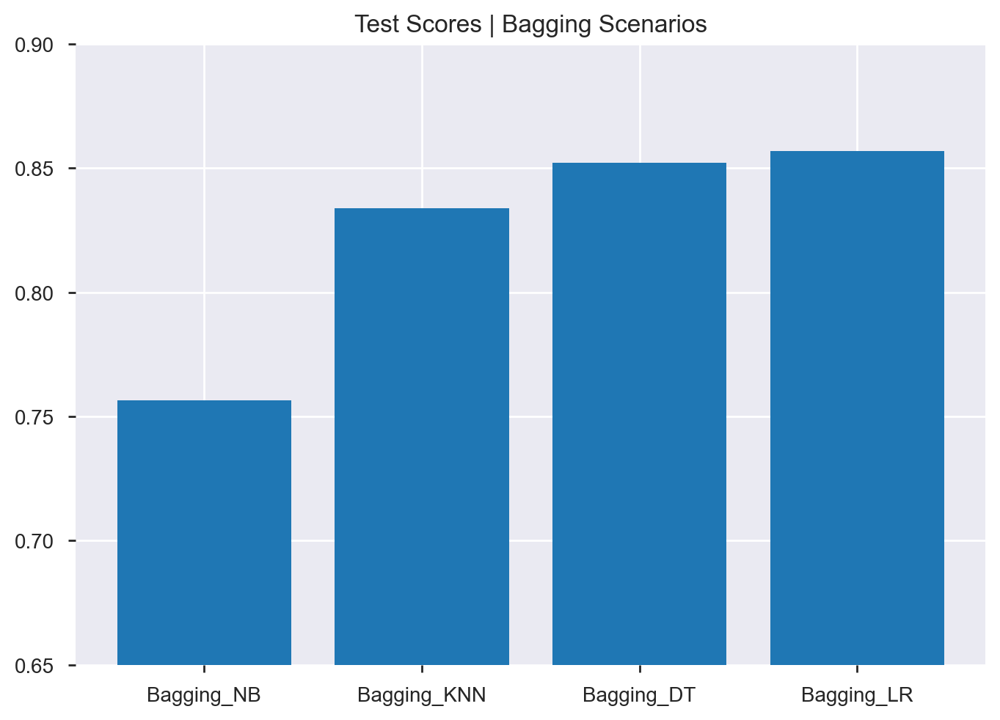

In [468]:
accuracies_BAG_test = [score_bagging_knn_test, score_bagging_lr_test, score_bagging_nb_test, score_bagging_dt_test]
models_BAG_test = ['Bagging_KNN', 'Bagging_LR', 'Bagging_NB', 'Bagging_DT']
data_tuples = list(zip(models_BAG_test ,accuracies_BAG_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Bagging Scenarios')
plt.ylim(0.65,0.90)
plt.show()

## Voting Classifier

### Hard Voting | Gradient Boosting Decision Tree, Decision Tree, Logistic Regression  | All Variables 

In [755]:
modelVCH1 = VotingClassifier(estimators= [('GBDT', modelGBDT), ('DT',modelDT3), 
                                           ('LogReg', modelLR5)], voting='hard')
modelVCH1.fit(X_train,y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


VotingClassifier(estimators=[('GBDT',
                              GradientBoostingClassifier(learning_rate=0.2,
                                                         max_depth=11,
                                                         max_features=42,
                                                         min_samples_split=0.5,
                                                         n_estimators=75,
                                                         random_state=40)),
                             ('DT',
                              DecisionTreeClassifier(max_depth=9,
                                                     min_samples_split=20)),
                             ('LogReg', LogisticRegression(C=10000))])

In [756]:
labels_train_vch1 = modelVCH1.predict(X_train)
labels_test_test_vch1 = modelVCH1.predict(X_test_test)

In [757]:
metric(y_train, labels_train_vch1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.95      0.92     10253
           1       0.80      0.60      0.69      3187

    accuracy                           0.87     13440
   macro avg       0.84      0.78      0.80     13440
weighted avg       0.86      0.87      0.86     13440

[[9764  489]
 [1269 1918]]


In [758]:
score_modelVCH1_val = modelVCH1.score(X_val, y_val)

In [759]:
cv_modelVCH1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelVCH1_val = cross_val_score(modelVCH1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelVCH1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelVCH1_val), std(n_scores_modelVCH1_val)))

Accuracy: 0.856 (0.015)


In [760]:
score_modelVCH1_test = modelVCH1.score(X_test, y_test)

In [761]:
cv_modelVCH1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelVCH1_test = cross_val_score(modelVCH1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelVCH1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelVCH1_test), std(n_scores_modelVCH1_test)))

Accuracy: 0.863 (0.012)


### Soft Voting | Gradient Boosting Decision Tree, Decision Tree, Logistic Regression  | All Variables 

In [762]:
modelVCS1 = VotingClassifier(estimators= [('GBDT', modelGBDT), ('DT',modelDT3), 
                                           ('LogReg', modelLR5)], voting='soft')
modelVCS1.fit(X_train,y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


VotingClassifier(estimators=[('GBDT',
                              GradientBoostingClassifier(learning_rate=0.2,
                                                         max_depth=11,
                                                         max_features=42,
                                                         min_samples_split=0.5,
                                                         n_estimators=75,
                                                         random_state=40)),
                             ('DT',
                              DecisionTreeClassifier(max_depth=9,
                                                     min_samples_split=20)),
                             ('LogReg', LogisticRegression(C=10000))],
                 voting='soft')

In [763]:
labels_train_vcs1 = modelVCS1.predict(X_train)
labels_test_test_vcs1 = modelVCS1.predict(X_test_test)

In [764]:
metric(y_train, labels_train_vcs1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.89      0.95      0.92     10253
           1       0.80      0.62      0.70      3187

    accuracy                           0.87     13440
   macro avg       0.84      0.79      0.81     13440
weighted avg       0.87      0.87      0.87     13440

[[9748  505]
 [1209 1978]]


In [765]:
score_modelVCS1_val = modelVCS1.score(X_val, y_val)

In [766]:
cv_modelVCS1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelVCS1_val = cross_val_score(modelVCS1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelVCS1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelVCS1_val), std(n_scores_modelVCS1_val)))

Accuracy: 0.853 (0.016)


In [767]:
score_modelVCS1_test = modelVCS1.score(X_test, y_test)

In [768]:
cv_modelVCS1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelVCS1_test = cross_val_score(modelVCS1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelVCS1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelVCS1_test), std(n_scores_modelVCS1_test)))

Accuracy: 0.863 (0.011)


### Hard Voting | Logistic Regression, Support Vector Machine and Decision Tree  | All Variables 

In [769]:
# Defining Estimator
estimator = [] 
estimator.append(('LR', modelLR5)) 
estimator.append(('SVC', modelSVM3)) 
estimator.append(('DTC', modelDT3)) 

In [770]:
# Voting Classifier w/ Hard Voting 
modelVCH = VotingClassifier(estimators = estimator, voting ='hard') 
modelVCH.fit(X_train, y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


VotingClassifier(estimators=[('LR', LogisticRegression(C=10000)),
                             ('SVC', SVC(kernel='linear', probability=True)),
                             ('DTC',
                              DecisionTreeClassifier(max_depth=9,
                                                     min_samples_split=20))])

In [771]:
labels_train_vch = modelVCH.predict(X_train)
labels_test_test_vch = modelVCH.predict(X_test_test)

In [772]:
# Predict accuracy for VC w/ Hard Voting 
score = accuracy_score(y_train, labels_train_vch) 
print('Hard Voting Score %.4f' % score)

Hard Voting Score 0.8554


In [773]:
metric(y_train, labels_train_vch)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.94      0.91     10253
           1       0.75      0.58      0.66      3187

    accuracy                           0.86     13440
   macro avg       0.82      0.76      0.78     13440
weighted avg       0.85      0.86      0.85     13440

[[9643  610]
 [1334 1853]]


In [774]:
score_modelVCH_val = modelVCH.score(X_val, y_val)

In [775]:
cv_voting_vch_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_voting_vch_val = cross_val_score(modelVCH, X_val, y_val, scoring='accuracy', 
                                   cv=cv_voting_vch_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_voting_vch_val), std(n_scores_voting_vch_val)))

Accuracy: 0.845 (0.014)


In [776]:
score_modelVCH_test = modelVCH.score(X_test, y_test)

In [777]:
cv_voting_vch_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_voting_vch_test = cross_val_score(modelVCH, X_test, y_test, scoring='accuracy', 
                                   cv=cv_voting_vch_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_voting_vch_test), std(n_scores_voting_vch_test)))

Accuracy: 0.855 (0.013)


### Soft Voting | Logistic Regression, Support Vector Machine and Decision Tree  | All Variables 

In [778]:
# Voting Classifier w/ Soft Voting 
modelVCS = VotingClassifier(estimators = estimator, voting ='soft') 
modelVCS.fit(X_train, y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


VotingClassifier(estimators=[('LR', LogisticRegression(C=10000)),
                             ('SVC', SVC(kernel='linear', probability=True)),
                             ('DTC',
                              DecisionTreeClassifier(max_depth=9,
                                                     min_samples_split=20))],
                 voting='soft')

In [779]:
labels_train_vcs = modelVCS.predict(X_train)
labels_test_test_vcs = modelVCS.predict(X_test_test)

In [780]:
# Predict accuracy for VC w/ Soft Voting 
score = accuracy_score(y_train, labels_train_vcs) 
print('Soft Voting Score %.4f' % score)

Soft Voting Score 0.8626


In [781]:
metric(y_train, labels_train_vcs)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.88      0.95      0.91     10253
           1       0.78      0.59      0.67      3187

    accuracy                           0.86     13440
   macro avg       0.83      0.77      0.79     13440
weighted avg       0.86      0.86      0.86     13440

[[9707  546]
 [1301 1886]]


In [782]:
score_modelVCS_val = modelVCS.score(X_val, y_val)

In [783]:
cv_voting_vcs_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_voting_vcs_val = cross_val_score(modelVCS, X_val, y_val, scoring='accuracy', 
                                   cv=cv_voting_vcs_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_voting_vcs_val), std(n_scores_voting_vcs_val)))

Accuracy: 0.848 (0.015)


In [784]:
score_modelVCS_test = modelVCS.score(X_test, y_test)

In [785]:
cv_voting_vcs_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_voting_vcs_test = cross_val_score(modelVCS, X_test, y_test, scoring='accuracy', 
                                   cv=cv_voting_vcs_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_voting_vcs_test), std(n_scores_voting_vcs_test)))

Accuracy: 0.859 (0.012)


### Hard Voting | Gradient Boosting Decision Tree, AdaBoost, Logistic Regression  | All Variables 

In [786]:
modelVCH3 = VotingClassifier(estimators= [('GBDT', modelGBDT), ('Ada',modelAB3), 
                                           ('LogReg', modelLR5)], voting='hard')
modelVCH3.fit(X_train,y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


VotingClassifier(estimators=[('GBDT',
                              GradientBoostingClassifier(learning_rate=0.2,
                                                         max_depth=11,
                                                         max_features=42,
                                                         min_samples_split=0.5,
                                                         n_estimators=75,
                                                         random_state=40)),
                             ('Ada',
                              AdaBoostClassifier(learning_rate=0.8,
                                                 n_estimators=350)),
                             ('LogReg', LogisticRegression(C=10000))])

In [787]:
labels_train_vch3 = modelVCH3.predict(X_train)
labels_test_test_vch3 = modelVCH3.predict(X_test_test)

In [788]:
metric(y_train, labels_train_vch3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.89      0.95      0.92     10253
           1       0.78      0.63      0.70      3187

    accuracy                           0.87     13440
   macro avg       0.84      0.79      0.81     13440
weighted avg       0.87      0.87      0.87     13440

[[9691  562]
 [1172 2015]]


In [789]:
score_modelVCH3_val = modelVCH3.score(X_val, y_val)

In [790]:
cv_modelVCH3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelVCH3_val = cross_val_score(modelVCH3, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelVCH3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelVCH3_val), std(n_scores_modelVCH3_val)))

Accuracy: 0.858 (0.013)


In [791]:
score_modelVCH3_test = modelVCH3.score(X_test, y_test)

In [792]:
cv_modelVCH3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelVCH3_test = cross_val_score(modelVCH3, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelVCH3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelVCH3_test), std(n_scores_modelVCH3_test)))

Accuracy: 0.868 (0.015)


### Voting Classifier |  Model Comparison

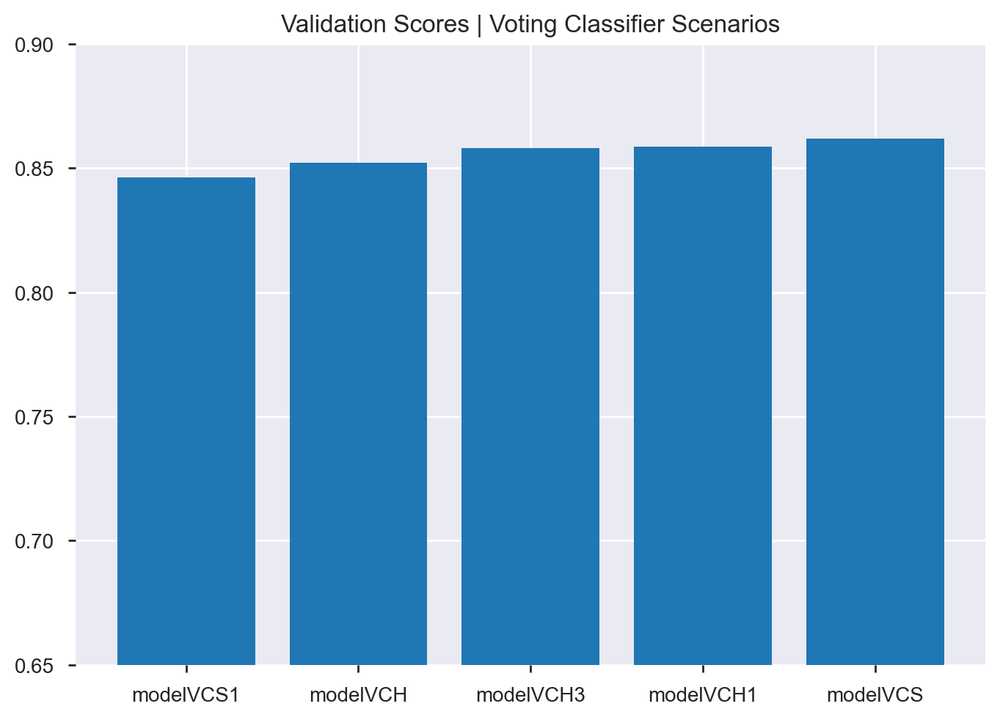

In [793]:
accuracies_VC_val = [score_modelVCH1_val, score_modelVCH_val, score_modelVCS_val, score_modelVCH3_val, score_modelVCS1_val]
models_VC_val = ['modelVCH1', 'modelVCS1', 'modelVCH', 'modelVCS','modelVCH3']
data_tuples = list(zip(models_VC_val ,accuracies_VC_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Voting Classifier Scenarios')
plt.ylim(0.65,0.90)
plt.show()

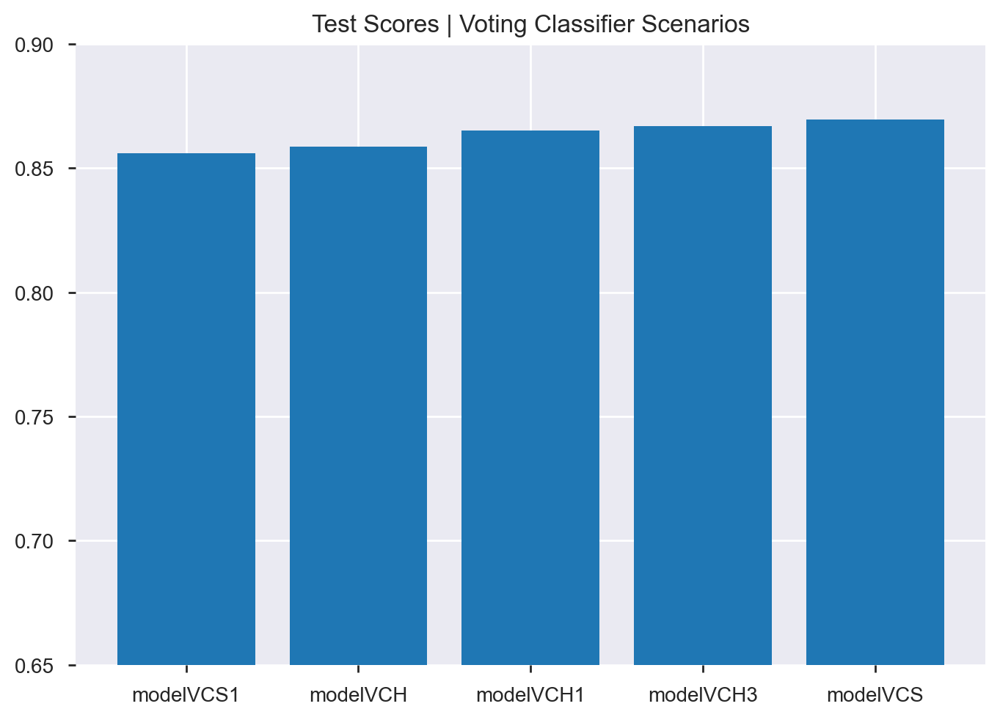

In [794]:
accuracies_VC_test = [score_modelVCH1_test, score_modelVCH_test, score_modelVCS_test, score_modelVCH3_test, score_modelVCS1_test]
models_VC_test = ['modelVCH1', 'modelVCS1', 'modelVCH', 'modelVCS','modelVCH3']
data_tuples = list(zip(models_VC_test ,accuracies_VC_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Voting Classifier Scenarios')
plt.ylim(0.65,0.90)
plt.show()

## Extra Tree Classifier

### Extra tree | All Variables 

In [509]:
exclf = ExtraTreesClassifier(n_estimators=100)
exclf.fit(X = X_train, y = y_train)

ExtraTreesClassifier()

In [510]:
prob_exclf = exclf.predict_proba(X_test)

In [511]:
labels_train_exclf = exclf.predict(X_train)
labels_test_exclf = exclf.predict(X_test)
labels_val_exclf = exclf.predict(X_val)

labels_test_test_exclf = exclf.predict(X_test_test)

In [512]:
metric_II(y_train, labels_train_exclf, y_val, labels_test_exclf, y_test, labels_val_exclf)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     10253
           1       0.99      0.94      0.96      3187

    accuracy                           0.98     13440
   macro avg       0.98      0.97      0.97     13440
weighted avg       0.98      0.98      0.98     13440

[[10216    37]
 [  205  2982]]
___________________________________________________________________________________________________________
                                                VALIDATION                                                 
------------------------------------------------------------------------------------------------------

In [513]:
score_exclf_clf_val = exclf.score(X_val, y_val)

In [514]:
cv_exclf_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_exclf_val = cross_val_score(exclf, X_val, y_val, scoring='accuracy', 
                                   cv=cv_exclf_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_exclf_val), std(n_scores_exclf_val)))

Accuracy: 0.815 (0.019)


In [515]:
score_exclf_test = exclf.score(X_test, y_test)

In [516]:
cv_exclf_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_exclf_test = cross_val_score(exclf, X_test, y_test, scoring='accuracy', 
                                   cv=cv_exclf_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_exclf_test), std(n_scores_exclf_test)))

Accuracy: 0.823 (0.016)


### Extra tree | Tunning Parameters

In [523]:
# Selecting the best parameters 

parameters = {'max_features':['sqrt', 'log2', 10,20],
              'max_depth':[5,10,20,50,None],
              'n_estimators':[10,100,200]}

clf_exclf = GridSearchCV(ExtraTreesClassifier(), parameters, n_jobs=-1, cv=10, scoring='accuracy')
clf_exclf.fit(X_train, y_train)

# Checking the hyperparameters tuned to have the highest precision
clf_exclf.best_params_

{'max_depth': 10, 'max_features': 20, 'n_estimators': 100}

In [524]:
exclf_tunned = ExtraTreesClassifier(max_depth= 10, max_features=20, n_estimators=200)
exclf_tunned.fit(X = X_train, y = y_train)

ExtraTreesClassifier(max_depth=10, max_features=20, n_estimators=200)

In [525]:
prob_exclf_tunned = exclf_tunned.predict_proba(X_test)

In [526]:
labels_train_exclf_tunned = exclf_tunned.predict(X_train)
labels_test_exclf_tunned = exclf_tunned.predict(X_test)
labels_val_exclf_tunned = exclf_tunned.predict(X_val)

labels_test_test_exclf_tunned = exclf_tunned.predict(X_test_test)

In [527]:
metric_II(y_train, labels_train_exclf_tunned, y_val, labels_test_exclf_tunned, y_test, labels_val_exclf_tunned)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.89      0.96      0.92     10253
           1       0.82      0.60      0.69      3187

    accuracy                           0.87     13440
   macro avg       0.85      0.78      0.81     13440
weighted avg       0.87      0.87      0.87     13440

[[9833  420]
 [1273 1914]]
___________________________________________________________________________________________________________
                                                VALIDATION                                                 
----------------------------------------------------------------------------------------------------------

In [534]:
score_exclf_tunned_val = exclf_tunned.score(X_val, y_val)

In [535]:
cv_exclf_tunned_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_exclf_tunned_val = cross_val_score(exclf_tunned, X_val, y_val, scoring='accuracy', 
                                   cv=cv_exclf_tunned_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_exclf_tunned_val), std(n_scores_exclf_tunned_val)))

Accuracy: 0.843 (0.016)


In [536]:
score_exclf_tunned_test = exclf_tunned.score(X_test, y_test)

In [537]:
cv_exclf_tunned_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_exclf_tunned_test = cross_val_score(exclf_tunned, X_test, y_test, scoring='accuracy', 
                                   cv=cv_exclf_tunned_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_exclf_tunned_test), std(n_scores_exclf_tunned_test)))

Accuracy: 0.850 (0.013)


### Extra Tree |  Model Comparison

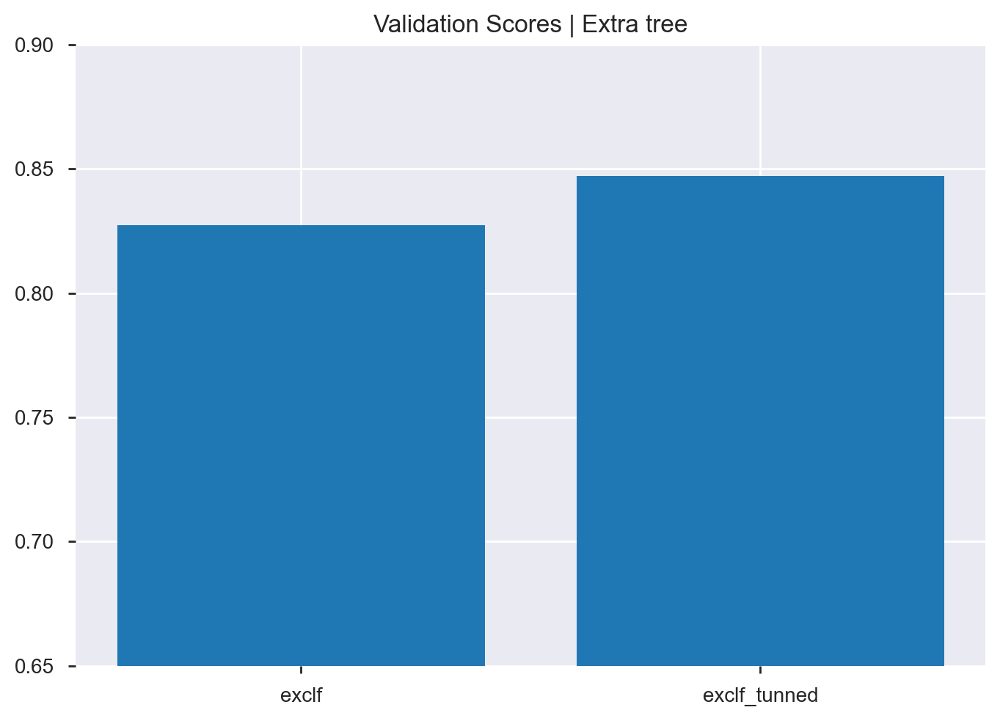

In [538]:
accuracies_exclf_val = [score_exclf_clf_val, score_exclf_tunned_val]
models_exclf_val = ['exclf', 'exclf_tunned']
data_tuples = list(zip(models_exclf_val ,accuracies_exclf_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Extra tree')
plt.ylim(0.65,0.90)
plt.show()

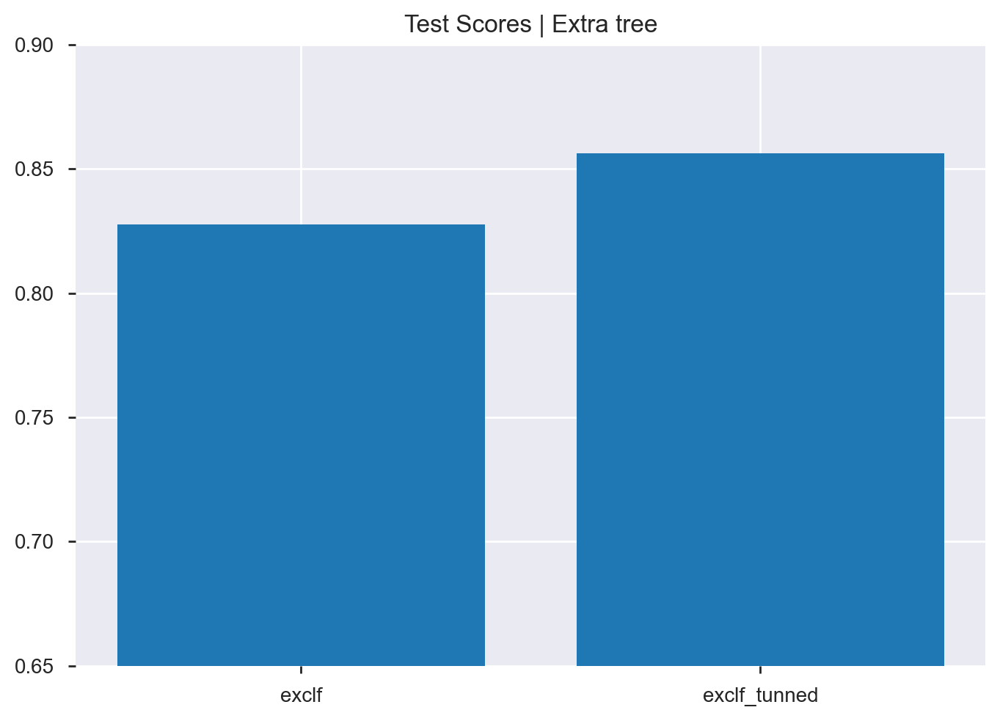

In [539]:
accuracies_exclf_test = [score_exclf_test, score_exclf_tunned_test]
models_exclf_test = ['exclf', 'exclf_tunned']
data_tuples = list(zip(models_exclf_test ,accuracies_exclf_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Extra tree')
plt.ylim(0.65,0.90)
plt.show()

## Histogram Gradient Boosting

### Histogram Gradient Boosting | All Variables 

In [540]:
modelHGB = HistGradientBoostingClassifier()
modelHGB.fit(X_train, y_train)

HistGradientBoostingClassifier()

In [541]:
prob_modelHGB = modelHGB.predict_proba(X_test)

In [542]:
labels_train_hgb = modelHGB.predict(X_train)
labels_val_hgb = modelHGB.predict(X_val)
labels_test_hgb = modelHGB.predict(X_test)

labels_test_test_hgb = modelHGB.predict(X_test_test)

In [543]:
metric_II(y_train, labels_train_hgb, y_val, labels_test_hgb, y_test, labels_val_hgb,)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.95      0.93     10253
           1       0.81      0.70      0.75      3187

    accuracy                           0.89     13440
   macro avg       0.86      0.83      0.84     13440
weighted avg       0.89      0.89      0.89     13440

[[9730  523]
 [ 947 2240]]
___________________________________________________________________________________________________________
                                                VALIDATION                                                 
----------------------------------------------------------------------------------------------------------

In [544]:
score_modelHGB_val = modelHGB.score(X_val, y_val)

In [545]:
cv_modelHGB_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelHGB_val = cross_val_score(modelHGB, X_val, y_val, scoring='accuracy', 
                                   cv=cv_modelHGB_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelHGB_val), std(n_scores_modelLR4_val)))

Accuracy: 0.850 (0.016)


In [546]:
score_modelHGB_test = modelHGB.score(X_test, y_test)

In [547]:
cv_modelHGB_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_modelHGB_test = cross_val_score(modelHGB, X_test, y_test, scoring='accuracy', 
                                   cv=cv_modelHGB_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_modelHGB_test), std(n_scores_modelHGB_test)))

Accuracy: 0.861 (0.015)


## Stacking

### Stacking - LDA, Neural Networks, Logistic Regression

In [817]:
estimators1 = [('nn', modelNN2),('lda', modelLDA1)]
sc1 = StackingClassifier(estimators=estimators1, final_estimator=modelLR5)
sc1.fit(X_train, y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multi

StackingClassifier(estimators=[('nn', MLPClassifier()),
                               ('lda', LinearDiscriminantAnalysis())],
                   final_estimator=LogisticRegression(C=10000))

In [549]:
labels_train_sc1 = sc1.predict(X_train)
labels_test_test_sc1 = sc1.predict(X_test_test)

In [550]:
prob_sc1 = sc1.predict_proba(X_test)

In [551]:
metric(y_train, labels_train_sc1)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.89      0.95      0.92     10253
           1       0.79      0.61      0.69      3187

    accuracy                           0.87     13440
   macro avg       0.84      0.78      0.80     13440
weighted avg       0.86      0.87      0.86     13440

[[9723  530]
 [1233 1954]]


In [552]:
score_sc1_val = sc1.score(X_val, y_val)

In [553]:
cv_sc1_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc1_val = cross_val_score(sc1, X_val, y_val, scoring='accuracy', 
                                   cv=cv_sc1_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc1_val), std(n_scores_sc1_val)))

Accuracy: 0.839 (0.015)


In [554]:
score_sc1_test = sc1.score(X_test, y_test)

In [555]:
cv_sc1_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc1_test = cross_val_score(sc1, X_test, y_test, scoring='accuracy', 
                                   cv=cv_sc1_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc1_test), std(n_scores_sc1_test)))

Accuracy: 0.847 (0.015)


In [556]:
#Trial with different stack_method

In [818]:
estimators2 = [('nn', modelNN2),('lda', modelLDA1)]
sc2 = StackingClassifier(estimators=estimators2, final_estimator=modelLR5,stack_method = 'predict')
sc2.fit(X_train, y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multi

StackingClassifier(estimators=[('nn', MLPClassifier()),
                               ('lda', LinearDiscriminantAnalysis())],
                   final_estimator=LogisticRegression(C=10000),
                   stack_method='predict')

In [558]:
prob_sc2 = sc2.predict_proba(X_test)

In [559]:
labels_train_sc2=sc2.predict(X_train)
labels_test_test_sc2 = sc2.predict(X_test_test)

In [560]:
metric(y_train, labels_train_sc2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.87      0.97      0.92     10253
           1       0.87      0.55      0.67      3187

    accuracy                           0.87     13440
   macro avg       0.87      0.76      0.80     13440
weighted avg       0.87      0.87      0.86     13440

[[9983  270]
 [1440 1747]]


In [561]:
score_sc2_val = sc2.score(X_val, y_val)

In [562]:
cv_sc2_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc2_val = cross_val_score(sc2, X_val, y_val, scoring='accuracy', 
                                   cv=cv_sc2_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc2_val), std(n_scores_sc2_val)))

Accuracy: 0.836 (0.016)


In [563]:
score_sc2_test = sc2.score(X_test, y_test)

In [564]:
cv_sc2_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc2_test = cross_val_score(sc2, X_test, y_test, scoring='accuracy', 
                                   cv=cv_sc2_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc2_test), std(n_scores_sc2_test)))

Accuracy: 0.842 (0.015)


### Stacking - LDA, Neural Networks, Gradient Boosting Decision Tree

In [565]:
estimators3 = [('nn', modelNN2),('lda', modelLDA1)]
sc3 = StackingClassifier(estimators=estimators3, final_estimator=modelGBDT)
sc3.fit(X_train, y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


StackingClassifier(estimators=[('nn',
                                MLPClassifier(hidden_layer_sizes=(100, 100,
                                                                  100),
                                              learning_rate='adaptive')),
                               ('lda', LinearDiscriminantAnalysis())],
                   final_estimator=GradientBoostingClassifier(learning_rate=0.23,
                                                              n_estimators=120))

In [819]:
prob_sc3 = sc3.predict_proba(X_test)

In [820]:
labels_train_sc3=sc3.predict(X_train)
labels_test_test_sc3 = sc3.predict(X_test_test)

In [821]:
metric(y_train, labels_train_sc3)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.90      0.94      0.92     10253
           1       0.79      0.65      0.71      3187

    accuracy                           0.88     13440
   macro avg       0.84      0.80      0.82     13440
weighted avg       0.87      0.88      0.87     13440

[[9688  565]
 [1101 2086]]


In [822]:
score_sc3_val = sc3.score(X_val, y_val)

In [823]:
cv_sc3_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc3_val = cross_val_score(sc3, X_val, y_val, scoring='accuracy', 
                                   cv=cv_sc3_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc3_val), std(n_scores_sc3_val)))

Accuracy: 0.824 (0.016)


In [824]:
score_sc3_test = sc3.score(X_test, y_test)

In [825]:
cv_sc3_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc3_test = cross_val_score(sc3, X_test, y_test, scoring='accuracy', 
                                   cv=cv_sc3_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc3_test), std(n_scores_sc3_test)))

Accuracy: 0.829 (0.015)


### Stacking - Gradient Boosting Decision Tree, Neural Networks, Logistic Regression

In [836]:
estimators4 = [('nn', modelNN2),('gb', modelGBDT)]
sc4 = StackingClassifier(estimators=estimators4, final_estimator=modelLR5)
sc4.fit(X_train, y_train)

C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:582: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\marta\anaconda3\lib\site-packages\sklearn\neural_network\_multi

StackingClassifier(estimators=[('nn', MLPClassifier()),
                               ('gb',
                                GradientBoostingClassifier(learning_rate=0.2,
                                                           max_depth=11,
                                                           max_features=42,
                                                           min_samples_split=0.5,
                                                           n_estimators=75,
                                                           random_state=40))],
                   final_estimator=LogisticRegression(C=10000))

In [837]:
prob_sc4 = sc4.predict_proba(X_test)

In [935]:
labels_train_sc4 = sc4.predict(X_train)
labels_test_sc4 = sc4.predict(X_test)
labels_test_test_sc4 = sc4.predict(X_test_test)

In [839]:
metric(y_train, labels_train_sc4)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.90      0.95      0.92     10253
           1       0.79      0.66      0.72      3187

    accuracy                           0.88     13440
   macro avg       0.85      0.80      0.82     13440
weighted avg       0.87      0.88      0.87     13440

[[9697  556]
 [1086 2101]]


In [854]:
score_sc4_val = sc4.score(X_val, y_val)

In [855]:
cv_sc4_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc4_val = cross_val_score(sc4, X_val, y_val, scoring='accuracy', 
                                   cv=cv_sc4_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc4_val), std(n_scores_sc4_val)))

Accuracy: 0.859 (0.014)


In [856]:
score_sc4_test = sc4.score(X_test, y_test)

In [857]:
cv_sc4_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc4_test = cross_val_score(sc4, X_test, y_test, scoring='accuracy', 
                                   cv=cv_sc4_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc4_test), std(n_scores_sc4_test)))

Accuracy: 0.869 (0.014)


In [936]:
print("Recall:",metrics.recall_score(y_test, labels_test_sc4))
print("Accuracy:",metrics.accuracy_score(y_test, labels_test_sc4))
print("ROC_AUC:",metrics.roc_auc_score(y_test, labels_test_sc4))
print("F1 score:",metrics.f1_score(y_test, labels_test_sc4))

Recall: 0.635593220338983
Accuracy: 0.8720982142857143
ROC_AUC: 0.7905877160793804
F1 score: 0.7020280811232449


### Stacking - Gradient Boosting Decision Tree, Random Forest, LDA

In [858]:
estimators5 = [('rf', modelRF3),('gbdt', modelGBDT)]
sc5 = StackingClassifier(estimators=estimators5, final_estimator=modelLDA1)
sc5.fit(X_train, y_train)

StackingClassifier(estimators=[('rf',
                                RandomForestClassifier(max_depth=20,
                                                       max_features=10,
                                                       n_estimators=200)),
                               ('gbdt',
                                GradientBoostingClassifier(learning_rate=0.2,
                                                           max_depth=11,
                                                           max_features=42,
                                                           min_samples_split=0.5,
                                                           n_estimators=75,
                                                           random_state=40))],
                   final_estimator=LinearDiscriminantAnalysis())

In [859]:
prob_sc5 = sc5.predict_proba(X_test)

In [860]:
labels_train_sc5=sc5.predict(X_train)
labels_test_sc5 = sc5.predict(X_test)
labels_test_test_sc5 = sc5.predict(X_test_test)

In [861]:
metric(y_train, labels_train_sc5)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.94      0.92     10253
           1       0.78      0.70      0.74      3187

    accuracy                           0.88     13440
   macro avg       0.85      0.82      0.83     13440
weighted avg       0.88      0.88      0.88     13440

[[9626  627]
 [ 955 2232]]


In [862]:
score_sc5_val = sc5.score(X_val, y_val)

In [863]:
cv_sc5_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc5_val = cross_val_score(sc5, X_val, y_val, scoring='accuracy', 
                                   cv=cv_sc5_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc5_val), std(n_scores_sc5_val)))

Accuracy: 0.857 (0.015)


In [864]:
score_sc5_test = sc5.score(X_test, y_test)

In [865]:
cv_sc5_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc5_test = cross_val_score(sc5, X_test, y_test, scoring='accuracy', 
                                   cv=cv_sc5_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc5_test), std(n_scores_sc5_test)))

Accuracy: 0.868 (0.014)


In [866]:
print("Recall:",metrics.recall_score(y_test, labels_test_sc5))
print("Accuracy:",metrics.accuracy_score(y_test, labels_test_sc5))
print("ROC_AUC:",metrics.roc_auc_score(y_test, labels_test_sc5))
print("F1 score:",metrics.f1_score(y_test, labels_test_sc5))

Recall: 0.6751412429378532
Accuracy: 0.875
ROC_AUC: 0.8061194804507873
F1 score: 0.7191574724172518


### Stacking - SVM, Gradient Boosting Decision Tree, LDA

In [867]:
estimators6 = [('svm', modelSVM3),('gb', modelGBDT)]
sc6 = StackingClassifier(estimators=estimators6, final_estimator=modelLDA1)
sc6.fit(X_train, y_train)

StackingClassifier(estimators=[('svm', SVC(kernel='linear', probability=True)),
                               ('gb',
                                GradientBoostingClassifier(learning_rate=0.2,
                                                           max_depth=11,
                                                           max_features=42,
                                                           min_samples_split=0.5,
                                                           n_estimators=75,
                                                           random_state=40))],
                   final_estimator=LinearDiscriminantAnalysis())

In [868]:
prob_sc6 = sc6.predict_proba(X_test)

In [869]:
labels_train_sc6=sc6.predict(X_train)
labels_test_sc6 = sc6.predict(X_test)
labels_test_test_sc6 = sc6.predict(X_test_test)

In [870]:
metric(y_train, labels_train_sc6)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.94      0.92     10253
           1       0.77      0.69      0.73      3187

    accuracy                           0.88     13440
   macro avg       0.84      0.81      0.82     13440
weighted avg       0.87      0.88      0.87     13440

[[9590  663]
 [ 991 2196]]


In [871]:
score_sc6_val = sc6.score(X_val, y_val)

In [872]:
cv_sc6_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc6_val = cross_val_score(sc6, X_val, y_val, scoring='accuracy', 
                                   cv=cv_sc6_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc6_val), std(n_scores_sc6_val)))

Accuracy: 0.858 (0.014)


In [873]:
score_sc6_test = sc6.score(X_test, y_test)

In [874]:
cv_sc6_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc6_test = cross_val_score(sc6, X_test, y_test, scoring='accuracy', 
                                   cv=cv_sc6_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc6_test), std(n_scores_sc6_test)))

Accuracy: 0.868 (0.014)


In [875]:
from sklearn.metrics import classification_report

print("Recall:",metrics.recall_score(y_test, labels_test_sc6))
print("Accuracy:",metrics.accuracy_score(y_test, labels_test_sc6))
print("ROC_AUC:",metrics.roc_auc_score(y_test, labels_test_sc6))
print("F1 score:",metrics.f1_score(y_test, labels_test_sc6))

Recall: 0.67984934086629
Accuracy: 0.8758928571428571
ROC_AUC: 0.8083272450381772
F1 score: 0.7219999999999999


### Stacking - Gradient Boosting Decision Tree, AdaBoost, Logistic Regression

In [876]:
estimators7 = [('ada', modelAB3),('gb', modelGBDT)]
sc7 = StackingClassifier(estimators=estimators7, final_estimator=modelLR5)
sc7.fit(X_train, y_train)

StackingClassifier(estimators=[('ada',
                                AdaBoostClassifier(learning_rate=0.8,
                                                   n_estimators=350)),
                               ('gb',
                                GradientBoostingClassifier(learning_rate=0.2,
                                                           max_depth=11,
                                                           max_features=42,
                                                           min_samples_split=0.5,
                                                           n_estimators=75,
                                                           random_state=40))],
                   final_estimator=LogisticRegression(C=10000))

In [877]:
prob_sc7 = sc7.predict_proba(X_test)

In [878]:
labels_train_sc7 = sc7.predict(X_train)
labels_test_sc7 = sc7.predict(X_test)
labels_test_test_sc7 = sc7.predict(X_test_test)

In [879]:
metric(y_train, labels_train_sc7)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.90      0.94      0.92     10253
           1       0.78      0.65      0.71      3187

    accuracy                           0.87     13440
   macro avg       0.84      0.80      0.82     13440
weighted avg       0.87      0.87      0.87     13440

[[9678  575]
 [1108 2079]]


In [880]:
score_sc7_val = sc7.score(X_val, y_val)

In [881]:
cv_sc7_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc7_val = cross_val_score(sc7, X_val, y_val, scoring='accuracy', 
                                   cv=cv_sc7_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc7_val), std(n_scores_sc7_val)))

Accuracy: 0.860 (0.013)


In [882]:
score_sc7_test = sc7.score(X_test, y_test)

In [883]:
cv_sc7_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc7_test = cross_val_score(sc7, X_test, y_test, scoring='accuracy', 
                                   cv=cv_sc7_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc7_test), std(n_scores_sc7_test)))

Accuracy: 0.870 (0.014)


In [884]:
print("Recall:",metrics.recall_score(y_test, labels_test_sc7))
print("Accuracy:",metrics.accuracy_score(y_test, labels_test_sc7))
print("ROC_AUC:",metrics.roc_auc_score(y_test, labels_test_sc7))
print("F1 score:",metrics.f1_score(y_test, labels_test_sc7))

Recall: 0.64030131826742
Accuracy: 0.8734375
ROC_AUC: 0.7930880494204274
F1 score: 0.7057602490918526


### Stacking - Gradient Boosting Decision Tree, AdaBoost, LDA

In [885]:
estimators8 = [('ada', modelAB3),('gb', modelGBDT)]
sc8 = StackingClassifier(estimators=estimators8, final_estimator=modelLDA1)
sc8.fit(X_train, y_train)

StackingClassifier(estimators=[('ada',
                                AdaBoostClassifier(learning_rate=0.8,
                                                   n_estimators=350)),
                               ('gb',
                                GradientBoostingClassifier(learning_rate=0.2,
                                                           max_depth=11,
                                                           max_features=42,
                                                           min_samples_split=0.5,
                                                           n_estimators=75,
                                                           random_state=40))],
                   final_estimator=LinearDiscriminantAnalysis())

In [886]:
prob_sc8 = sc8.predict_proba(X_test)

In [887]:
labels_train_sc8 = sc8.predict(X_train)
labels_test_sc8 = sc8.predict(X_test)
labels_test_test_sc8 = sc8.predict(X_test_test)

In [888]:
metric(y_train, labels_train_sc8)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.94      0.92     10253
           1       0.77      0.69      0.73      3187

    accuracy                           0.88     13440
   macro avg       0.84      0.81      0.82     13440
weighted avg       0.87      0.88      0.87     13440

[[9594  659]
 [ 998 2189]]


In [889]:
score_sc8_val = sc8.score(X_val, y_val)

In [890]:
cv_sc8_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc8_val = cross_val_score(sc8, X_val, y_val, scoring='accuracy', 
                                   cv=cv_sc8_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc8_val), std(n_scores_sc8_val)))

Accuracy: 0.858 (0.014)


In [891]:
score_sc8_test = sc8.score(X_test, y_test)

In [892]:
cv_sc8_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc8_test = cross_val_score(sc8, X_test, y_test, scoring='accuracy', 
                                   cv=cv_sc8_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc8_test), std(n_scores_sc8_test)))

Accuracy: 0.867 (0.014)


In [893]:
print("Recall:",metrics.recall_score(y_test, labels_test_sc8))
print("Accuracy:",metrics.accuracy_score(y_test, labels_test_sc8))
print("ROC_AUC:",metrics.roc_auc_score(y_test, labels_test_sc8))
print("F1 score:",metrics.f1_score(y_test, labels_test_sc8))

Recall: 0.6760828625235404
Accuracy: 0.8756696428571429
ROC_AUC: 0.8068828589972881
F1 score: 0.7205218263923733


### Stacking - Gradient Boosting Decison Tree & Logistic Regression

In [894]:
estimators9 = [('gbdt', modelGBDT)]
sc9 = StackingClassifier(estimators=estimators9, final_estimator=modelLR5)
sc9.fit(X_train, y_train)

StackingClassifier(estimators=[('gbdt',
                                GradientBoostingClassifier(learning_rate=0.2,
                                                           max_depth=11,
                                                           max_features=42,
                                                           min_samples_split=0.5,
                                                           n_estimators=75,
                                                           random_state=40))],
                   final_estimator=LogisticRegression(C=10000))

In [895]:
prob_sc9 = sc9.predict_proba(X_test)

In [896]:
labels_train_sc9=sc9.predict(X_train)
labels_test_sc9 = sc9.predict(X_test)
labels_test_test_sc9 = sc9.predict(X_test_test)

In [897]:
metric(y_train, labels_train_sc9)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.90      0.94      0.92     10253
           1       0.78      0.66      0.72      3187

    accuracy                           0.88     13440
   macro avg       0.84      0.80      0.82     13440
weighted avg       0.87      0.88      0.87     13440

[[9655  598]
 [1080 2107]]


In [898]:
score_sc9_val = sc9.score(X_val, y_val)

In [899]:
cv_sc9_val = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc9_val = cross_val_score(sc9, X_val, y_val, scoring='accuracy', 
                                   cv=cv_sc9_val , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc9_val), std(n_scores_sc9_val)))

Accuracy: 0.859 (0.014)


In [900]:
score_sc9_test = sc9.score(X_test, y_test)

In [901]:
cv_sc9_test = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=42)
n_scores_sc9_test = cross_val_score(sc9, X_test, y_test, scoring='accuracy', 
                                   cv=cv_sc9_test , n_jobs=-1, error_score='raise')

print('Accuracy: %.3f (%.3f)' % (mean(n_scores_sc9_test), std(n_scores_sc9_test)))

Accuracy: 0.870 (0.014)


In [902]:
print("Recall:",metrics.recall_score(y_test, labels_test_sc9))
print("Accuracy:",metrics.accuracy_score(y_test, labels_test_sc9))
print("ROC_AUC:",metrics.roc_auc_score(y_test, labels_test_sc9))
print("F1 score:",metrics.f1_score(y_test, labels_test_sc9))

Recall: 0.6497175141242938
Accuracy: 0.8729910714285715
ROC_AUC: 0.7960407348269216
F1 score: 0.7080554130323242


### Stacking |  Model Comparison

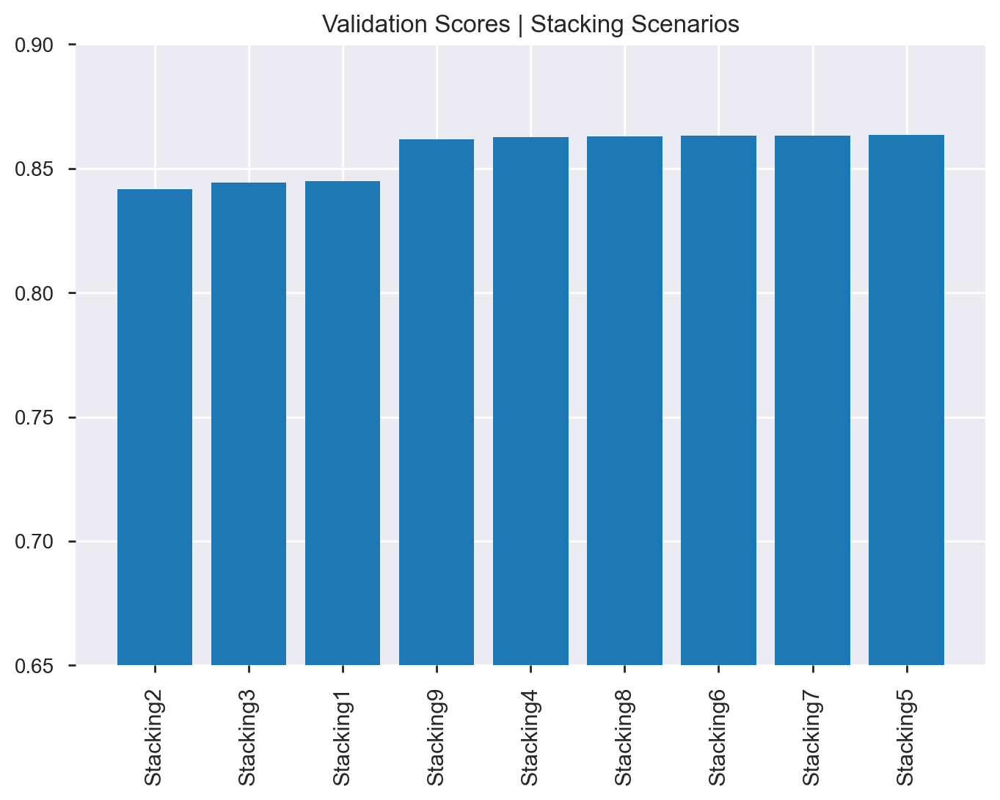

In [903]:
accuracies_STCK_val = [score_sc1_val, score_sc2_val, score_sc3_val, score_sc4_val, score_sc5_val, score_sc6_val, score_sc7_val, score_sc8_val,score_sc9_val ]
models_STCK_val = ['Stacking1', 'Stacking2', 'Stacking3', 'Stacking4', 'Stacking5', 'Stacking6', 'Stacking7', 'Stacking8','Stacking9' ]
data_tuples = list(zip(models_STCK_val ,accuracies_STCK_val))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Validation Scores | Stacking Scenarios')
plt.ylim(0.65,0.90)
plt.xticks(fontsize=11, rotation=90)

plt.show()

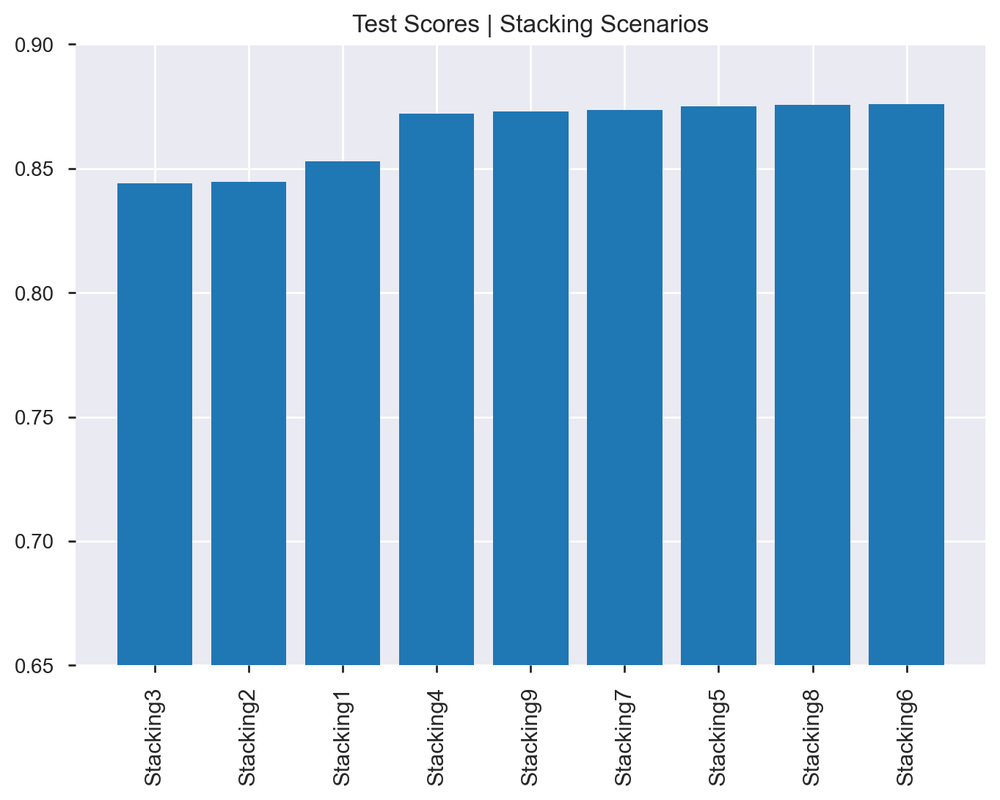

In [905]:
accuracies_STCK_test = [score_sc1_test, score_sc2_test, score_sc3_test, score_sc4_test, score_sc5_test, score_sc6_test, score_sc7_test, score_sc8_test,score_sc9_test ]
models_STCK_test = ['Stacking1', 'Stacking2', 'Stacking3', 'Stacking4', 'Stacking5', 'Stacking6', 'Stacking7', 'Stacking8', 'Stacking9']
data_tuples = list(zip(models_STCK_test ,accuracies_STCK_test))
data = pd.DataFrame(data_tuples)
data = data.sort_values(1)
plt.bar(data[0], data[1])
plt.title('Test Scores | Stacking Scenarios')
plt.ylim(0.65,0.90)
plt.xticks(fontsize=11, rotation=90)
plt.show()

## In depth analysis of best model - Gradient Boosting Decision Tree

### 1. Learning Rate

In [907]:
train_results = []
test_results = []

In [908]:
learning_rates = [1, 0.5, 0.4, 0.3, 0.2, 0.1, 0.05, 0.01] 

In [909]:
from sklearn.metrics import roc_curve, auc

for eta in learning_rates:
    model = GradientBoostingClassifier(learning_rate=eta)
    model.fit(X_train, y_train)
    
    train_pred = model.predict(X_train)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_train, train_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    train_results.append(roc_auc)
    
    y_pred = model.predict(X_test)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    test_results.append(roc_auc)

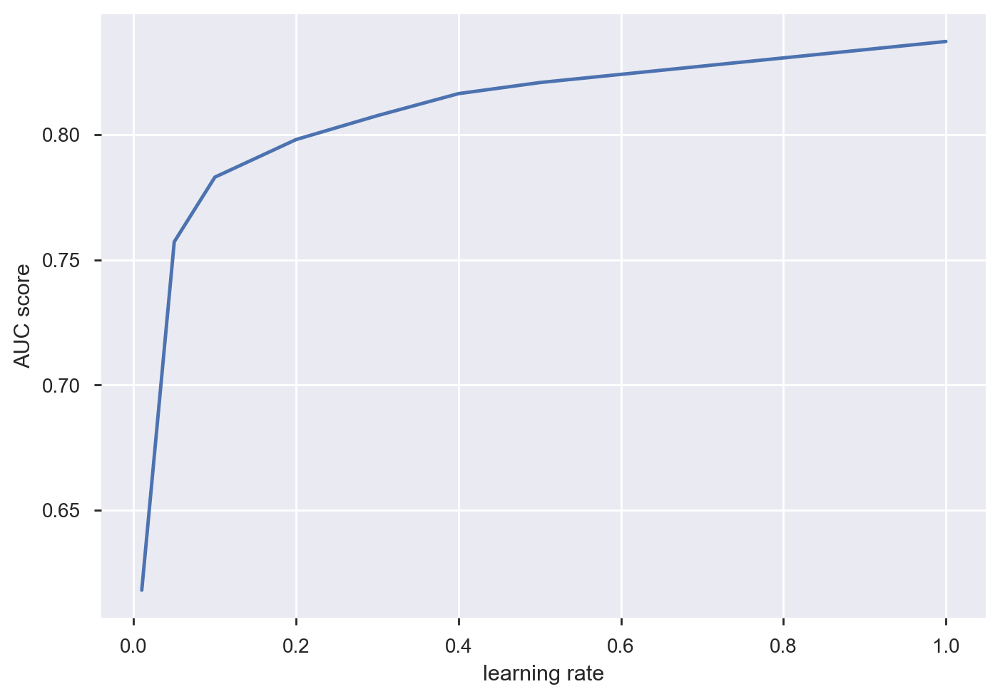

In [910]:
line1 = plt.plot(learning_rates, train_results,'b', label='Train AUC')
plt.ylabel('AUC score')
plt.xlabel('learning rate')
plt.show()

### 2. N_estimators

In [911]:
train_results = []
test_results = []

In [912]:
n_estimators = [1, 2, 4, 8, 10, 15, 30, 60, 75, 100, 200]

In [913]:
for estimator in n_estimators:
    model = GradientBoostingClassifier(n_estimators=estimator)
    model.fit(X_train, y_train)
    
    train_pred = model.predict(X_train)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_train, train_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    train_results.append(roc_auc)
    
    y_pred = model.predict(X_test)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    test_results.append(roc_auc)

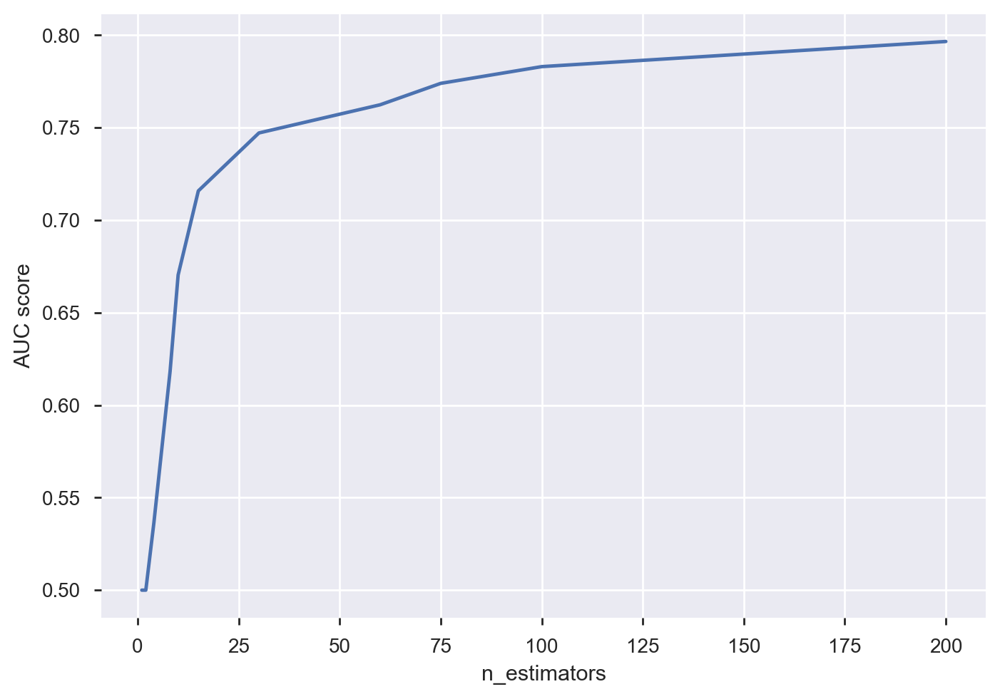

In [914]:
line1 = plt.plot(n_estimators, train_results,'b', label='Train AUC')
plt.ylabel('AUC score')
plt.xlabel('n_estimators')
plt.show()

### 3. max_depth

In [915]:
train_results = []
test_results = []

In [916]:
max_depths = np.linspace(1, 20, 20, endpoint=True)

In [917]:
max_depths

array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13.,
       14., 15., 16., 17., 18., 19., 20.])

In [918]:
for max_depth in max_depths:
    model = GradientBoostingClassifier(max_depth=max_depth)
    model.fit(X_train, y_train)
    
    train_pred = model.predict(X_train)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_train, train_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    train_results.append(roc_auc)
    
    y_pred = model.predict(X_test)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    test_results.append(roc_auc)

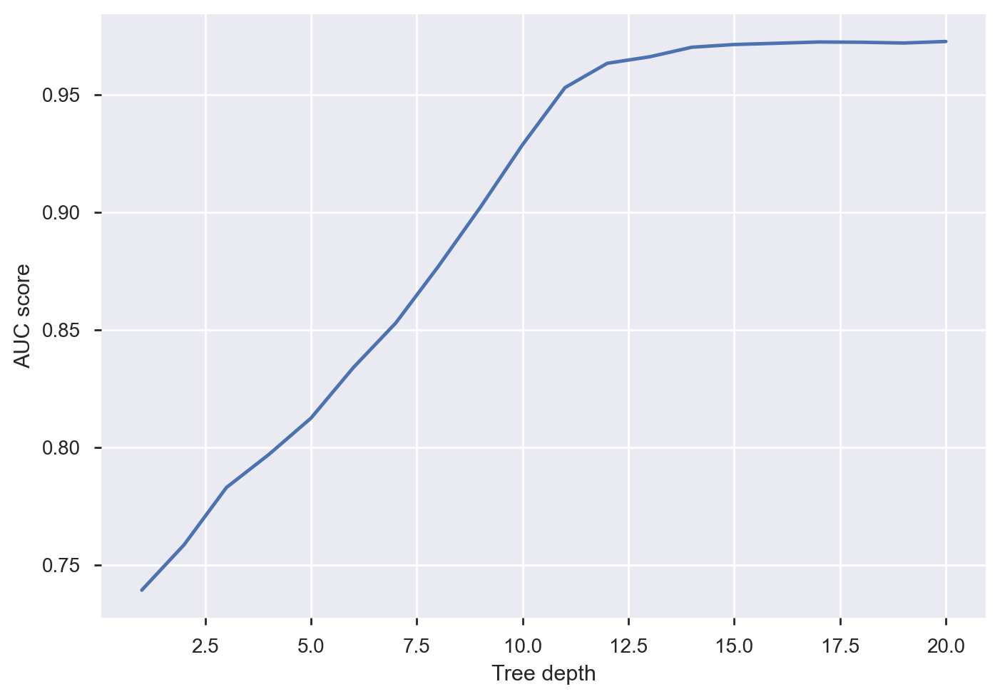

In [919]:
line1 = plt.plot(max_depths, train_results,'b', label='Train AUC')
plt.ylabel('AUC score')
plt.xlabel('Tree depth')
plt.show()

### 4. min_samples_split

In [920]:
train_results = []
test_results = []

In [921]:
min_samples_splits = np.linspace(0.1, 1.0, 10, endpoint=True)

In [922]:
min_samples_splits

array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ])

In [923]:
for min_samples_split in min_samples_splits:
    model = GradientBoostingClassifier(min_samples_split=min_samples_split)
    model.fit(X_train, y_train)
    
    train_pred = model.predict(X_train)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_train, train_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    train_results.append(roc_auc)
    
    y_pred = model.predict(X_test)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    test_results.append(roc_auc)

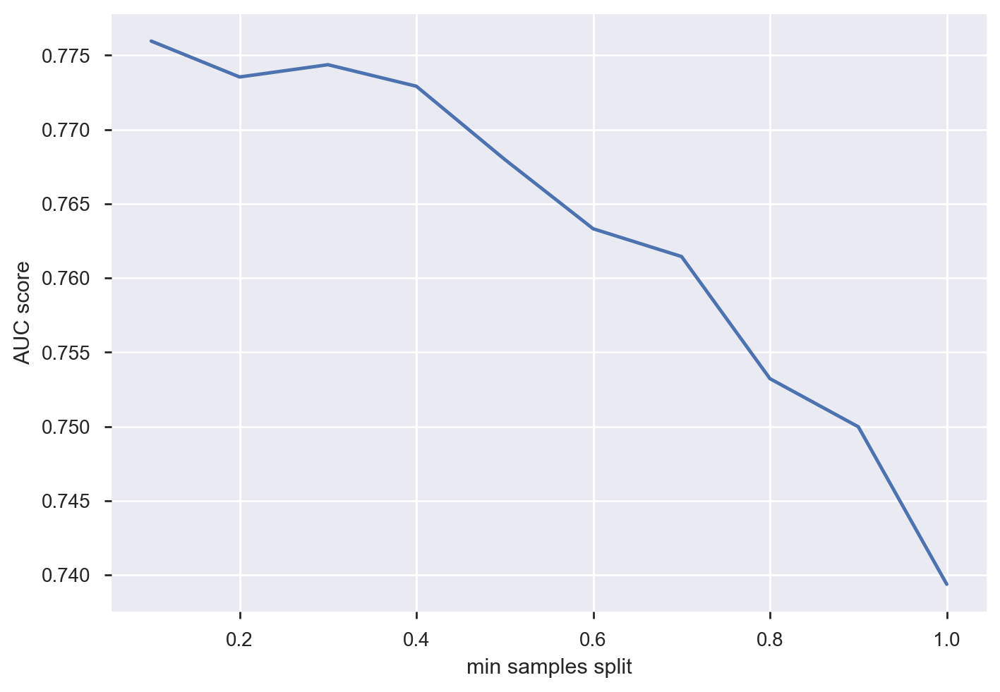

In [924]:
line1 = plt.plot(min_samples_splits, train_results,'b', label='Train AUC')
plt.ylabel('AUC score')
plt.xlabel('min samples split')
plt.show()

### 5. min_samples_leaf

In [925]:
train_results = []
test_results = []

In [926]:
min_samples_leafs = np.linspace(0.1, 0.5, 5, endpoint=True)

In [927]:
min_samples_leafs

array([0.1, 0.2, 0.3, 0.4, 0.5])

In [928]:
for min_samples_leaf in min_samples_leafs:
    model = GradientBoostingClassifier(min_samples_leaf=min_samples_leaf)
    model.fit(X_train, y_train)
    
    train_pred = model.predict(X_train)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_train, train_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    train_results.append(roc_auc)
    
    y_pred = model.predict(X_test)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    test_results.append(roc_auc)

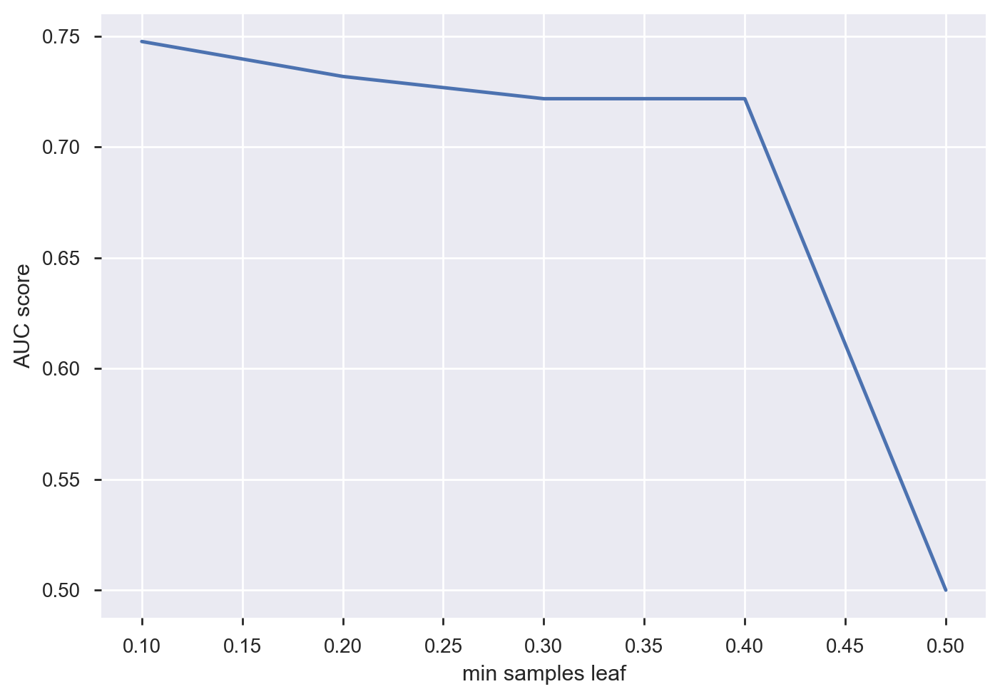

In [929]:
line1 = plt.plot(min_samples_leafs, train_results,'b', label='Train AUC')
plt.ylabel('AUC score')
plt.xlabel('min samples leaf')
plt.show()

### 6. max_features

In [930]:
train_results = []
test_results = []

In [931]:
max_features = list(range(1,X_train.shape[1]))

In [932]:
for max_feature in max_features:
    model = GradientBoostingClassifier(max_features=max_feature)
    model.fit(X_train, y_train)
    
    train_pred = model.predict(X_train)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_train, train_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    train_results.append(roc_auc)
    
    y_pred = model.predict(X_test)
    
    false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
    roc_auc = auc(false_positive_rate, true_positive_rate)
    test_results.append(roc_auc)

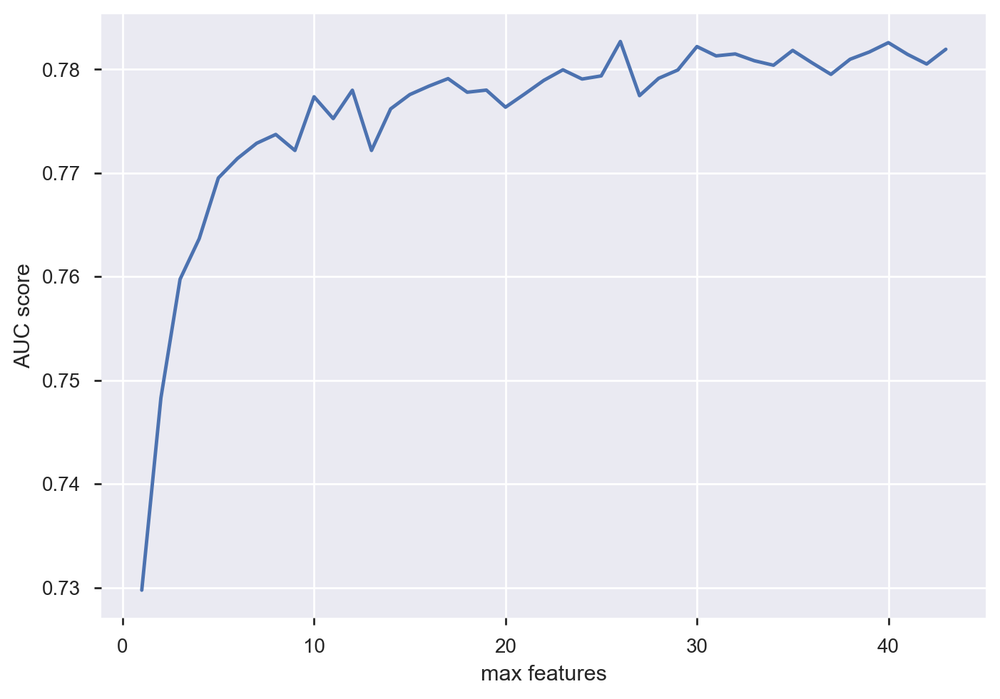

In [933]:
line1 = plt.plot(max_features, train_results,'b', label='Train AUC')
plt.ylabel('AUC score')
plt.xlabel('max features')
plt.show()

# Generate CSV - Kaggle

In [940]:
#y_pred = labels_test_test_lr5    #Linear Regression
#y_pred = labels_test_test_nb4    #Naive Bayes
#y_pred = labels_test_test_lda1   #Linear Discriminant Analysis
#y_pred = labels_test_test_nn3    #Neural Network
#y_pred = labels_test_test_dt2    #Decision Trees
#y_pred = labels_test_test_rf3    #Random Forest
#y_pred = labels_test_test_knn4   #KNN
#y_pred = labels_test_test_gb3    #Gradient Boosting
#y_pred = labels_test_test_gbdt   #Gradient Boosting Decision Tree
#y_pred = labels_test_test_ab3    #AdaBoost
#y_pred = labels_test_test_svm3   #Support Vector Machine
#y_pred = labels_test_bagging_lr  #Bagging Logistic Regression
#y_pred = labels_test_test_sc4    #stacking 4
#y_pred = labels_test_test_sc7    #stacking 7
#y_pred = labels_test_test_sc5    #stacking 5
#y_pred = labels_test_test_sc6    #stacking 6
y_pred=labels_test_test_sc9
#y_pred = labels_test_test_vcs    #Voting Classifier w/ Soft Voting
#y_pred = labels_test_test_vch    #Voting Classifier w/ Hard Voting
#y_pred = labels_test_test_vch3   #Voting Classifier w/ Hard Voting
#y_pred = labels_test_test_scX


a = pd.DataFrame(y_pred, index=X_test_test.index )

a.columns = ['Income']

a.to_csv(r'predictions_stacking9.csv')